key findings from gaoyun paper: https://egusphere.copernicus.org/preprints/2023/egusphere-2023-1897/egusphere-2023-1897.pdf

- under dry soil, anamolously high LT humidity is necessary to produce buyoancy profiles required for afternoon precipitation events 

-  under wet soil, boundary layer moisture alone could be sufficient to generate the required buoyancy profiles

april 12

next steps:

- instead of diurnal q plot for dry vs. wet, try plotting difference between dry coupling apes and dry coupling non ape cases (& same for wet) (as in fig. 2 gaoyun's paper)

- do same plot but averaged over surface layer


to look into further: 

- using integral instead of average for moisture budget

- add cos weighting

- are 1000-800 and 800-600 the appropriate layers to use? 

- domain --> is this the optimal choice?

- standard error --> when to use? am i using correctly?

- make sure APEs data is right

- should i expect to see when BLT increases, the mfc in the LT layer increases as well?


questions:

- why can we assume incompressible in moisture budget equation? 

- where did dq/dt go in yizhou moisture budget, and also mine?

- why use water density at the surface in moisture budget equation?

- do i need to use a dlnp when integrating vertically?

- cos(lat) weighting done correctly for qv? how do i incorporate into qw? 

- if i need to integrate from surface to top, then would by dp be positive? ie which direction should arrays be when feeding to trapz. what im thinking is: integral from surface to 0 is equal to integral from 0 to surface with a negative added in final result  

- how to express coming out of top and bottom as an integral

- in efran paper, the difference between taking the mean and calculating the anamoly terms? what does it mean if i'm just using the provided u,v,q values? 

- should g be negative???

- size of box: sides much shorter than top & bottom of box, how to account for this difference when comparing contributions from zonal, meridional and vertical flux? 


In [3]:
import pandas as pd
import glob
import os
import re
from datetime import datetime, timedelta
from haversine import haversine, Unit
import metpy
import metpy.constants as mpconst
import metpy.units as units
from scipy.interpolate import interp1d
from scipy.optimize import bisect
import numpy as np
import pickle
import numpy as np
import math
import pint
import xarray as xr
import netCDF4 as nc
import re
import matplotlib.pyplot as plt
from numpy import load
from numpy import asarray
from numpy import save
import pytz
from scipy import stats
from sklearn.linear_model import LinearRegression
from collections import Counter
import pymannkendall as mk
from pydoc import help
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

In [4]:
#soundings is a join between 1&4 and 2&3
#2&3 is a join between ctp_hi_low, fwi & (g)pdf dfs + where dry & wet coupling are defined
#ctp_hi_low is from 1&4, with ctp hi low calcs attached
#result of 2&3 and 1&4 are very close to gaoyuns, meaning 5&6 should be relatively accurate as well 

with open('soundings_fig5&6.pdkl', 'rb') as file:
    
    soundings = pickle.load(file)

In [5]:
path = "../../data/rong3/annie"

_13_cent = os.path.join(path, 'ERA5-sgp-mfc-2001-2003_domain_centered.nc')

_13 = os.path.join(path, 'ERA5-sgp-mfc-2001-2003.nc')

_46 = os.path.join(path, 'ERA5-sgp-mfc-2004-2006.nc')

_79 = os.path.join(path, 'ERA5-sgp-mfc-2007-2009.nc')

_1012 = os.path.join(path, 'ERA5-sgp-mfc-2010-2012.nc')

_1315 = os.path.join(path, 'ERA5-sgp-mfc-2013-2015.nc')

_1618 = os.path.join(path, 'ERA5-sgp-mfc-2016-2018.nc')

era13 = xr.open_dataset(_13)

era13_cent = xr.open_dataset(_13_cent)

era46 = xr.open_dataset(_46)

era79 = xr.open_dataset(_79)

era1012 = xr.open_dataset(_1012)

era1315 = xr.open_dataset(_1315)

era1618 = xr.open_dataset(_1618)

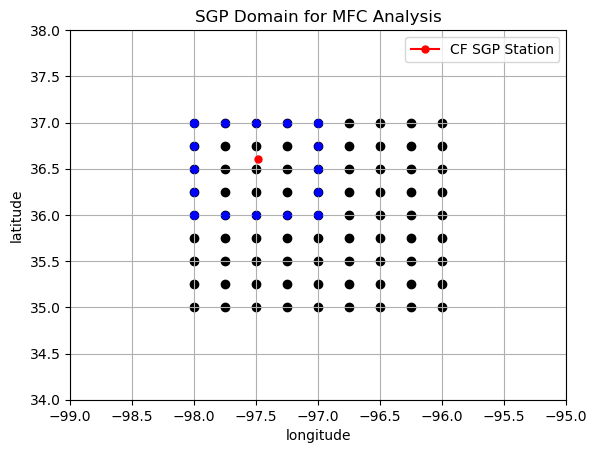

In [65]:
sgp = (36.607322, -97.487643)

lat_lon_pairs = []

lat = era13['latitude'].data

lon = era13['longitude'].data

for i in range(0,5):

    plt.plot(lon[i],lat[0], color='blue', marker='o', markersize=5)
    
    plt.plot(lon[4], lat[i], color='blue', marker='o', markersize=5)
    
    plt.plot(lon[0], lat[i], color='blue', marker='o', markersize=5)
    
    plt.plot(lon[i], lat[4], color='blue', marker='o', markersize=5)

for i in lat:
    
    for j in lon:
        
        p = (i, j)
        
        lat_lon_pairs.append(p)
        
x, y = zip(*lat_lon_pairs)

plt.plot(sgp[1], sgp[0], color='red', label='CF SGP Station', marker='o', markersize=5)

plt.scatter(y, x, color='black')

plt.xlim(-99,-95)

plt.ylim(34,38)

plt.grid()

plt.xlabel("longitude")

plt.legend()

plt.ylabel("latitude")

plt.title("SGP Domain for MFC Analysis")

plt.show()

## MFC Calculation

- averaged uq profiles on eastern & western domain full box

- and add weight of cos(lat) for vq grid points

In [19]:
#describes horizontal moisture divergence, and the net vertical boundary flux of moisture

def calculate_mean_flux(df, var, side, time, layer):
    
    levels = df['level'].data
    
    lat_range = df['latitude'].data[0:5]
    
    lon_range = df['longitude'].data[0:5]
    
    if side == 'west': 
        
        side_idx = 0
        
    elif side == 'east':
        
        side_idx = 4
        
    elif side == 'north':
        
        side_idx = 0
        
    elif side == 'south':
        
        side_idx = 4
    
    if layer == 'surface':
        
        bottom = 1000
    
        top = 800
    
    elif layer == 'lower_trop':
        
        bottom = 800
        
        top = 600
    
    idx_bottom = np.where(levels==bottom)[0][0]

    idx_top = np.where(levels==top)[0][0]

    if var == 'u':
        
        all_qus = []
        
        for lat in range(lat_range.shape[0]):
            
            for lev in range(idx_top,idx_bottom+1):
                
                qu = df['q'].data[time][lev][lat][side_idx] * df['u'].data[time][lev][lat][side_idx]
            
                all_qus.append(qu)
        
        mean_of_side = np.mean(all_qus)
                
    elif var == 'v':
        
        all_qvs = []
        
        for lon in range(lon_range.shape[0]):
            
            for lev in range(idx_top,idx_bottom+1):
                
                qv = df['q'].data[time][lev][side_idx][lon] * df['v'].data[time][lev][side_idx][lon]
                
                all_qvs.append(qv)
                
        mean_of_side = np.mean(all_qvs)
        
    else:
        
        all_qws = []
        
        for lon in range(lon_range.shape[0]):
            
            for lat in range(lat_range.shape[0]):
                
                qw = df['q'].data[time][side][lat][lon] * df['w'].data[time][side][lat][lon]
                
                all_qws.append(qw)
                
        mean_of_side = np.mean(all_qws)    
    
    return(mean_of_side)

def calculate_convergence(df, var, time, layer):
    
    levels = df['level'].data
    
    if layer == 'surface':
        
        bottom = 1000
    
        top = 800
    
    elif layer == 'lower_trop':
        
        bottom = 800
        
        top = 600
    
    idx_bottom = np.where(levels==bottom)[0][0]

    idx_top = np.where(levels==top)[0][0]
    
    to_mm_day = 1000*24*60*60
    
    g = 9.80665
    
    rho = 1030

    lat_range = df['latitude'].data[0:5]
    
    lon_range = df['longitude'].data[0:5]
    
    dp = (df['level'].data[idx_bottom]-df['level'].data[idx_top])*100

    dy = haversine((lat_range[0], np.mean(lon_range)), (lat_range[-1], np.mean(lon_range)), unit='m')
    
    dx = haversine((np.mean(lat_range), lon_range[0]), (np.mean(lat_range), lon_range[-1]), unit='m')
    
    if var == 'u':

        qu_west = calculate_mean_flux(df, 'u', 'west', time, layer)

        qu_east = calculate_mean_flux(df, 'u', 'east', time, layer)
        
        total_flux = (qu_west - qu_east)*(1/g)*(1/rho)*dy*dp*(1/(dx*dy))


    
    elif var == 'v':
        
        qv_north = calculate_mean_flux(df, 'v', 'north', time, layer)
        
        qv_south = calculate_mean_flux(df,'v', 'south', time, layer)
        
        total_flux = (qv_south - qv_north)*(1/g)*(1/rho)*dx*dp*(1/(dx*dy))


        
    else:
        
        qw_bottom = -calculate_mean_flux(df, 'w', idx_bottom, time, layer)

        qw_top = -calculate_mean_flux(df, 'w', idx_top, time, layer)
        
        total_flux = (qw_bottom - qw_top)*(1/g)*(1/rho)*dx*dy*(1/(dx*dy))

        

#to_mm_day

#or *1000*(1/(100**2)) for g/(cm^2*s)

    return(total_flux*to_mm_day)

convergence = []

all_dfs = [era13, era46, era79, era1012, era1315, era1618]

for ds in all_dfs:

    for t in range(ds['time'].data.shape[0]):

        lst = pd.to_datetime(ds['time'].data[t]) - timedelta(hours=6)
        
        if 5 <= lst.month <= 9:

            ws_surf = calculate_convergence(ds,'w',t,'surface')

            us_surf = calculate_convergence(ds,'u',t,'surface')

            vs_surf = calculate_convergence(ds,'v',t,'surface')
            
            ws_lt = calculate_convergence(ds,'w',t,'lower_trop')

            us_lt = calculate_convergence(ds,'u',t,'lower_trop')

            vs_lt = calculate_convergence(ds,'v',t,'lower_trop')

            all_divs = (lst, ws_lt, us_lt, vs_lt, ws_surf, us_surf, vs_surf)
            
            print(lst)

            convergence.append(all_divs)
            
#(Timestamp('2001-05-01 00:00:00'), 14.470298083799914, -33.390445624176905, 6.083541939341044, -10.024881660528456, 1.3753708348078482, 11.959065272890548)




2001-05-01 00:00:00
2001-05-01 03:00:00
2001-05-01 06:00:00
2001-05-01 09:00:00
2001-05-01 12:00:00
2001-05-01 15:00:00
2001-05-01 18:00:00
2001-05-01 21:00:00
2001-05-02 00:00:00
2001-05-02 03:00:00
2001-05-02 06:00:00
2001-05-02 09:00:00
2001-05-02 12:00:00
2001-05-02 15:00:00
2001-05-02 18:00:00
2001-05-02 21:00:00
2001-05-03 00:00:00
2001-05-03 03:00:00
2001-05-03 06:00:00
2001-05-03 09:00:00
2001-05-03 12:00:00
2001-05-03 15:00:00
2001-05-03 18:00:00
2001-05-03 21:00:00
2001-05-04 00:00:00
2001-05-04 03:00:00
2001-05-04 06:00:00
2001-05-04 09:00:00
2001-05-04 12:00:00
2001-05-04 15:00:00
2001-05-04 18:00:00
2001-05-04 21:00:00
2001-05-05 00:00:00
2001-05-05 03:00:00
2001-05-05 06:00:00
2001-05-05 09:00:00
2001-05-05 12:00:00
2001-05-05 15:00:00
2001-05-05 18:00:00
2001-05-05 21:00:00
2001-05-06 00:00:00
2001-05-06 03:00:00
2001-05-06 06:00:00
2001-05-06 09:00:00
2001-05-06 12:00:00
2001-05-06 15:00:00
2001-05-06 18:00:00
2001-05-06 21:00:00
2001-05-07 00:00:00
2001-05-07 03:00:00


2001-06-25 09:00:00
2001-06-25 12:00:00
2001-06-25 15:00:00
2001-06-25 18:00:00
2001-06-25 21:00:00
2001-06-26 00:00:00
2001-06-26 03:00:00
2001-06-26 06:00:00
2001-06-26 09:00:00
2001-06-26 12:00:00
2001-06-26 15:00:00
2001-06-26 18:00:00
2001-06-26 21:00:00
2001-06-27 00:00:00
2001-06-27 03:00:00
2001-06-27 06:00:00
2001-06-27 09:00:00
2001-06-27 12:00:00
2001-06-27 15:00:00
2001-06-27 18:00:00
2001-06-27 21:00:00
2001-06-28 00:00:00
2001-06-28 03:00:00
2001-06-28 06:00:00
2001-06-28 09:00:00
2001-06-28 12:00:00
2001-06-28 15:00:00
2001-06-28 18:00:00
2001-06-28 21:00:00
2001-06-29 00:00:00
2001-06-29 03:00:00
2001-06-29 06:00:00
2001-06-29 09:00:00
2001-06-29 12:00:00
2001-06-29 15:00:00
2001-06-29 18:00:00
2001-06-29 21:00:00
2001-06-30 00:00:00
2001-06-30 03:00:00
2001-06-30 06:00:00
2001-06-30 09:00:00
2001-06-30 12:00:00
2001-06-30 15:00:00
2001-06-30 18:00:00
2001-06-30 21:00:00
2001-07-01 00:00:00
2001-07-01 03:00:00
2001-07-01 06:00:00
2001-07-01 09:00:00
2001-07-01 12:00:00


2001-08-22 18:00:00
2001-08-22 21:00:00
2001-08-23 00:00:00
2001-08-23 03:00:00
2001-08-23 06:00:00
2001-08-23 09:00:00
2001-08-23 12:00:00
2001-08-23 15:00:00
2001-08-23 18:00:00
2001-08-23 21:00:00
2001-08-24 00:00:00
2001-08-24 03:00:00
2001-08-24 06:00:00
2001-08-24 09:00:00
2001-08-24 12:00:00
2001-08-24 15:00:00
2001-08-24 18:00:00
2001-08-24 21:00:00
2001-08-25 00:00:00
2001-08-25 03:00:00
2001-08-25 06:00:00
2001-08-25 09:00:00
2001-08-25 12:00:00
2001-08-25 15:00:00
2001-08-25 18:00:00
2001-08-25 21:00:00
2001-08-26 00:00:00
2001-08-26 03:00:00
2001-08-26 06:00:00
2001-08-26 09:00:00
2001-08-26 12:00:00
2001-08-26 15:00:00
2001-08-26 18:00:00
2001-08-26 21:00:00
2001-08-27 00:00:00
2001-08-27 03:00:00
2001-08-27 06:00:00
2001-08-27 09:00:00
2001-08-27 12:00:00
2001-08-27 15:00:00
2001-08-27 18:00:00
2001-08-27 21:00:00
2001-08-28 00:00:00
2001-08-28 03:00:00
2001-08-28 06:00:00
2001-08-28 09:00:00
2001-08-28 12:00:00
2001-08-28 15:00:00
2001-08-28 18:00:00
2001-08-28 21:00:00


2002-05-16 00:00:00
2002-05-16 03:00:00
2002-05-16 06:00:00
2002-05-16 09:00:00
2002-05-16 12:00:00
2002-05-16 15:00:00
2002-05-16 18:00:00
2002-05-16 21:00:00
2002-05-17 00:00:00
2002-05-17 03:00:00
2002-05-17 06:00:00
2002-05-17 09:00:00
2002-05-17 12:00:00
2002-05-17 15:00:00
2002-05-17 18:00:00
2002-05-17 21:00:00
2002-05-18 00:00:00
2002-05-18 03:00:00
2002-05-18 06:00:00
2002-05-18 09:00:00
2002-05-18 12:00:00
2002-05-18 15:00:00
2002-05-18 18:00:00
2002-05-18 21:00:00
2002-05-19 00:00:00
2002-05-19 03:00:00
2002-05-19 06:00:00
2002-05-19 09:00:00
2002-05-19 12:00:00
2002-05-19 15:00:00
2002-05-19 18:00:00
2002-05-19 21:00:00
2002-05-20 00:00:00
2002-05-20 03:00:00
2002-05-20 06:00:00
2002-05-20 09:00:00
2002-05-20 12:00:00
2002-05-20 15:00:00
2002-05-20 18:00:00
2002-05-20 21:00:00
2002-05-21 00:00:00
2002-05-21 03:00:00
2002-05-21 06:00:00
2002-05-21 09:00:00
2002-05-21 12:00:00
2002-05-21 15:00:00
2002-05-21 18:00:00
2002-05-21 21:00:00
2002-05-22 00:00:00
2002-05-22 03:00:00


2002-07-10 06:00:00
2002-07-10 09:00:00
2002-07-10 12:00:00
2002-07-10 15:00:00
2002-07-10 18:00:00
2002-07-10 21:00:00
2002-07-11 00:00:00
2002-07-11 03:00:00
2002-07-11 06:00:00
2002-07-11 09:00:00
2002-07-11 12:00:00
2002-07-11 15:00:00
2002-07-11 18:00:00
2002-07-11 21:00:00
2002-07-12 00:00:00
2002-07-12 03:00:00
2002-07-12 06:00:00
2002-07-12 09:00:00
2002-07-12 12:00:00
2002-07-12 15:00:00
2002-07-12 18:00:00
2002-07-12 21:00:00
2002-07-13 00:00:00
2002-07-13 03:00:00
2002-07-13 06:00:00
2002-07-13 09:00:00
2002-07-13 12:00:00
2002-07-13 15:00:00
2002-07-13 18:00:00
2002-07-13 21:00:00
2002-07-14 00:00:00
2002-07-14 03:00:00
2002-07-14 06:00:00
2002-07-14 09:00:00
2002-07-14 12:00:00
2002-07-14 15:00:00
2002-07-14 18:00:00
2002-07-14 21:00:00
2002-07-15 00:00:00
2002-07-15 03:00:00
2002-07-15 06:00:00
2002-07-15 09:00:00
2002-07-15 12:00:00
2002-07-15 15:00:00
2002-07-15 18:00:00
2002-07-15 21:00:00
2002-07-16 00:00:00
2002-07-16 03:00:00
2002-07-16 06:00:00
2002-07-16 09:00:00


2002-09-03 00:00:00
2002-09-03 03:00:00
2002-09-03 06:00:00
2002-09-03 09:00:00
2002-09-03 12:00:00
2002-09-03 15:00:00
2002-09-03 18:00:00
2002-09-03 21:00:00
2002-09-04 00:00:00
2002-09-04 03:00:00
2002-09-04 06:00:00
2002-09-04 09:00:00
2002-09-04 12:00:00
2002-09-04 15:00:00
2002-09-04 18:00:00
2002-09-04 21:00:00
2002-09-05 00:00:00
2002-09-05 03:00:00
2002-09-05 06:00:00
2002-09-05 09:00:00
2002-09-05 12:00:00
2002-09-05 15:00:00
2002-09-05 18:00:00
2002-09-05 21:00:00
2002-09-06 00:00:00
2002-09-06 03:00:00
2002-09-06 06:00:00
2002-09-06 09:00:00
2002-09-06 12:00:00
2002-09-06 15:00:00
2002-09-06 18:00:00
2002-09-06 21:00:00
2002-09-07 00:00:00
2002-09-07 03:00:00
2002-09-07 06:00:00
2002-09-07 09:00:00
2002-09-07 12:00:00
2002-09-07 15:00:00
2002-09-07 18:00:00
2002-09-07 21:00:00
2002-09-08 00:00:00
2002-09-08 03:00:00
2002-09-08 06:00:00
2002-09-08 09:00:00
2002-09-08 12:00:00
2002-09-08 15:00:00
2002-09-08 18:00:00
2002-09-08 21:00:00
2002-09-09 00:00:00
2002-09-09 03:00:00


2003-05-28 03:00:00
2003-05-28 06:00:00
2003-05-28 09:00:00
2003-05-28 12:00:00
2003-05-28 15:00:00
2003-05-28 18:00:00
2003-05-28 21:00:00
2003-05-29 00:00:00
2003-05-29 03:00:00
2003-05-29 06:00:00
2003-05-29 09:00:00
2003-05-29 12:00:00
2003-05-29 15:00:00
2003-05-29 18:00:00
2003-05-29 21:00:00
2003-05-30 00:00:00
2003-05-30 03:00:00
2003-05-30 06:00:00
2003-05-30 09:00:00
2003-05-30 12:00:00
2003-05-30 15:00:00
2003-05-30 18:00:00
2003-05-30 21:00:00
2003-05-31 00:00:00
2003-05-31 03:00:00
2003-05-31 06:00:00
2003-05-31 09:00:00
2003-05-31 12:00:00
2003-05-31 15:00:00
2003-05-31 18:00:00
2003-05-31 21:00:00
2003-06-01 00:00:00
2003-06-01 03:00:00
2003-06-01 06:00:00
2003-06-01 09:00:00
2003-06-01 12:00:00
2003-06-01 15:00:00
2003-06-01 18:00:00
2003-06-01 21:00:00
2003-06-02 00:00:00
2003-06-02 03:00:00
2003-06-02 06:00:00
2003-06-02 09:00:00
2003-06-02 12:00:00
2003-06-02 15:00:00
2003-06-02 18:00:00
2003-06-02 21:00:00
2003-06-03 00:00:00
2003-06-03 03:00:00
2003-06-03 06:00:00


2003-07-19 18:00:00
2003-07-19 21:00:00
2003-07-20 00:00:00
2003-07-20 03:00:00
2003-07-20 06:00:00
2003-07-20 09:00:00
2003-07-20 12:00:00
2003-07-20 15:00:00
2003-07-20 18:00:00
2003-07-20 21:00:00
2003-07-21 00:00:00
2003-07-21 03:00:00
2003-07-21 06:00:00
2003-07-21 09:00:00
2003-07-21 12:00:00
2003-07-21 15:00:00
2003-07-21 18:00:00
2003-07-21 21:00:00
2003-07-22 00:00:00
2003-07-22 03:00:00
2003-07-22 06:00:00
2003-07-22 09:00:00
2003-07-22 12:00:00
2003-07-22 15:00:00
2003-07-22 18:00:00
2003-07-22 21:00:00
2003-07-23 00:00:00
2003-07-23 03:00:00
2003-07-23 06:00:00
2003-07-23 09:00:00
2003-07-23 12:00:00
2003-07-23 15:00:00
2003-07-23 18:00:00
2003-07-23 21:00:00
2003-07-24 00:00:00
2003-07-24 03:00:00
2003-07-24 06:00:00
2003-07-24 09:00:00
2003-07-24 12:00:00
2003-07-24 15:00:00
2003-07-24 18:00:00
2003-07-24 21:00:00
2003-07-25 00:00:00
2003-07-25 03:00:00
2003-07-25 06:00:00
2003-07-25 09:00:00
2003-07-25 12:00:00
2003-07-25 15:00:00
2003-07-25 18:00:00
2003-07-25 21:00:00


2003-09-12 00:00:00
2003-09-12 03:00:00
2003-09-12 06:00:00
2003-09-12 09:00:00
2003-09-12 12:00:00
2003-09-12 15:00:00
2003-09-12 18:00:00
2003-09-12 21:00:00
2003-09-13 00:00:00
2003-09-13 03:00:00
2003-09-13 06:00:00
2003-09-13 09:00:00
2003-09-13 12:00:00
2003-09-13 15:00:00
2003-09-13 18:00:00
2003-09-13 21:00:00
2003-09-14 00:00:00
2003-09-14 03:00:00
2003-09-14 06:00:00
2003-09-14 09:00:00
2003-09-14 12:00:00
2003-09-14 15:00:00
2003-09-14 18:00:00
2003-09-14 21:00:00
2003-09-15 00:00:00
2003-09-15 03:00:00
2003-09-15 06:00:00
2003-09-15 09:00:00
2003-09-15 12:00:00
2003-09-15 15:00:00
2003-09-15 18:00:00
2003-09-15 21:00:00
2003-09-16 00:00:00
2003-09-16 03:00:00
2003-09-16 06:00:00
2003-09-16 09:00:00
2003-09-16 12:00:00
2003-09-16 15:00:00
2003-09-16 18:00:00
2003-09-16 21:00:00
2003-09-17 00:00:00
2003-09-17 03:00:00
2003-09-17 06:00:00
2003-09-17 09:00:00
2003-09-17 12:00:00
2003-09-17 15:00:00
2003-09-17 18:00:00
2003-09-17 21:00:00
2003-09-18 00:00:00
2003-09-18 03:00:00


2004-06-03 12:00:00
2004-06-03 15:00:00
2004-06-03 18:00:00
2004-06-03 21:00:00
2004-06-04 00:00:00
2004-06-04 03:00:00
2004-06-04 06:00:00
2004-06-04 09:00:00
2004-06-04 12:00:00
2004-06-04 15:00:00
2004-06-04 18:00:00
2004-06-04 21:00:00
2004-06-05 00:00:00
2004-06-05 03:00:00
2004-06-05 06:00:00
2004-06-05 09:00:00
2004-06-05 12:00:00
2004-06-05 15:00:00
2004-06-05 18:00:00
2004-06-05 21:00:00
2004-06-06 00:00:00
2004-06-06 03:00:00
2004-06-06 06:00:00
2004-06-06 09:00:00
2004-06-06 12:00:00
2004-06-06 15:00:00
2004-06-06 18:00:00
2004-06-06 21:00:00
2004-06-07 00:00:00
2004-06-07 03:00:00
2004-06-07 06:00:00
2004-06-07 09:00:00
2004-06-07 12:00:00
2004-06-07 15:00:00
2004-06-07 18:00:00
2004-06-07 21:00:00
2004-06-08 00:00:00
2004-06-08 03:00:00
2004-06-08 06:00:00
2004-06-08 09:00:00
2004-06-08 12:00:00
2004-06-08 15:00:00
2004-06-08 18:00:00
2004-06-08 21:00:00
2004-06-09 00:00:00
2004-06-09 03:00:00
2004-06-09 06:00:00
2004-06-09 09:00:00
2004-06-09 12:00:00
2004-06-09 15:00:00


2004-07-28 21:00:00
2004-07-29 00:00:00
2004-07-29 03:00:00
2004-07-29 06:00:00
2004-07-29 09:00:00
2004-07-29 12:00:00
2004-07-29 15:00:00
2004-07-29 18:00:00
2004-07-29 21:00:00
2004-07-30 00:00:00
2004-07-30 03:00:00
2004-07-30 06:00:00
2004-07-30 09:00:00
2004-07-30 12:00:00
2004-07-30 15:00:00
2004-07-30 18:00:00
2004-07-30 21:00:00
2004-07-31 00:00:00
2004-07-31 03:00:00
2004-07-31 06:00:00
2004-07-31 09:00:00
2004-07-31 12:00:00
2004-07-31 15:00:00
2004-07-31 18:00:00
2004-07-31 21:00:00
2004-08-01 00:00:00
2004-08-01 03:00:00
2004-08-01 06:00:00
2004-08-01 09:00:00
2004-08-01 12:00:00
2004-08-01 15:00:00
2004-08-01 18:00:00
2004-08-01 21:00:00
2004-08-02 00:00:00
2004-08-02 03:00:00
2004-08-02 06:00:00
2004-08-02 09:00:00
2004-08-02 12:00:00
2004-08-02 15:00:00
2004-08-02 18:00:00
2004-08-02 21:00:00
2004-08-03 00:00:00
2004-08-03 03:00:00
2004-08-03 06:00:00
2004-08-03 09:00:00
2004-08-03 12:00:00
2004-08-03 15:00:00
2004-08-03 18:00:00
2004-08-03 21:00:00
2004-08-04 00:00:00


2004-09-26 15:00:00
2004-09-26 18:00:00
2004-09-26 21:00:00
2004-09-27 00:00:00
2004-09-27 03:00:00
2004-09-27 06:00:00
2004-09-27 09:00:00
2004-09-27 12:00:00
2004-09-27 15:00:00
2004-09-27 18:00:00
2004-09-27 21:00:00
2004-09-28 00:00:00
2004-09-28 03:00:00
2004-09-28 06:00:00
2004-09-28 09:00:00
2004-09-28 12:00:00
2004-09-28 15:00:00
2004-09-28 18:00:00
2004-09-28 21:00:00
2004-09-29 00:00:00
2004-09-29 03:00:00
2004-09-29 06:00:00
2004-09-29 09:00:00
2004-09-29 12:00:00
2004-09-29 15:00:00
2004-09-29 18:00:00
2004-09-29 21:00:00
2004-09-30 00:00:00
2004-09-30 03:00:00
2004-09-30 06:00:00
2004-09-30 09:00:00
2004-09-30 12:00:00
2004-09-30 15:00:00
2004-09-30 18:00:00
2004-09-30 21:00:00
2005-05-01 00:00:00
2005-05-01 03:00:00
2005-05-01 06:00:00
2005-05-01 09:00:00
2005-05-01 12:00:00
2005-05-01 15:00:00
2005-05-01 18:00:00
2005-05-01 21:00:00
2005-05-02 00:00:00
2005-05-02 03:00:00
2005-05-02 06:00:00
2005-05-02 09:00:00
2005-05-02 12:00:00
2005-05-02 15:00:00
2005-05-02 18:00:00


2005-06-17 18:00:00
2005-06-17 21:00:00
2005-06-18 00:00:00
2005-06-18 03:00:00
2005-06-18 06:00:00
2005-06-18 09:00:00
2005-06-18 12:00:00
2005-06-18 15:00:00
2005-06-18 18:00:00
2005-06-18 21:00:00
2005-06-19 00:00:00
2005-06-19 03:00:00
2005-06-19 06:00:00
2005-06-19 09:00:00
2005-06-19 12:00:00
2005-06-19 15:00:00
2005-06-19 18:00:00
2005-06-19 21:00:00
2005-06-20 00:00:00
2005-06-20 03:00:00
2005-06-20 06:00:00
2005-06-20 09:00:00
2005-06-20 12:00:00
2005-06-20 15:00:00
2005-06-20 18:00:00
2005-06-20 21:00:00
2005-06-21 00:00:00
2005-06-21 03:00:00
2005-06-21 06:00:00
2005-06-21 09:00:00
2005-06-21 12:00:00
2005-06-21 15:00:00
2005-06-21 18:00:00
2005-06-21 21:00:00
2005-06-22 00:00:00
2005-06-22 03:00:00
2005-06-22 06:00:00
2005-06-22 09:00:00
2005-06-22 12:00:00
2005-06-22 15:00:00
2005-06-22 18:00:00
2005-06-22 21:00:00
2005-06-23 00:00:00
2005-06-23 03:00:00
2005-06-23 06:00:00
2005-06-23 09:00:00
2005-06-23 12:00:00
2005-06-23 15:00:00
2005-06-23 18:00:00
2005-06-23 21:00:00


2005-08-15 06:00:00
2005-08-15 09:00:00
2005-08-15 12:00:00
2005-08-15 15:00:00
2005-08-15 18:00:00
2005-08-15 21:00:00
2005-08-16 00:00:00
2005-08-16 03:00:00
2005-08-16 06:00:00
2005-08-16 09:00:00
2005-08-16 12:00:00
2005-08-16 15:00:00
2005-08-16 18:00:00
2005-08-16 21:00:00
2005-08-17 00:00:00
2005-08-17 03:00:00
2005-08-17 06:00:00
2005-08-17 09:00:00
2005-08-17 12:00:00
2005-08-17 15:00:00
2005-08-17 18:00:00
2005-08-17 21:00:00
2005-08-18 00:00:00
2005-08-18 03:00:00
2005-08-18 06:00:00
2005-08-18 09:00:00
2005-08-18 12:00:00
2005-08-18 15:00:00
2005-08-18 18:00:00
2005-08-18 21:00:00
2005-08-19 00:00:00
2005-08-19 03:00:00
2005-08-19 06:00:00
2005-08-19 09:00:00
2005-08-19 12:00:00
2005-08-19 15:00:00
2005-08-19 18:00:00
2005-08-19 21:00:00
2005-08-20 00:00:00
2005-08-20 03:00:00
2005-08-20 06:00:00
2005-08-20 09:00:00
2005-08-20 12:00:00
2005-08-20 15:00:00
2005-08-20 18:00:00
2005-08-20 21:00:00
2005-08-21 00:00:00
2005-08-21 03:00:00
2005-08-21 06:00:00
2005-08-21 09:00:00


2006-05-11 09:00:00
2006-05-11 12:00:00
2006-05-11 15:00:00
2006-05-11 18:00:00
2006-05-11 21:00:00
2006-05-12 00:00:00
2006-05-12 03:00:00
2006-05-12 06:00:00
2006-05-12 09:00:00
2006-05-12 12:00:00
2006-05-12 15:00:00
2006-05-12 18:00:00
2006-05-12 21:00:00
2006-05-13 00:00:00
2006-05-13 03:00:00
2006-05-13 06:00:00
2006-05-13 09:00:00
2006-05-13 12:00:00
2006-05-13 15:00:00
2006-05-13 18:00:00
2006-05-13 21:00:00
2006-05-14 00:00:00
2006-05-14 03:00:00
2006-05-14 06:00:00
2006-05-14 09:00:00
2006-05-14 12:00:00
2006-05-14 15:00:00
2006-05-14 18:00:00
2006-05-14 21:00:00
2006-05-15 00:00:00
2006-05-15 03:00:00
2006-05-15 06:00:00
2006-05-15 09:00:00
2006-05-15 12:00:00
2006-05-15 15:00:00
2006-05-15 18:00:00
2006-05-15 21:00:00
2006-05-16 00:00:00
2006-05-16 03:00:00
2006-05-16 06:00:00
2006-05-16 09:00:00
2006-05-16 12:00:00
2006-05-16 15:00:00
2006-05-16 18:00:00
2006-05-16 21:00:00
2006-05-17 00:00:00
2006-05-17 03:00:00
2006-05-17 06:00:00
2006-05-17 09:00:00
2006-05-17 12:00:00


2006-07-15 06:00:00
2006-07-15 09:00:00
2006-07-15 12:00:00
2006-07-15 15:00:00
2006-07-15 18:00:00
2006-07-15 21:00:00
2006-07-16 00:00:00
2006-07-16 03:00:00
2006-07-16 06:00:00
2006-07-16 09:00:00
2006-07-16 12:00:00
2006-07-16 15:00:00
2006-07-16 18:00:00
2006-07-16 21:00:00
2006-07-17 00:00:00
2006-07-17 03:00:00
2006-07-17 06:00:00
2006-07-17 09:00:00
2006-07-17 12:00:00
2006-07-17 15:00:00
2006-07-17 18:00:00
2006-07-17 21:00:00
2006-07-18 00:00:00
2006-07-18 03:00:00
2006-07-18 06:00:00
2006-07-18 09:00:00
2006-07-18 12:00:00
2006-07-18 15:00:00
2006-07-18 18:00:00
2006-07-18 21:00:00
2006-07-19 00:00:00
2006-07-19 03:00:00
2006-07-19 06:00:00
2006-07-19 09:00:00
2006-07-19 12:00:00
2006-07-19 15:00:00
2006-07-19 18:00:00
2006-07-19 21:00:00
2006-07-20 00:00:00
2006-07-20 03:00:00
2006-07-20 06:00:00
2006-07-20 09:00:00
2006-07-20 12:00:00
2006-07-20 15:00:00
2006-07-20 18:00:00
2006-07-20 21:00:00
2006-07-21 00:00:00
2006-07-21 03:00:00
2006-07-21 06:00:00
2006-07-21 09:00:00


2006-09-11 03:00:00
2006-09-11 06:00:00
2006-09-11 09:00:00
2006-09-11 12:00:00
2006-09-11 15:00:00
2006-09-11 18:00:00
2006-09-11 21:00:00
2006-09-12 00:00:00
2006-09-12 03:00:00
2006-09-12 06:00:00
2006-09-12 09:00:00
2006-09-12 12:00:00
2006-09-12 15:00:00
2006-09-12 18:00:00
2006-09-12 21:00:00
2006-09-13 00:00:00
2006-09-13 03:00:00
2006-09-13 06:00:00
2006-09-13 09:00:00
2006-09-13 12:00:00
2006-09-13 15:00:00
2006-09-13 18:00:00
2006-09-13 21:00:00
2006-09-14 00:00:00
2006-09-14 03:00:00
2006-09-14 06:00:00
2006-09-14 09:00:00
2006-09-14 12:00:00
2006-09-14 15:00:00
2006-09-14 18:00:00
2006-09-14 21:00:00
2006-09-15 00:00:00
2006-09-15 03:00:00
2006-09-15 06:00:00
2006-09-15 09:00:00
2006-09-15 12:00:00
2006-09-15 15:00:00
2006-09-15 18:00:00
2006-09-15 21:00:00
2006-09-16 00:00:00
2006-09-16 03:00:00
2006-09-16 06:00:00
2006-09-16 09:00:00
2006-09-16 12:00:00
2006-09-16 15:00:00
2006-09-16 18:00:00
2006-09-16 21:00:00
2006-09-17 00:00:00
2006-09-17 03:00:00
2006-09-17 06:00:00


2007-06-07 12:00:00
2007-06-07 15:00:00
2007-06-07 18:00:00
2007-06-07 21:00:00
2007-06-08 00:00:00
2007-06-08 03:00:00
2007-06-08 06:00:00
2007-06-08 09:00:00
2007-06-08 12:00:00
2007-06-08 15:00:00
2007-06-08 18:00:00
2007-06-08 21:00:00
2007-06-09 00:00:00
2007-06-09 03:00:00
2007-06-09 06:00:00
2007-06-09 09:00:00
2007-06-09 12:00:00
2007-06-09 15:00:00
2007-06-09 18:00:00
2007-06-09 21:00:00
2007-06-10 00:00:00
2007-06-10 03:00:00
2007-06-10 06:00:00
2007-06-10 09:00:00
2007-06-10 12:00:00
2007-06-10 15:00:00
2007-06-10 18:00:00
2007-06-10 21:00:00
2007-06-11 00:00:00
2007-06-11 03:00:00
2007-06-11 06:00:00
2007-06-11 09:00:00
2007-06-11 12:00:00
2007-06-11 15:00:00
2007-06-11 18:00:00
2007-06-11 21:00:00
2007-06-12 00:00:00
2007-06-12 03:00:00
2007-06-12 06:00:00
2007-06-12 09:00:00
2007-06-12 12:00:00
2007-06-12 15:00:00
2007-06-12 18:00:00
2007-06-12 21:00:00
2007-06-13 00:00:00
2007-06-13 03:00:00
2007-06-13 06:00:00
2007-06-13 09:00:00
2007-06-13 12:00:00
2007-06-13 15:00:00


2007-08-07 00:00:00
2007-08-07 03:00:00
2007-08-07 06:00:00
2007-08-07 09:00:00
2007-08-07 12:00:00
2007-08-07 15:00:00
2007-08-07 18:00:00
2007-08-07 21:00:00
2007-08-08 00:00:00
2007-08-08 03:00:00
2007-08-08 06:00:00
2007-08-08 09:00:00
2007-08-08 12:00:00
2007-08-08 15:00:00
2007-08-08 18:00:00
2007-08-08 21:00:00
2007-08-09 00:00:00
2007-08-09 03:00:00
2007-08-09 06:00:00
2007-08-09 09:00:00
2007-08-09 12:00:00
2007-08-09 15:00:00
2007-08-09 18:00:00
2007-08-09 21:00:00
2007-08-10 00:00:00
2007-08-10 03:00:00
2007-08-10 06:00:00
2007-08-10 09:00:00
2007-08-10 12:00:00
2007-08-10 15:00:00
2007-08-10 18:00:00
2007-08-10 21:00:00
2007-08-11 00:00:00
2007-08-11 03:00:00
2007-08-11 06:00:00
2007-08-11 09:00:00
2007-08-11 12:00:00
2007-08-11 15:00:00
2007-08-11 18:00:00
2007-08-11 21:00:00
2007-08-12 00:00:00
2007-08-12 03:00:00
2007-08-12 06:00:00
2007-08-12 09:00:00
2007-08-12 12:00:00
2007-08-12 15:00:00
2007-08-12 18:00:00
2007-08-12 21:00:00
2007-08-13 00:00:00
2007-08-13 03:00:00


2007-09-30 21:00:00
2008-05-01 00:00:00
2008-05-01 03:00:00
2008-05-01 06:00:00
2008-05-01 09:00:00
2008-05-01 12:00:00
2008-05-01 15:00:00
2008-05-01 18:00:00
2008-05-01 21:00:00
2008-05-02 00:00:00
2008-05-02 03:00:00
2008-05-02 06:00:00
2008-05-02 09:00:00
2008-05-02 12:00:00
2008-05-02 15:00:00
2008-05-02 18:00:00
2008-05-02 21:00:00
2008-05-03 00:00:00
2008-05-03 03:00:00
2008-05-03 06:00:00
2008-05-03 09:00:00
2008-05-03 12:00:00
2008-05-03 15:00:00
2008-05-03 18:00:00
2008-05-03 21:00:00
2008-05-04 00:00:00
2008-05-04 03:00:00
2008-05-04 06:00:00
2008-05-04 09:00:00
2008-05-04 12:00:00
2008-05-04 15:00:00
2008-05-04 18:00:00
2008-05-04 21:00:00
2008-05-05 00:00:00
2008-05-05 03:00:00
2008-05-05 06:00:00
2008-05-05 09:00:00
2008-05-05 12:00:00
2008-05-05 15:00:00
2008-05-05 18:00:00
2008-05-05 21:00:00
2008-05-06 00:00:00
2008-05-06 03:00:00
2008-05-06 06:00:00
2008-05-06 09:00:00
2008-05-06 12:00:00
2008-05-06 15:00:00
2008-05-06 18:00:00
2008-05-06 21:00:00
2008-05-07 00:00:00


2008-06-21 06:00:00
2008-06-21 09:00:00
2008-06-21 12:00:00
2008-06-21 15:00:00
2008-06-21 18:00:00
2008-06-21 21:00:00
2008-06-22 00:00:00
2008-06-22 03:00:00
2008-06-22 06:00:00
2008-06-22 09:00:00
2008-06-22 12:00:00
2008-06-22 15:00:00
2008-06-22 18:00:00
2008-06-22 21:00:00
2008-06-23 00:00:00
2008-06-23 03:00:00
2008-06-23 06:00:00
2008-06-23 09:00:00
2008-06-23 12:00:00
2008-06-23 15:00:00
2008-06-23 18:00:00
2008-06-23 21:00:00
2008-06-24 00:00:00
2008-06-24 03:00:00
2008-06-24 06:00:00
2008-06-24 09:00:00
2008-06-24 12:00:00
2008-06-24 15:00:00
2008-06-24 18:00:00
2008-06-24 21:00:00
2008-06-25 00:00:00
2008-06-25 03:00:00
2008-06-25 06:00:00
2008-06-25 09:00:00
2008-06-25 12:00:00
2008-06-25 15:00:00
2008-06-25 18:00:00
2008-06-25 21:00:00
2008-06-26 00:00:00
2008-06-26 03:00:00
2008-06-26 06:00:00
2008-06-26 09:00:00
2008-06-26 12:00:00
2008-06-26 15:00:00
2008-06-26 18:00:00
2008-06-26 21:00:00
2008-06-27 00:00:00
2008-06-27 03:00:00
2008-06-27 06:00:00
2008-06-27 09:00:00


2008-08-15 03:00:00
2008-08-15 06:00:00
2008-08-15 09:00:00
2008-08-15 12:00:00
2008-08-15 15:00:00
2008-08-15 18:00:00
2008-08-15 21:00:00
2008-08-16 00:00:00
2008-08-16 03:00:00
2008-08-16 06:00:00
2008-08-16 09:00:00
2008-08-16 12:00:00
2008-08-16 15:00:00
2008-08-16 18:00:00
2008-08-16 21:00:00
2008-08-17 00:00:00
2008-08-17 03:00:00
2008-08-17 06:00:00
2008-08-17 09:00:00
2008-08-17 12:00:00
2008-08-17 15:00:00
2008-08-17 18:00:00
2008-08-17 21:00:00
2008-08-18 00:00:00
2008-08-18 03:00:00
2008-08-18 06:00:00
2008-08-18 09:00:00
2008-08-18 12:00:00
2008-08-18 15:00:00
2008-08-18 18:00:00
2008-08-18 21:00:00
2008-08-19 00:00:00
2008-08-19 03:00:00
2008-08-19 06:00:00
2008-08-19 09:00:00
2008-08-19 12:00:00
2008-08-19 15:00:00
2008-08-19 18:00:00
2008-08-19 21:00:00
2008-08-20 00:00:00
2008-08-20 03:00:00
2008-08-20 06:00:00
2008-08-20 09:00:00
2008-08-20 12:00:00
2008-08-20 15:00:00
2008-08-20 18:00:00
2008-08-20 21:00:00
2008-08-21 00:00:00
2008-08-21 03:00:00
2008-08-21 06:00:00


2009-05-11 21:00:00
2009-05-12 00:00:00
2009-05-12 03:00:00
2009-05-12 06:00:00
2009-05-12 09:00:00
2009-05-12 12:00:00
2009-05-12 15:00:00
2009-05-12 18:00:00
2009-05-12 21:00:00
2009-05-13 00:00:00
2009-05-13 03:00:00
2009-05-13 06:00:00
2009-05-13 09:00:00
2009-05-13 12:00:00
2009-05-13 15:00:00
2009-05-13 18:00:00
2009-05-13 21:00:00
2009-05-14 00:00:00
2009-05-14 03:00:00
2009-05-14 06:00:00
2009-05-14 09:00:00
2009-05-14 12:00:00
2009-05-14 15:00:00
2009-05-14 18:00:00
2009-05-14 21:00:00
2009-05-15 00:00:00
2009-05-15 03:00:00
2009-05-15 06:00:00
2009-05-15 09:00:00
2009-05-15 12:00:00
2009-05-15 15:00:00
2009-05-15 18:00:00
2009-05-15 21:00:00
2009-05-16 00:00:00
2009-05-16 03:00:00
2009-05-16 06:00:00
2009-05-16 09:00:00
2009-05-16 12:00:00
2009-05-16 15:00:00
2009-05-16 18:00:00
2009-05-16 21:00:00
2009-05-17 00:00:00
2009-05-17 03:00:00
2009-05-17 06:00:00
2009-05-17 09:00:00
2009-05-17 12:00:00
2009-05-17 15:00:00
2009-05-17 18:00:00
2009-05-17 21:00:00
2009-05-18 00:00:00


2009-07-02 03:00:00
2009-07-02 06:00:00
2009-07-02 09:00:00
2009-07-02 12:00:00
2009-07-02 15:00:00
2009-07-02 18:00:00
2009-07-02 21:00:00
2009-07-03 00:00:00
2009-07-03 03:00:00
2009-07-03 06:00:00
2009-07-03 09:00:00
2009-07-03 12:00:00
2009-07-03 15:00:00
2009-07-03 18:00:00
2009-07-03 21:00:00
2009-07-04 00:00:00
2009-07-04 03:00:00
2009-07-04 06:00:00
2009-07-04 09:00:00
2009-07-04 12:00:00
2009-07-04 15:00:00
2009-07-04 18:00:00
2009-07-04 21:00:00
2009-07-05 00:00:00
2009-07-05 03:00:00
2009-07-05 06:00:00
2009-07-05 09:00:00
2009-07-05 12:00:00
2009-07-05 15:00:00
2009-07-05 18:00:00
2009-07-05 21:00:00
2009-07-06 00:00:00
2009-07-06 03:00:00
2009-07-06 06:00:00
2009-07-06 09:00:00
2009-07-06 12:00:00
2009-07-06 15:00:00
2009-07-06 18:00:00
2009-07-06 21:00:00
2009-07-07 00:00:00
2009-07-07 03:00:00
2009-07-07 06:00:00
2009-07-07 09:00:00
2009-07-07 12:00:00
2009-07-07 15:00:00
2009-07-07 18:00:00
2009-07-07 21:00:00
2009-07-08 00:00:00
2009-07-08 03:00:00
2009-07-08 06:00:00


2009-08-26 12:00:00
2009-08-26 15:00:00
2009-08-26 18:00:00
2009-08-26 21:00:00
2009-08-27 00:00:00
2009-08-27 03:00:00
2009-08-27 06:00:00
2009-08-27 09:00:00
2009-08-27 12:00:00
2009-08-27 15:00:00
2009-08-27 18:00:00
2009-08-27 21:00:00
2009-08-28 00:00:00
2009-08-28 03:00:00
2009-08-28 06:00:00
2009-08-28 09:00:00
2009-08-28 12:00:00
2009-08-28 15:00:00
2009-08-28 18:00:00
2009-08-28 21:00:00
2009-08-29 00:00:00
2009-08-29 03:00:00
2009-08-29 06:00:00
2009-08-29 09:00:00
2009-08-29 12:00:00
2009-08-29 15:00:00
2009-08-29 18:00:00
2009-08-29 21:00:00
2009-08-30 00:00:00
2009-08-30 03:00:00
2009-08-30 06:00:00
2009-08-30 09:00:00
2009-08-30 12:00:00
2009-08-30 15:00:00
2009-08-30 18:00:00
2009-08-30 21:00:00
2009-08-31 00:00:00
2009-08-31 03:00:00
2009-08-31 06:00:00
2009-08-31 09:00:00
2009-08-31 12:00:00
2009-08-31 15:00:00
2009-08-31 18:00:00
2009-08-31 21:00:00
2009-09-01 00:00:00
2009-09-01 03:00:00
2009-09-01 06:00:00
2009-09-01 09:00:00
2009-09-01 12:00:00
2009-09-01 15:00:00


2010-05-21 00:00:00
2010-05-21 03:00:00
2010-05-21 06:00:00
2010-05-21 09:00:00
2010-05-21 12:00:00
2010-05-21 15:00:00
2010-05-21 18:00:00
2010-05-21 21:00:00
2010-05-22 00:00:00
2010-05-22 03:00:00
2010-05-22 06:00:00
2010-05-22 09:00:00
2010-05-22 12:00:00
2010-05-22 15:00:00
2010-05-22 18:00:00
2010-05-22 21:00:00
2010-05-23 00:00:00
2010-05-23 03:00:00
2010-05-23 06:00:00
2010-05-23 09:00:00
2010-05-23 12:00:00
2010-05-23 15:00:00
2010-05-23 18:00:00
2010-05-23 21:00:00
2010-05-24 00:00:00
2010-05-24 03:00:00
2010-05-24 06:00:00
2010-05-24 09:00:00
2010-05-24 12:00:00
2010-05-24 15:00:00
2010-05-24 18:00:00
2010-05-24 21:00:00
2010-05-25 00:00:00
2010-05-25 03:00:00
2010-05-25 06:00:00
2010-05-25 09:00:00
2010-05-25 12:00:00
2010-05-25 15:00:00
2010-05-25 18:00:00
2010-05-25 21:00:00
2010-05-26 00:00:00
2010-05-26 03:00:00
2010-05-26 06:00:00
2010-05-26 09:00:00
2010-05-26 12:00:00
2010-05-26 15:00:00
2010-05-26 18:00:00
2010-05-26 21:00:00
2010-05-27 00:00:00
2010-05-27 03:00:00


2010-07-19 00:00:00
2010-07-19 03:00:00
2010-07-19 06:00:00
2010-07-19 09:00:00
2010-07-19 12:00:00
2010-07-19 15:00:00
2010-07-19 18:00:00
2010-07-19 21:00:00
2010-07-20 00:00:00
2010-07-20 03:00:00
2010-07-20 06:00:00
2010-07-20 09:00:00
2010-07-20 12:00:00
2010-07-20 15:00:00
2010-07-20 18:00:00
2010-07-20 21:00:00
2010-07-21 00:00:00
2010-07-21 03:00:00
2010-07-21 06:00:00
2010-07-21 09:00:00
2010-07-21 12:00:00
2010-07-21 15:00:00
2010-07-21 18:00:00
2010-07-21 21:00:00
2010-07-22 00:00:00
2010-07-22 03:00:00
2010-07-22 06:00:00
2010-07-22 09:00:00
2010-07-22 12:00:00
2010-07-22 15:00:00
2010-07-22 18:00:00
2010-07-22 21:00:00
2010-07-23 00:00:00
2010-07-23 03:00:00
2010-07-23 06:00:00
2010-07-23 09:00:00
2010-07-23 12:00:00
2010-07-23 15:00:00
2010-07-23 18:00:00
2010-07-23 21:00:00
2010-07-24 00:00:00
2010-07-24 03:00:00
2010-07-24 06:00:00
2010-07-24 09:00:00
2010-07-24 12:00:00
2010-07-24 15:00:00
2010-07-24 18:00:00
2010-07-24 21:00:00
2010-07-25 00:00:00
2010-07-25 03:00:00


2010-09-18 12:00:00
2010-09-18 15:00:00
2010-09-18 18:00:00
2010-09-18 21:00:00
2010-09-19 00:00:00
2010-09-19 03:00:00
2010-09-19 06:00:00
2010-09-19 09:00:00
2010-09-19 12:00:00
2010-09-19 15:00:00
2010-09-19 18:00:00
2010-09-19 21:00:00
2010-09-20 00:00:00
2010-09-20 03:00:00
2010-09-20 06:00:00
2010-09-20 09:00:00
2010-09-20 12:00:00
2010-09-20 15:00:00
2010-09-20 18:00:00
2010-09-20 21:00:00
2010-09-21 00:00:00
2010-09-21 03:00:00
2010-09-21 06:00:00
2010-09-21 09:00:00
2010-09-21 12:00:00
2010-09-21 15:00:00
2010-09-21 18:00:00
2010-09-21 21:00:00
2010-09-22 00:00:00
2010-09-22 03:00:00
2010-09-22 06:00:00
2010-09-22 09:00:00
2010-09-22 12:00:00
2010-09-22 15:00:00
2010-09-22 18:00:00
2010-09-22 21:00:00
2010-09-23 00:00:00
2010-09-23 03:00:00
2010-09-23 06:00:00
2010-09-23 09:00:00
2010-09-23 12:00:00
2010-09-23 15:00:00
2010-09-23 18:00:00
2010-09-23 21:00:00
2010-09-24 00:00:00
2010-09-24 03:00:00
2010-09-24 06:00:00
2010-09-24 09:00:00
2010-09-24 12:00:00
2010-09-24 15:00:00


2011-06-09 21:00:00
2011-06-10 00:00:00
2011-06-10 03:00:00
2011-06-10 06:00:00
2011-06-10 09:00:00
2011-06-10 12:00:00
2011-06-10 15:00:00
2011-06-10 18:00:00
2011-06-10 21:00:00
2011-06-11 00:00:00
2011-06-11 03:00:00
2011-06-11 06:00:00
2011-06-11 09:00:00
2011-06-11 12:00:00
2011-06-11 15:00:00
2011-06-11 18:00:00
2011-06-11 21:00:00
2011-06-12 00:00:00
2011-06-12 03:00:00
2011-06-12 06:00:00
2011-06-12 09:00:00
2011-06-12 12:00:00
2011-06-12 15:00:00
2011-06-12 18:00:00
2011-06-12 21:00:00
2011-06-13 00:00:00
2011-06-13 03:00:00
2011-06-13 06:00:00
2011-06-13 09:00:00
2011-06-13 12:00:00
2011-06-13 15:00:00
2011-06-13 18:00:00
2011-06-13 21:00:00
2011-06-14 00:00:00
2011-06-14 03:00:00
2011-06-14 06:00:00
2011-06-14 09:00:00
2011-06-14 12:00:00
2011-06-14 15:00:00
2011-06-14 18:00:00
2011-06-14 21:00:00
2011-06-15 00:00:00
2011-06-15 03:00:00
2011-06-15 06:00:00
2011-06-15 09:00:00
2011-06-15 12:00:00
2011-06-15 15:00:00
2011-06-15 18:00:00
2011-06-15 21:00:00
2011-06-16 00:00:00


2011-08-05 03:00:00
2011-08-05 06:00:00
2011-08-05 09:00:00
2011-08-05 12:00:00
2011-08-05 15:00:00
2011-08-05 18:00:00
2011-08-05 21:00:00
2011-08-06 00:00:00
2011-08-06 03:00:00
2011-08-06 06:00:00
2011-08-06 09:00:00
2011-08-06 12:00:00
2011-08-06 15:00:00
2011-08-06 18:00:00
2011-08-06 21:00:00
2011-08-07 00:00:00
2011-08-07 03:00:00
2011-08-07 06:00:00
2011-08-07 09:00:00
2011-08-07 12:00:00
2011-08-07 15:00:00
2011-08-07 18:00:00
2011-08-07 21:00:00
2011-08-08 00:00:00
2011-08-08 03:00:00
2011-08-08 06:00:00
2011-08-08 09:00:00
2011-08-08 12:00:00
2011-08-08 15:00:00
2011-08-08 18:00:00
2011-08-08 21:00:00
2011-08-09 00:00:00
2011-08-09 03:00:00
2011-08-09 06:00:00
2011-08-09 09:00:00
2011-08-09 12:00:00
2011-08-09 15:00:00
2011-08-09 18:00:00
2011-08-09 21:00:00
2011-08-10 00:00:00
2011-08-10 03:00:00
2011-08-10 06:00:00
2011-08-10 09:00:00
2011-08-10 12:00:00
2011-08-10 15:00:00
2011-08-10 18:00:00
2011-08-10 21:00:00
2011-08-11 00:00:00
2011-08-11 03:00:00
2011-08-11 06:00:00


2011-09-28 09:00:00
2011-09-28 12:00:00
2011-09-28 15:00:00
2011-09-28 18:00:00
2011-09-28 21:00:00
2011-09-29 00:00:00
2011-09-29 03:00:00
2011-09-29 06:00:00
2011-09-29 09:00:00
2011-09-29 12:00:00
2011-09-29 15:00:00
2011-09-29 18:00:00
2011-09-29 21:00:00
2011-09-30 00:00:00
2011-09-30 03:00:00
2011-09-30 06:00:00
2011-09-30 09:00:00
2011-09-30 12:00:00
2011-09-30 15:00:00
2011-09-30 18:00:00
2011-09-30 21:00:00
2012-05-01 00:00:00
2012-05-01 03:00:00
2012-05-01 06:00:00
2012-05-01 09:00:00
2012-05-01 12:00:00
2012-05-01 15:00:00
2012-05-01 18:00:00
2012-05-01 21:00:00
2012-05-02 00:00:00
2012-05-02 03:00:00
2012-05-02 06:00:00
2012-05-02 09:00:00
2012-05-02 12:00:00
2012-05-02 15:00:00
2012-05-02 18:00:00
2012-05-02 21:00:00
2012-05-03 00:00:00
2012-05-03 03:00:00
2012-05-03 06:00:00
2012-05-03 09:00:00
2012-05-03 12:00:00
2012-05-03 15:00:00
2012-05-03 18:00:00
2012-05-03 21:00:00
2012-05-04 00:00:00
2012-05-04 03:00:00
2012-05-04 06:00:00
2012-05-04 09:00:00
2012-05-04 12:00:00


2012-06-22 03:00:00
2012-06-22 06:00:00
2012-06-22 09:00:00
2012-06-22 12:00:00
2012-06-22 15:00:00
2012-06-22 18:00:00
2012-06-22 21:00:00
2012-06-23 00:00:00
2012-06-23 03:00:00
2012-06-23 06:00:00
2012-06-23 09:00:00
2012-06-23 12:00:00
2012-06-23 15:00:00
2012-06-23 18:00:00
2012-06-23 21:00:00
2012-06-24 00:00:00
2012-06-24 03:00:00
2012-06-24 06:00:00
2012-06-24 09:00:00
2012-06-24 12:00:00
2012-06-24 15:00:00
2012-06-24 18:00:00
2012-06-24 21:00:00
2012-06-25 00:00:00
2012-06-25 03:00:00
2012-06-25 06:00:00
2012-06-25 09:00:00
2012-06-25 12:00:00
2012-06-25 15:00:00
2012-06-25 18:00:00
2012-06-25 21:00:00
2012-06-26 00:00:00
2012-06-26 03:00:00
2012-06-26 06:00:00
2012-06-26 09:00:00
2012-06-26 12:00:00
2012-06-26 15:00:00
2012-06-26 18:00:00
2012-06-26 21:00:00
2012-06-27 00:00:00
2012-06-27 03:00:00
2012-06-27 06:00:00
2012-06-27 09:00:00
2012-06-27 12:00:00
2012-06-27 15:00:00
2012-06-27 18:00:00
2012-06-27 21:00:00
2012-06-28 00:00:00
2012-06-28 03:00:00
2012-06-28 06:00:00


2012-08-15 09:00:00
2012-08-15 12:00:00
2012-08-15 15:00:00
2012-08-15 18:00:00
2012-08-15 21:00:00
2012-08-16 00:00:00
2012-08-16 03:00:00
2012-08-16 06:00:00
2012-08-16 09:00:00
2012-08-16 12:00:00
2012-08-16 15:00:00
2012-08-16 18:00:00
2012-08-16 21:00:00
2012-08-17 00:00:00
2012-08-17 03:00:00
2012-08-17 06:00:00
2012-08-17 09:00:00
2012-08-17 12:00:00
2012-08-17 15:00:00
2012-08-17 18:00:00
2012-08-17 21:00:00
2012-08-18 00:00:00
2012-08-18 03:00:00
2012-08-18 06:00:00
2012-08-18 09:00:00
2012-08-18 12:00:00
2012-08-18 15:00:00
2012-08-18 18:00:00
2012-08-18 21:00:00
2012-08-19 00:00:00
2012-08-19 03:00:00
2012-08-19 06:00:00
2012-08-19 09:00:00
2012-08-19 12:00:00
2012-08-19 15:00:00
2012-08-19 18:00:00
2012-08-19 21:00:00
2012-08-20 00:00:00
2012-08-20 03:00:00
2012-08-20 06:00:00
2012-08-20 09:00:00
2012-08-20 12:00:00
2012-08-20 15:00:00
2012-08-20 18:00:00
2012-08-20 21:00:00
2012-08-21 00:00:00
2012-08-21 03:00:00
2012-08-21 06:00:00
2012-08-21 09:00:00
2012-08-21 12:00:00


2013-05-06 06:00:00
2013-05-06 09:00:00
2013-05-06 12:00:00
2013-05-06 15:00:00
2013-05-06 18:00:00
2013-05-06 21:00:00
2013-05-07 00:00:00
2013-05-07 03:00:00
2013-05-07 06:00:00
2013-05-07 09:00:00
2013-05-07 12:00:00
2013-05-07 15:00:00
2013-05-07 18:00:00
2013-05-07 21:00:00
2013-05-08 00:00:00
2013-05-08 03:00:00
2013-05-08 06:00:00
2013-05-08 09:00:00
2013-05-08 12:00:00
2013-05-08 15:00:00
2013-05-08 18:00:00
2013-05-08 21:00:00
2013-05-09 00:00:00
2013-05-09 03:00:00
2013-05-09 06:00:00
2013-05-09 09:00:00
2013-05-09 12:00:00
2013-05-09 15:00:00
2013-05-09 18:00:00
2013-05-09 21:00:00
2013-05-10 00:00:00
2013-05-10 03:00:00
2013-05-10 06:00:00
2013-05-10 09:00:00
2013-05-10 12:00:00
2013-05-10 15:00:00
2013-05-10 18:00:00
2013-05-10 21:00:00
2013-05-11 00:00:00
2013-05-11 03:00:00
2013-05-11 06:00:00
2013-05-11 09:00:00
2013-05-11 12:00:00
2013-05-11 15:00:00
2013-05-11 18:00:00
2013-05-11 21:00:00
2013-05-12 00:00:00
2013-05-12 03:00:00
2013-05-12 06:00:00
2013-05-12 09:00:00


2013-06-27 09:00:00
2013-06-27 12:00:00
2013-06-27 15:00:00
2013-06-27 18:00:00
2013-06-27 21:00:00
2013-06-28 00:00:00
2013-06-28 03:00:00
2013-06-28 06:00:00
2013-06-28 09:00:00
2013-06-28 12:00:00
2013-06-28 15:00:00
2013-06-28 18:00:00
2013-06-28 21:00:00
2013-06-29 00:00:00
2013-06-29 03:00:00
2013-06-29 06:00:00
2013-06-29 09:00:00
2013-06-29 12:00:00
2013-06-29 15:00:00
2013-06-29 18:00:00
2013-06-29 21:00:00
2013-06-30 00:00:00
2013-06-30 03:00:00
2013-06-30 06:00:00
2013-06-30 09:00:00
2013-06-30 12:00:00
2013-06-30 15:00:00
2013-06-30 18:00:00
2013-06-30 21:00:00
2013-07-01 00:00:00
2013-07-01 03:00:00
2013-07-01 06:00:00
2013-07-01 09:00:00
2013-07-01 12:00:00
2013-07-01 15:00:00
2013-07-01 18:00:00
2013-07-01 21:00:00
2013-07-02 00:00:00
2013-07-02 03:00:00
2013-07-02 06:00:00
2013-07-02 09:00:00
2013-07-02 12:00:00
2013-07-02 15:00:00
2013-07-02 18:00:00
2013-07-02 21:00:00
2013-07-03 00:00:00
2013-07-03 03:00:00
2013-07-03 06:00:00
2013-07-03 09:00:00
2013-07-03 12:00:00


2013-08-25 03:00:00
2013-08-25 06:00:00
2013-08-25 09:00:00
2013-08-25 12:00:00
2013-08-25 15:00:00
2013-08-25 18:00:00
2013-08-25 21:00:00
2013-08-26 00:00:00
2013-08-26 03:00:00
2013-08-26 06:00:00
2013-08-26 09:00:00
2013-08-26 12:00:00
2013-08-26 15:00:00
2013-08-26 18:00:00
2013-08-26 21:00:00
2013-08-27 00:00:00
2013-08-27 03:00:00
2013-08-27 06:00:00
2013-08-27 09:00:00
2013-08-27 12:00:00
2013-08-27 15:00:00
2013-08-27 18:00:00
2013-08-27 21:00:00
2013-08-28 00:00:00
2013-08-28 03:00:00
2013-08-28 06:00:00
2013-08-28 09:00:00
2013-08-28 12:00:00
2013-08-28 15:00:00
2013-08-28 18:00:00
2013-08-28 21:00:00
2013-08-29 00:00:00
2013-08-29 03:00:00
2013-08-29 06:00:00
2013-08-29 09:00:00
2013-08-29 12:00:00
2013-08-29 15:00:00
2013-08-29 18:00:00
2013-08-29 21:00:00
2013-08-30 00:00:00
2013-08-30 03:00:00
2013-08-30 06:00:00
2013-08-30 09:00:00
2013-08-30 12:00:00
2013-08-30 15:00:00
2013-08-30 18:00:00
2013-08-30 21:00:00
2013-08-31 00:00:00
2013-08-31 03:00:00
2013-08-31 06:00:00


2014-05-16 15:00:00
2014-05-16 18:00:00
2014-05-16 21:00:00
2014-05-17 00:00:00
2014-05-17 03:00:00
2014-05-17 06:00:00
2014-05-17 09:00:00
2014-05-17 12:00:00
2014-05-17 15:00:00
2014-05-17 18:00:00
2014-05-17 21:00:00
2014-05-18 00:00:00
2014-05-18 03:00:00
2014-05-18 06:00:00
2014-05-18 09:00:00
2014-05-18 12:00:00
2014-05-18 15:00:00
2014-05-18 18:00:00
2014-05-18 21:00:00
2014-05-19 00:00:00
2014-05-19 03:00:00
2014-05-19 06:00:00
2014-05-19 09:00:00
2014-05-19 12:00:00
2014-05-19 15:00:00
2014-05-19 18:00:00
2014-05-19 21:00:00
2014-05-20 00:00:00
2014-05-20 03:00:00
2014-05-20 06:00:00
2014-05-20 09:00:00
2014-05-20 12:00:00
2014-05-20 15:00:00
2014-05-20 18:00:00
2014-05-20 21:00:00
2014-05-21 00:00:00
2014-05-21 03:00:00
2014-05-21 06:00:00
2014-05-21 09:00:00
2014-05-21 12:00:00
2014-05-21 15:00:00
2014-05-21 18:00:00
2014-05-21 21:00:00
2014-05-22 00:00:00
2014-05-22 03:00:00
2014-05-22 06:00:00
2014-05-22 09:00:00
2014-05-22 12:00:00
2014-05-22 15:00:00
2014-05-22 18:00:00


2014-07-10 15:00:00
2014-07-10 18:00:00
2014-07-10 21:00:00
2014-07-11 00:00:00
2014-07-11 03:00:00
2014-07-11 06:00:00
2014-07-11 09:00:00
2014-07-11 12:00:00
2014-07-11 15:00:00
2014-07-11 18:00:00
2014-07-11 21:00:00
2014-07-12 00:00:00
2014-07-12 03:00:00
2014-07-12 06:00:00
2014-07-12 09:00:00
2014-07-12 12:00:00
2014-07-12 15:00:00
2014-07-12 18:00:00
2014-07-12 21:00:00
2014-07-13 00:00:00
2014-07-13 03:00:00
2014-07-13 06:00:00
2014-07-13 09:00:00
2014-07-13 12:00:00
2014-07-13 15:00:00
2014-07-13 18:00:00
2014-07-13 21:00:00
2014-07-14 00:00:00
2014-07-14 03:00:00
2014-07-14 06:00:00
2014-07-14 09:00:00
2014-07-14 12:00:00
2014-07-14 15:00:00
2014-07-14 18:00:00
2014-07-14 21:00:00
2014-07-15 00:00:00
2014-07-15 03:00:00
2014-07-15 06:00:00
2014-07-15 09:00:00
2014-07-15 12:00:00
2014-07-15 15:00:00
2014-07-15 18:00:00
2014-07-15 21:00:00
2014-07-16 00:00:00
2014-07-16 03:00:00
2014-07-16 06:00:00
2014-07-16 09:00:00
2014-07-16 12:00:00
2014-07-16 15:00:00
2014-07-16 18:00:00


2014-09-13 06:00:00
2014-09-13 09:00:00
2014-09-13 12:00:00
2014-09-13 15:00:00
2014-09-13 18:00:00
2014-09-13 21:00:00
2014-09-14 00:00:00
2014-09-14 03:00:00
2014-09-14 06:00:00
2014-09-14 09:00:00
2014-09-14 12:00:00
2014-09-14 15:00:00
2014-09-14 18:00:00
2014-09-14 21:00:00
2014-09-15 00:00:00
2014-09-15 03:00:00
2014-09-15 06:00:00
2014-09-15 09:00:00
2014-09-15 12:00:00
2014-09-15 15:00:00
2014-09-15 18:00:00
2014-09-15 21:00:00
2014-09-16 00:00:00
2014-09-16 03:00:00
2014-09-16 06:00:00
2014-09-16 09:00:00
2014-09-16 12:00:00
2014-09-16 15:00:00
2014-09-16 18:00:00
2014-09-16 21:00:00
2014-09-17 00:00:00
2014-09-17 03:00:00
2014-09-17 06:00:00
2014-09-17 09:00:00
2014-09-17 12:00:00
2014-09-17 15:00:00
2014-09-17 18:00:00
2014-09-17 21:00:00
2014-09-18 00:00:00
2014-09-18 03:00:00
2014-09-18 06:00:00
2014-09-18 09:00:00
2014-09-18 12:00:00
2014-09-18 15:00:00
2014-09-18 18:00:00
2014-09-18 21:00:00
2014-09-19 00:00:00
2014-09-19 03:00:00
2014-09-19 06:00:00
2014-09-19 09:00:00


2015-06-07 00:00:00
2015-06-07 03:00:00
2015-06-07 06:00:00
2015-06-07 09:00:00
2015-06-07 12:00:00
2015-06-07 15:00:00
2015-06-07 18:00:00
2015-06-07 21:00:00
2015-06-08 00:00:00
2015-06-08 03:00:00
2015-06-08 06:00:00
2015-06-08 09:00:00
2015-06-08 12:00:00
2015-06-08 15:00:00
2015-06-08 18:00:00
2015-06-08 21:00:00
2015-06-09 00:00:00
2015-06-09 03:00:00
2015-06-09 06:00:00
2015-06-09 09:00:00
2015-06-09 12:00:00
2015-06-09 15:00:00
2015-06-09 18:00:00
2015-06-09 21:00:00
2015-06-10 00:00:00
2015-06-10 03:00:00
2015-06-10 06:00:00
2015-06-10 09:00:00
2015-06-10 12:00:00
2015-06-10 15:00:00
2015-06-10 18:00:00
2015-06-10 21:00:00
2015-06-11 00:00:00
2015-06-11 03:00:00
2015-06-11 06:00:00
2015-06-11 09:00:00
2015-06-11 12:00:00
2015-06-11 15:00:00
2015-06-11 18:00:00
2015-06-11 21:00:00
2015-06-12 00:00:00
2015-06-12 03:00:00
2015-06-12 06:00:00
2015-06-12 09:00:00
2015-06-12 12:00:00
2015-06-12 15:00:00
2015-06-12 18:00:00
2015-06-12 21:00:00
2015-06-13 00:00:00
2015-06-13 03:00:00


2015-07-28 12:00:00
2015-07-28 15:00:00
2015-07-28 18:00:00
2015-07-28 21:00:00
2015-07-29 00:00:00
2015-07-29 03:00:00
2015-07-29 06:00:00
2015-07-29 09:00:00
2015-07-29 12:00:00
2015-07-29 15:00:00
2015-07-29 18:00:00
2015-07-29 21:00:00
2015-07-30 00:00:00
2015-07-30 03:00:00
2015-07-30 06:00:00
2015-07-30 09:00:00
2015-07-30 12:00:00
2015-07-30 15:00:00
2015-07-30 18:00:00
2015-07-30 21:00:00
2015-07-31 00:00:00
2015-07-31 03:00:00
2015-07-31 06:00:00
2015-07-31 09:00:00
2015-07-31 12:00:00
2015-07-31 15:00:00
2015-07-31 18:00:00
2015-07-31 21:00:00
2015-08-01 00:00:00
2015-08-01 03:00:00
2015-08-01 06:00:00
2015-08-01 09:00:00
2015-08-01 12:00:00
2015-08-01 15:00:00
2015-08-01 18:00:00
2015-08-01 21:00:00
2015-08-02 00:00:00
2015-08-02 03:00:00
2015-08-02 06:00:00
2015-08-02 09:00:00
2015-08-02 12:00:00
2015-08-02 15:00:00
2015-08-02 18:00:00
2015-08-02 21:00:00
2015-08-03 00:00:00
2015-08-03 03:00:00
2015-08-03 06:00:00
2015-08-03 09:00:00
2015-08-03 12:00:00
2015-08-03 15:00:00


2015-09-22 18:00:00
2015-09-22 21:00:00
2015-09-23 00:00:00
2015-09-23 03:00:00
2015-09-23 06:00:00
2015-09-23 09:00:00
2015-09-23 12:00:00
2015-09-23 15:00:00
2015-09-23 18:00:00
2015-09-23 21:00:00
2015-09-24 00:00:00
2015-09-24 03:00:00
2015-09-24 06:00:00
2015-09-24 09:00:00
2015-09-24 12:00:00
2015-09-24 15:00:00
2015-09-24 18:00:00
2015-09-24 21:00:00
2015-09-25 00:00:00
2015-09-25 03:00:00
2015-09-25 06:00:00
2015-09-25 09:00:00
2015-09-25 12:00:00
2015-09-25 15:00:00
2015-09-25 18:00:00
2015-09-25 21:00:00
2015-09-26 00:00:00
2015-09-26 03:00:00
2015-09-26 06:00:00
2015-09-26 09:00:00
2015-09-26 12:00:00
2015-09-26 15:00:00
2015-09-26 18:00:00
2015-09-26 21:00:00
2015-09-27 00:00:00
2015-09-27 03:00:00
2015-09-27 06:00:00
2015-09-27 09:00:00
2015-09-27 12:00:00
2015-09-27 15:00:00
2015-09-27 18:00:00
2015-09-27 21:00:00
2015-09-28 00:00:00
2015-09-28 03:00:00
2015-09-28 06:00:00
2015-09-28 09:00:00
2015-09-28 12:00:00
2015-09-28 15:00:00
2015-09-28 18:00:00
2015-09-28 21:00:00


2016-06-13 18:00:00
2016-06-13 21:00:00
2016-06-14 00:00:00
2016-06-14 03:00:00
2016-06-14 06:00:00
2016-06-14 09:00:00
2016-06-14 12:00:00
2016-06-14 15:00:00
2016-06-14 18:00:00
2016-06-14 21:00:00
2016-06-15 00:00:00
2016-06-15 03:00:00
2016-06-15 06:00:00
2016-06-15 09:00:00
2016-06-15 12:00:00
2016-06-15 15:00:00
2016-06-15 18:00:00
2016-06-15 21:00:00
2016-06-16 00:00:00
2016-06-16 03:00:00
2016-06-16 06:00:00
2016-06-16 09:00:00
2016-06-16 12:00:00
2016-06-16 15:00:00
2016-06-16 18:00:00
2016-06-16 21:00:00
2016-06-17 00:00:00
2016-06-17 03:00:00
2016-06-17 06:00:00
2016-06-17 09:00:00
2016-06-17 12:00:00
2016-06-17 15:00:00
2016-06-17 18:00:00
2016-06-17 21:00:00
2016-06-18 00:00:00
2016-06-18 03:00:00
2016-06-18 06:00:00
2016-06-18 09:00:00
2016-06-18 12:00:00
2016-06-18 15:00:00
2016-06-18 18:00:00
2016-06-18 21:00:00
2016-06-19 00:00:00
2016-06-19 03:00:00
2016-06-19 06:00:00
2016-06-19 09:00:00
2016-06-19 12:00:00
2016-06-19 15:00:00
2016-06-19 18:00:00
2016-06-19 21:00:00


2016-08-09 12:00:00
2016-08-09 15:00:00
2016-08-09 18:00:00
2016-08-09 21:00:00
2016-08-10 00:00:00
2016-08-10 03:00:00
2016-08-10 06:00:00
2016-08-10 09:00:00
2016-08-10 12:00:00
2016-08-10 15:00:00
2016-08-10 18:00:00
2016-08-10 21:00:00
2016-08-11 00:00:00
2016-08-11 03:00:00
2016-08-11 06:00:00
2016-08-11 09:00:00
2016-08-11 12:00:00
2016-08-11 15:00:00
2016-08-11 18:00:00
2016-08-11 21:00:00
2016-08-12 00:00:00
2016-08-12 03:00:00
2016-08-12 06:00:00
2016-08-12 09:00:00
2016-08-12 12:00:00
2016-08-12 15:00:00
2016-08-12 18:00:00
2016-08-12 21:00:00
2016-08-13 00:00:00
2016-08-13 03:00:00
2016-08-13 06:00:00
2016-08-13 09:00:00
2016-08-13 12:00:00
2016-08-13 15:00:00
2016-08-13 18:00:00
2016-08-13 21:00:00
2016-08-14 00:00:00
2016-08-14 03:00:00
2016-08-14 06:00:00
2016-08-14 09:00:00
2016-08-14 12:00:00
2016-08-14 15:00:00
2016-08-14 18:00:00
2016-08-14 21:00:00
2016-08-15 00:00:00
2016-08-15 03:00:00
2016-08-15 06:00:00
2016-08-15 09:00:00
2016-08-15 12:00:00
2016-08-15 15:00:00


2017-05-01 00:00:00
2017-05-01 03:00:00
2017-05-01 06:00:00
2017-05-01 09:00:00
2017-05-01 12:00:00
2017-05-01 15:00:00
2017-05-01 18:00:00
2017-05-01 21:00:00
2017-05-02 00:00:00
2017-05-02 03:00:00
2017-05-02 06:00:00
2017-05-02 09:00:00
2017-05-02 12:00:00
2017-05-02 15:00:00
2017-05-02 18:00:00
2017-05-02 21:00:00
2017-05-03 00:00:00
2017-05-03 03:00:00
2017-05-03 06:00:00
2017-05-03 09:00:00
2017-05-03 12:00:00
2017-05-03 15:00:00
2017-05-03 18:00:00
2017-05-03 21:00:00
2017-05-04 00:00:00
2017-05-04 03:00:00
2017-05-04 06:00:00
2017-05-04 09:00:00
2017-05-04 12:00:00
2017-05-04 15:00:00
2017-05-04 18:00:00
2017-05-04 21:00:00
2017-05-05 00:00:00
2017-05-05 03:00:00
2017-05-05 06:00:00
2017-05-05 09:00:00
2017-05-05 12:00:00
2017-05-05 15:00:00
2017-05-05 18:00:00
2017-05-05 21:00:00
2017-05-06 00:00:00
2017-05-06 03:00:00
2017-05-06 06:00:00
2017-05-06 09:00:00
2017-05-06 12:00:00
2017-05-06 15:00:00
2017-05-06 18:00:00
2017-05-06 21:00:00
2017-05-07 00:00:00
2017-05-07 03:00:00


2017-06-28 18:00:00
2017-06-28 21:00:00
2017-06-29 00:00:00
2017-06-29 03:00:00
2017-06-29 06:00:00
2017-06-29 09:00:00
2017-06-29 12:00:00
2017-06-29 15:00:00
2017-06-29 18:00:00
2017-06-29 21:00:00
2017-06-30 00:00:00
2017-06-30 03:00:00
2017-06-30 06:00:00
2017-06-30 09:00:00
2017-06-30 12:00:00
2017-06-30 15:00:00
2017-06-30 18:00:00
2017-06-30 21:00:00
2017-07-01 00:00:00
2017-07-01 03:00:00
2017-07-01 06:00:00
2017-07-01 09:00:00
2017-07-01 12:00:00
2017-07-01 15:00:00
2017-07-01 18:00:00
2017-07-01 21:00:00
2017-07-02 00:00:00
2017-07-02 03:00:00
2017-07-02 06:00:00
2017-07-02 09:00:00
2017-07-02 12:00:00
2017-07-02 15:00:00
2017-07-02 18:00:00
2017-07-02 21:00:00
2017-07-03 00:00:00
2017-07-03 03:00:00
2017-07-03 06:00:00
2017-07-03 09:00:00
2017-07-03 12:00:00
2017-07-03 15:00:00
2017-07-03 18:00:00
2017-07-03 21:00:00
2017-07-04 00:00:00
2017-07-04 03:00:00
2017-07-04 06:00:00
2017-07-04 09:00:00
2017-07-04 12:00:00
2017-07-04 15:00:00
2017-07-04 18:00:00
2017-07-04 21:00:00


2017-08-27 06:00:00
2017-08-27 09:00:00
2017-08-27 12:00:00
2017-08-27 15:00:00
2017-08-27 18:00:00
2017-08-27 21:00:00
2017-08-28 00:00:00
2017-08-28 03:00:00
2017-08-28 06:00:00
2017-08-28 09:00:00
2017-08-28 12:00:00
2017-08-28 15:00:00
2017-08-28 18:00:00
2017-08-28 21:00:00
2017-08-29 00:00:00
2017-08-29 03:00:00
2017-08-29 06:00:00
2017-08-29 09:00:00
2017-08-29 12:00:00
2017-08-29 15:00:00
2017-08-29 18:00:00
2017-08-29 21:00:00
2017-08-30 00:00:00
2017-08-30 03:00:00
2017-08-30 06:00:00
2017-08-30 09:00:00
2017-08-30 12:00:00
2017-08-30 15:00:00
2017-08-30 18:00:00
2017-08-30 21:00:00
2017-08-31 00:00:00
2017-08-31 03:00:00
2017-08-31 06:00:00
2017-08-31 09:00:00
2017-08-31 12:00:00
2017-08-31 15:00:00
2017-08-31 18:00:00
2017-08-31 21:00:00
2017-09-01 00:00:00
2017-09-01 03:00:00
2017-09-01 06:00:00
2017-09-01 09:00:00
2017-09-01 12:00:00
2017-09-01 15:00:00
2017-09-01 18:00:00
2017-09-01 21:00:00
2017-09-02 00:00:00
2017-09-02 03:00:00
2017-09-02 06:00:00
2017-09-02 09:00:00


2018-05-19 21:00:00
2018-05-20 00:00:00
2018-05-20 03:00:00
2018-05-20 06:00:00
2018-05-20 09:00:00
2018-05-20 12:00:00
2018-05-20 15:00:00
2018-05-20 18:00:00
2018-05-20 21:00:00
2018-05-21 00:00:00
2018-05-21 03:00:00
2018-05-21 06:00:00
2018-05-21 09:00:00
2018-05-21 12:00:00
2018-05-21 15:00:00
2018-05-21 18:00:00
2018-05-21 21:00:00
2018-05-22 00:00:00
2018-05-22 03:00:00
2018-05-22 06:00:00
2018-05-22 09:00:00
2018-05-22 12:00:00
2018-05-22 15:00:00
2018-05-22 18:00:00
2018-05-22 21:00:00
2018-05-23 00:00:00
2018-05-23 03:00:00
2018-05-23 06:00:00
2018-05-23 09:00:00
2018-05-23 12:00:00
2018-05-23 15:00:00
2018-05-23 18:00:00
2018-05-23 21:00:00
2018-05-24 00:00:00
2018-05-24 03:00:00
2018-05-24 06:00:00
2018-05-24 09:00:00
2018-05-24 12:00:00
2018-05-24 15:00:00
2018-05-24 18:00:00
2018-05-24 21:00:00
2018-05-25 00:00:00
2018-05-25 03:00:00
2018-05-25 06:00:00
2018-05-25 09:00:00
2018-05-25 12:00:00
2018-05-25 15:00:00
2018-05-25 18:00:00
2018-05-25 21:00:00
2018-05-26 00:00:00


2018-07-12 03:00:00
2018-07-12 06:00:00
2018-07-12 09:00:00
2018-07-12 12:00:00
2018-07-12 15:00:00
2018-07-12 18:00:00
2018-07-12 21:00:00
2018-07-13 00:00:00
2018-07-13 03:00:00
2018-07-13 06:00:00
2018-07-13 09:00:00
2018-07-13 12:00:00
2018-07-13 15:00:00
2018-07-13 18:00:00
2018-07-13 21:00:00
2018-07-14 00:00:00
2018-07-14 03:00:00
2018-07-14 06:00:00
2018-07-14 09:00:00
2018-07-14 12:00:00
2018-07-14 15:00:00
2018-07-14 18:00:00
2018-07-14 21:00:00
2018-07-15 00:00:00
2018-07-15 03:00:00
2018-07-15 06:00:00
2018-07-15 09:00:00
2018-07-15 12:00:00
2018-07-15 15:00:00
2018-07-15 18:00:00
2018-07-15 21:00:00
2018-07-16 00:00:00
2018-07-16 03:00:00
2018-07-16 06:00:00
2018-07-16 09:00:00
2018-07-16 12:00:00
2018-07-16 15:00:00
2018-07-16 18:00:00
2018-07-16 21:00:00
2018-07-17 00:00:00
2018-07-17 03:00:00
2018-07-17 06:00:00
2018-07-17 09:00:00
2018-07-17 12:00:00
2018-07-17 15:00:00
2018-07-17 18:00:00
2018-07-17 21:00:00
2018-07-18 00:00:00
2018-07-18 03:00:00
2018-07-18 06:00:00


2018-09-12 18:00:00
2018-09-12 21:00:00
2018-09-13 00:00:00
2018-09-13 03:00:00
2018-09-13 06:00:00
2018-09-13 09:00:00
2018-09-13 12:00:00
2018-09-13 15:00:00
2018-09-13 18:00:00
2018-09-13 21:00:00
2018-09-14 00:00:00
2018-09-14 03:00:00
2018-09-14 06:00:00
2018-09-14 09:00:00
2018-09-14 12:00:00
2018-09-14 15:00:00
2018-09-14 18:00:00
2018-09-14 21:00:00
2018-09-15 00:00:00
2018-09-15 03:00:00
2018-09-15 06:00:00
2018-09-15 09:00:00
2018-09-15 12:00:00
2018-09-15 15:00:00
2018-09-15 18:00:00
2018-09-15 21:00:00
2018-09-16 00:00:00
2018-09-16 03:00:00
2018-09-16 06:00:00
2018-09-16 09:00:00
2018-09-16 12:00:00
2018-09-16 15:00:00
2018-09-16 18:00:00
2018-09-16 21:00:00
2018-09-17 00:00:00
2018-09-17 03:00:00
2018-09-17 06:00:00
2018-09-17 09:00:00
2018-09-17 12:00:00
2018-09-17 15:00:00
2018-09-17 18:00:00
2018-09-17 21:00:00
2018-09-18 00:00:00
2018-09-18 03:00:00
2018-09-18 06:00:00
2018-09-18 09:00:00
2018-09-18 12:00:00
2018-09-18 15:00:00
2018-09-18 18:00:00
2018-09-18 21:00:00


## Exploratory q profile analysis

In [8]:
def extract_q_profile(df_list):
    
    q_profile_collect = []
    
    for df in df_list:
    
        levels = df['level'].data

        lat_range = df['latitude'].data[0:5]

        lon_range = df['longitude'].data[0:5]

        for t in range(df['time'].data.shape[0]):

            lst = pd.to_datetime(df['time'].data[t]) - timedelta(hours=6)

            if 5 <= lst.month <= 9:

                for lev in range(levels.shape[0]):

                    q_temp = []

                    for lon in range(lon_range.shape[0]):

                        for lat in range(lat_range.shape[0]):

                            q = df['q'].data[t][lev][lat][lon]*1000

                            q_temp.append(q)

                    tup = (lst, levels[lev], np.mean(q_temp))

                    q_profile_collect.append(tup)
                    
                    print(lst)
    
    return(q_profile_collect)               
                        
all_dfs = [era13, era46, era79, era1012, era1315, era1618]

qdf = pd.DataFrame(extract_q_profile(all_dfs), columns=['time','plev','mean_q'])  

2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 00:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00
2001-05-01 03:00:00


2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-03 21:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00
2001-05-04 00:00:00


2001-05-06 12:00:00
2001-05-06 12:00:00
2001-05-06 12:00:00
2001-05-06 12:00:00
2001-05-06 12:00:00
2001-05-06 12:00:00
2001-05-06 12:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 15:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00
2001-05-06 18:00:00


2001-05-09 03:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 06:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00
2001-05-09 09:00:00


2001-05-11 21:00:00
2001-05-11 21:00:00
2001-05-11 21:00:00
2001-05-11 21:00:00
2001-05-11 21:00:00
2001-05-11 21:00:00
2001-05-11 21:00:00
2001-05-11 21:00:00
2001-05-11 21:00:00
2001-05-11 21:00:00
2001-05-11 21:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 00:00:00
2001-05-12 03:00:00
2001-05-12 03:00:00
2001-05-12 03:00:00
2001-05-12 03:00:00
2001-05-12 03:00:00
2001-05-12 03:00:00
2001-05-12 03:00:00
2001-05-12 03:00:00
2001-05-12 03:00:00
2001-05-12 03:00:00


2001-05-14 12:00:00
2001-05-14 12:00:00
2001-05-14 12:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 15:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00
2001-05-14 18:00:00


2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 06:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00
2001-05-17 09:00:00


2001-05-19 21:00:00
2001-05-19 21:00:00
2001-05-19 21:00:00
2001-05-19 21:00:00
2001-05-19 21:00:00
2001-05-19 21:00:00
2001-05-19 21:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 00:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00
2001-05-20 03:00:00


2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 15:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00
2001-05-22 18:00:00


2001-05-25 06:00:00
2001-05-25 06:00:00
2001-05-25 06:00:00
2001-05-25 06:00:00
2001-05-25 06:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 09:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00
2001-05-25 12:00:00


2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 00:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00
2001-05-28 03:00:00


2001-05-30 15:00:00
2001-05-30 15:00:00
2001-05-30 15:00:00
2001-05-30 15:00:00
2001-05-30 15:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 18:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00
2001-05-30 21:00:00


2001-06-02 09:00:00
2001-06-02 09:00:00
2001-06-02 09:00:00
2001-06-02 09:00:00
2001-06-02 09:00:00
2001-06-02 09:00:00
2001-06-02 09:00:00
2001-06-02 09:00:00
2001-06-02 09:00:00
2001-06-02 09:00:00
2001-06-02 09:00:00
2001-06-02 09:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 12:00:00
2001-06-02 15:00:00
2001-06-02 15:00:00
2001-06-02 15:00:00
2001-06-02 15:00:00
2001-06-02 15:00:00
2001-06-02 15:00:00
2001-06-02 15:00:00
2001-06-02 15:00:00
2001-06-02 15:00:00


2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 03:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00
2001-06-05 06:00:00


2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 18:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-07 21:00:00
2001-06-08 00:00:00
2001-06-08 00:00:00
2001-06-08 00:00:00
2001-06-08 00:00:00
2001-06-08 00:00:00


2001-06-10 09:00:00
2001-06-10 09:00:00
2001-06-10 09:00:00
2001-06-10 09:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 12:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00
2001-06-10 15:00:00


2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 03:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 06:00:00
2001-06-13 09:00:00
2001-06-13 09:00:00
2001-06-13 09:00:00
2001-06-13 09:00:00
2001-06-13 09:00:00


2001-06-15 18:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-15 21:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00
2001-06-16 00:00:00


2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 15:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00
2001-06-18 18:00:00


2001-06-21 06:00:00
2001-06-21 06:00:00
2001-06-21 06:00:00
2001-06-21 06:00:00
2001-06-21 06:00:00
2001-06-21 06:00:00
2001-06-21 06:00:00
2001-06-21 06:00:00
2001-06-21 06:00:00
2001-06-21 06:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 09:00:00
2001-06-21 12:00:00
2001-06-21 12:00:00
2001-06-21 12:00:00
2001-06-21 12:00:00
2001-06-21 12:00:00
2001-06-21 12:00:00
2001-06-21 12:00:00
2001-06-21 12:00:00
2001-06-21 12:00:00
2001-06-21 12:00:00
2001-06-21 12:00:00


2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-23 21:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 00:00:00
2001-06-24 03:00:00
2001-06-24 03:00:00
2001-06-24 03:00:00
2001-06-24 03:00:00
2001-06-24 03:00:00


2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 15:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 18:00:00
2001-06-26 21:00:00


2001-06-29 06:00:00
2001-06-29 06:00:00
2001-06-29 06:00:00
2001-06-29 06:00:00
2001-06-29 06:00:00
2001-06-29 06:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 09:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00
2001-06-29 12:00:00


2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 00:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00
2001-07-02 03:00:00


2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 15:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00
2001-07-04 18:00:00


2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 06:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 09:00:00
2001-07-07 12:00:00
2001-07-07 12:00:00
2001-07-07 12:00:00
2001-07-07 12:00:00
2001-07-07 12:00:00


2001-07-09 03:00:00
2001-07-09 03:00:00
2001-07-09 03:00:00
2001-07-09 03:00:00
2001-07-09 03:00:00
2001-07-09 03:00:00
2001-07-09 03:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 06:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00
2001-07-09 09:00:00


2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 15:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00
2001-07-11 18:00:00


2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 09:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00
2001-07-14 12:00:00


2001-07-17 00:00:00
2001-07-17 00:00:00
2001-07-17 00:00:00
2001-07-17 00:00:00
2001-07-17 00:00:00
2001-07-17 00:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 03:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00
2001-07-17 06:00:00


2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 18:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00
2001-07-19 21:00:00


2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 09:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 12:00:00
2001-07-22 15:00:00
2001-07-22 15:00:00
2001-07-22 15:00:00


2001-07-25 00:00:00
2001-07-25 00:00:00
2001-07-25 00:00:00
2001-07-25 00:00:00
2001-07-25 00:00:00
2001-07-25 00:00:00
2001-07-25 00:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 03:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00
2001-07-25 06:00:00


2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 18:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-27 21:00:00
2001-07-28 00:00:00
2001-07-28 00:00:00
2001-07-28 00:00:00


2001-07-30 09:00:00
2001-07-30 09:00:00
2001-07-30 09:00:00
2001-07-30 09:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 12:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00
2001-07-30 15:00:00


2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 03:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 06:00:00
2001-08-02 09:00:00


2001-08-04 18:00:00
2001-08-04 18:00:00
2001-08-04 18:00:00
2001-08-04 18:00:00
2001-08-04 18:00:00
2001-08-04 18:00:00
2001-08-04 18:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-04 21:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00
2001-08-05 00:00:00


2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 12:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00
2001-08-07 15:00:00


2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 03:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 06:00:00
2001-08-10 09:00:00
2001-08-10 09:00:00
2001-08-10 09:00:00
2001-08-10 09:00:00
2001-08-10 09:00:00
2001-08-10 09:00:00
2001-08-10 09:00:00
2001-08-10 09:00:00


2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-12 21:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00
2001-08-13 00:00:00


2001-08-15 12:00:00
2001-08-15 12:00:00
2001-08-15 12:00:00
2001-08-15 12:00:00
2001-08-15 12:00:00
2001-08-15 12:00:00
2001-08-15 12:00:00
2001-08-15 12:00:00
2001-08-15 12:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 15:00:00
2001-08-15 18:00:00
2001-08-15 18:00:00
2001-08-15 18:00:00
2001-08-15 18:00:00
2001-08-15 18:00:00
2001-08-15 18:00:00
2001-08-15 18:00:00
2001-08-15 18:00:00
2001-08-15 18:00:00
2001-08-15 18:00:00
2001-08-15 18:00:00
2001-08-15 18:00:00


2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 06:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00
2001-08-18 09:00:00


2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-20 21:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 00:00:00
2001-08-21 03:00:00
2001-08-21 03:00:00
2001-08-21 03:00:00
2001-08-21 03:00:00
2001-08-21 03:00:00
2001-08-21 03:00:00
2001-08-21 03:00:00


2001-08-23 12:00:00
2001-08-23 12:00:00
2001-08-23 12:00:00
2001-08-23 12:00:00
2001-08-23 12:00:00
2001-08-23 12:00:00
2001-08-23 12:00:00
2001-08-23 12:00:00
2001-08-23 12:00:00
2001-08-23 12:00:00
2001-08-23 12:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 15:00:00
2001-08-23 18:00:00
2001-08-23 18:00:00
2001-08-23 18:00:00
2001-08-23 18:00:00
2001-08-23 18:00:00
2001-08-23 18:00:00
2001-08-23 18:00:00
2001-08-23 18:00:00
2001-08-23 18:00:00
2001-08-23 18:00:00


2001-08-25 18:00:00
2001-08-25 18:00:00
2001-08-25 18:00:00
2001-08-25 18:00:00
2001-08-25 18:00:00
2001-08-25 18:00:00
2001-08-25 18:00:00
2001-08-25 18:00:00
2001-08-25 18:00:00
2001-08-25 18:00:00
2001-08-25 18:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-25 21:00:00
2001-08-26 00:00:00
2001-08-26 00:00:00
2001-08-26 00:00:00
2001-08-26 00:00:00
2001-08-26 00:00:00
2001-08-26 00:00:00
2001-08-26 00:00:00
2001-08-26 00:00:00
2001-08-26 00:00:00
2001-08-26 00:00:00


2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 12:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00
2001-08-28 15:00:00


2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 03:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 06:00:00
2001-08-31 09:00:00
2001-08-31 09:00:00
2001-08-31 09:00:00
2001-08-31 09:00:00
2001-08-31 09:00:00


2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-02 21:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00
2001-09-03 00:00:00


2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 12:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00
2001-09-05 15:00:00


2001-09-08 03:00:00
2001-09-08 03:00:00
2001-09-08 03:00:00
2001-09-08 03:00:00
2001-09-08 03:00:00
2001-09-08 03:00:00
2001-09-08 03:00:00
2001-09-08 03:00:00
2001-09-08 03:00:00
2001-09-08 03:00:00
2001-09-08 03:00:00
2001-09-08 03:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 06:00:00
2001-09-08 09:00:00
2001-09-08 09:00:00
2001-09-08 09:00:00
2001-09-08 09:00:00
2001-09-08 09:00:00
2001-09-08 09:00:00
2001-09-08 09:00:00
2001-09-08 09:00:00
2001-09-08 09:00:00


2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-10 21:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00
2001-09-11 00:00:00


2001-09-13 12:00:00
2001-09-13 12:00:00
2001-09-13 12:00:00
2001-09-13 12:00:00
2001-09-13 12:00:00
2001-09-13 12:00:00
2001-09-13 12:00:00
2001-09-13 12:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 15:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00
2001-09-13 18:00:00


2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 06:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00
2001-09-16 09:00:00


2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-18 21:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 00:00:00
2001-09-19 03:00:00
2001-09-19 03:00:00
2001-09-19 03:00:00


2001-09-21 12:00:00
2001-09-21 12:00:00
2001-09-21 12:00:00
2001-09-21 12:00:00
2001-09-21 12:00:00
2001-09-21 12:00:00
2001-09-21 12:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 15:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00
2001-09-21 18:00:00


2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 06:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 09:00:00
2001-09-24 12:00:00
2001-09-24 12:00:00
2001-09-24 12:00:00
2001-09-24 12:00:00


2001-09-26 21:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 00:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00
2001-09-27 03:00:00


2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 15:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 18:00:00
2001-09-29 21:00:00
2001-09-29 21:00:00
2001-09-29 21:00:00


2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 06:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00
2002-05-02 09:00:00


2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-04 21:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 00:00:00
2002-05-05 03:00:00
2002-05-05 03:00:00


2002-05-07 12:00:00
2002-05-07 12:00:00
2002-05-07 12:00:00
2002-05-07 12:00:00
2002-05-07 12:00:00
2002-05-07 12:00:00
2002-05-07 12:00:00
2002-05-07 12:00:00
2002-05-07 12:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 15:00:00
2002-05-07 18:00:00
2002-05-07 18:00:00
2002-05-07 18:00:00
2002-05-07 18:00:00
2002-05-07 18:00:00
2002-05-07 18:00:00
2002-05-07 18:00:00
2002-05-07 18:00:00
2002-05-07 18:00:00
2002-05-07 18:00:00
2002-05-07 18:00:00
2002-05-07 18:00:00


2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 06:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00
2002-05-10 09:00:00


2002-05-12 21:00:00
2002-05-12 21:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 00:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00
2002-05-13 03:00:00


2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 15:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 18:00:00
2002-05-15 21:00:00
2002-05-15 21:00:00


2002-05-18 06:00:00
2002-05-18 06:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 09:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00
2002-05-18 12:00:00


2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 00:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 03:00:00
2002-05-21 06:00:00
2002-05-21 06:00:00
2002-05-21 06:00:00
2002-05-21 06:00:00
2002-05-21 06:00:00


2002-05-23 15:00:00
2002-05-23 15:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 18:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00
2002-05-23 21:00:00


2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 09:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00
2002-05-26 12:00:00


2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 03:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00
2002-05-29 06:00:00


2002-05-31 18:00:00
2002-05-31 18:00:00
2002-05-31 18:00:00
2002-05-31 18:00:00
2002-05-31 18:00:00
2002-05-31 18:00:00
2002-05-31 18:00:00
2002-05-31 18:00:00
2002-05-31 18:00:00
2002-05-31 18:00:00
2002-05-31 18:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-05-31 21:00:00
2002-06-01 00:00:00
2002-06-01 00:00:00
2002-06-01 00:00:00
2002-06-01 00:00:00
2002-06-01 00:00:00
2002-06-01 00:00:00
2002-06-01 00:00:00
2002-06-01 00:00:00
2002-06-01 00:00:00
2002-06-01 00:00:00


2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 12:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00
2002-06-03 15:00:00


2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 03:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 06:00:00
2002-06-06 09:00:00
2002-06-06 09:00:00
2002-06-06 09:00:00
2002-06-06 09:00:00
2002-06-06 09:00:00
2002-06-06 09:00:00


2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-08 21:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00
2002-06-09 00:00:00


2002-06-11 12:00:00
2002-06-11 12:00:00
2002-06-11 12:00:00
2002-06-11 12:00:00
2002-06-11 12:00:00
2002-06-11 12:00:00
2002-06-11 12:00:00
2002-06-11 12:00:00
2002-06-11 12:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 15:00:00
2002-06-11 18:00:00
2002-06-11 18:00:00
2002-06-11 18:00:00
2002-06-11 18:00:00
2002-06-11 18:00:00
2002-06-11 18:00:00
2002-06-11 18:00:00
2002-06-11 18:00:00
2002-06-11 18:00:00
2002-06-11 18:00:00
2002-06-11 18:00:00
2002-06-11 18:00:00


2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 06:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00
2002-06-14 09:00:00


2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 00:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00
2002-06-17 03:00:00


2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 15:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00
2002-06-19 18:00:00


2002-06-22 06:00:00
2002-06-22 06:00:00
2002-06-22 06:00:00
2002-06-22 06:00:00
2002-06-22 06:00:00
2002-06-22 06:00:00
2002-06-22 06:00:00
2002-06-22 06:00:00
2002-06-22 06:00:00
2002-06-22 06:00:00
2002-06-22 06:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 09:00:00
2002-06-22 12:00:00
2002-06-22 12:00:00
2002-06-22 12:00:00
2002-06-22 12:00:00
2002-06-22 12:00:00
2002-06-22 12:00:00
2002-06-22 12:00:00
2002-06-22 12:00:00
2002-06-22 12:00:00
2002-06-22 12:00:00


2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 00:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00
2002-06-25 03:00:00


2002-06-27 15:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 18:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00
2002-06-27 21:00:00


2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 09:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 12:00:00
2002-06-30 15:00:00
2002-06-30 15:00:00
2002-06-30 15:00:00
2002-06-30 15:00:00
2002-06-30 15:00:00
2002-06-30 15:00:00


2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 03:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00
2002-07-03 06:00:00


2002-07-05 18:00:00
2002-07-05 18:00:00
2002-07-05 18:00:00
2002-07-05 18:00:00
2002-07-05 18:00:00
2002-07-05 18:00:00
2002-07-05 18:00:00
2002-07-05 18:00:00
2002-07-05 18:00:00
2002-07-05 18:00:00
2002-07-05 18:00:00
2002-07-05 18:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-05 21:00:00
2002-07-06 00:00:00
2002-07-06 00:00:00
2002-07-06 00:00:00
2002-07-06 00:00:00
2002-07-06 00:00:00
2002-07-06 00:00:00
2002-07-06 00:00:00
2002-07-06 00:00:00
2002-07-06 00:00:00


2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 12:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00
2002-07-08 15:00:00


2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 03:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 06:00:00
2002-07-11 09:00:00
2002-07-11 09:00:00
2002-07-11 09:00:00
2002-07-11 09:00:00
2002-07-11 09:00:00


2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-13 21:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00
2002-07-14 00:00:00


2002-07-16 12:00:00
2002-07-16 12:00:00
2002-07-16 12:00:00
2002-07-16 12:00:00
2002-07-16 12:00:00
2002-07-16 12:00:00
2002-07-16 12:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 15:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00
2002-07-16 18:00:00


2002-07-19 03:00:00
2002-07-19 03:00:00
2002-07-19 03:00:00
2002-07-19 03:00:00
2002-07-19 03:00:00
2002-07-19 03:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 06:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00
2002-07-19 09:00:00


2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-21 21:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 00:00:00
2002-07-22 03:00:00
2002-07-22 03:00:00


2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 12:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00
2002-07-24 15:00:00


2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 00:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 03:00:00
2002-07-27 06:00:00
2002-07-27 06:00:00
2002-07-27 06:00:00
2002-07-27 06:00:00
2002-07-27 06:00:00


2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 15:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 18:00:00
2002-07-29 21:00:00


2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 06:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 09:00:00
2002-08-01 12:00:00
2002-08-01 12:00:00
2002-08-01 12:00:00
2002-08-01 12:00:00


2002-08-03 21:00:00
2002-08-03 21:00:00
2002-08-03 21:00:00
2002-08-03 21:00:00
2002-08-03 21:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 00:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00
2002-08-04 03:00:00


2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 15:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 18:00:00
2002-08-06 21:00:00
2002-08-06 21:00:00
2002-08-06 21:00:00
2002-08-06 21:00:00
2002-08-06 21:00:00


2002-08-09 06:00:00
2002-08-09 06:00:00
2002-08-09 06:00:00
2002-08-09 06:00:00
2002-08-09 06:00:00
2002-08-09 06:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 09:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00
2002-08-09 12:00:00


2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 00:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 03:00:00
2002-08-12 06:00:00
2002-08-12 06:00:00
2002-08-12 06:00:00
2002-08-12 06:00:00
2002-08-12 06:00:00
2002-08-12 06:00:00
2002-08-12 06:00:00
2002-08-12 06:00:00


2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 18:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-14 21:00:00
2002-08-15 00:00:00


2002-08-17 09:00:00
2002-08-17 09:00:00
2002-08-17 09:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 12:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00
2002-08-17 15:00:00


2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 03:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00
2002-08-20 06:00:00


2002-08-22 18:00:00
2002-08-22 18:00:00
2002-08-22 18:00:00
2002-08-22 18:00:00
2002-08-22 18:00:00
2002-08-22 18:00:00
2002-08-22 18:00:00
2002-08-22 18:00:00
2002-08-22 18:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-22 21:00:00
2002-08-23 00:00:00
2002-08-23 00:00:00
2002-08-23 00:00:00
2002-08-23 00:00:00
2002-08-23 00:00:00
2002-08-23 00:00:00
2002-08-23 00:00:00
2002-08-23 00:00:00
2002-08-23 00:00:00
2002-08-23 00:00:00
2002-08-23 00:00:00
2002-08-23 00:00:00


2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 12:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00
2002-08-25 15:00:00


2002-08-28 03:00:00
2002-08-28 03:00:00
2002-08-28 03:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 06:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00
2002-08-28 09:00:00


2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-30 21:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 00:00:00
2002-08-31 03:00:00
2002-08-31 03:00:00
2002-08-31 03:00:00
2002-08-31 03:00:00


2002-09-02 12:00:00
2002-09-02 12:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 15:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00
2002-09-02 18:00:00


2002-09-05 03:00:00
2002-09-05 03:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 06:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00
2002-09-05 09:00:00


2002-09-07 21:00:00
2002-09-07 21:00:00
2002-09-07 21:00:00
2002-09-07 21:00:00
2002-09-07 21:00:00
2002-09-07 21:00:00
2002-09-07 21:00:00
2002-09-07 21:00:00
2002-09-07 21:00:00
2002-09-07 21:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 00:00:00
2002-09-08 03:00:00
2002-09-08 03:00:00
2002-09-08 03:00:00
2002-09-08 03:00:00
2002-09-08 03:00:00
2002-09-08 03:00:00
2002-09-08 03:00:00
2002-09-08 03:00:00
2002-09-08 03:00:00
2002-09-08 03:00:00
2002-09-08 03:00:00


2002-09-10 15:00:00
2002-09-10 15:00:00
2002-09-10 15:00:00
2002-09-10 15:00:00
2002-09-10 15:00:00
2002-09-10 15:00:00
2002-09-10 15:00:00
2002-09-10 15:00:00
2002-09-10 15:00:00
2002-09-10 15:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 18:00:00
2002-09-10 21:00:00
2002-09-10 21:00:00
2002-09-10 21:00:00
2002-09-10 21:00:00
2002-09-10 21:00:00
2002-09-10 21:00:00
2002-09-10 21:00:00
2002-09-10 21:00:00
2002-09-10 21:00:00
2002-09-10 21:00:00
2002-09-10 21:00:00


2002-09-13 09:00:00
2002-09-13 09:00:00
2002-09-13 09:00:00
2002-09-13 09:00:00
2002-09-13 09:00:00
2002-09-13 09:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 12:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00
2002-09-13 15:00:00


2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 03:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 06:00:00
2002-09-16 09:00:00
2002-09-16 09:00:00
2002-09-16 09:00:00


2002-09-18 18:00:00
2002-09-18 18:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-18 21:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00
2002-09-19 00:00:00


2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 12:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 15:00:00
2002-09-21 18:00:00
2002-09-21 18:00:00
2002-09-21 18:00:00
2002-09-21 18:00:00
2002-09-21 18:00:00
2002-09-21 18:00:00


2002-09-24 03:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 06:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00
2002-09-24 09:00:00


2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-26 21:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 00:00:00
2002-09-27 03:00:00
2002-09-27 03:00:00
2002-09-27 03:00:00
2002-09-27 03:00:00
2002-09-27 03:00:00
2002-09-27 03:00:00


2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 15:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00
2002-09-29 18:00:00


2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 09:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 12:00:00
2003-05-01 15:00:00
2003-05-01 15:00:00
2003-05-01 15:00:00
2003-05-01 15:00:00
2003-05-01 15:00:00
2003-05-01 15:00:00
2003-05-01 15:00:00


2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 03:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00
2003-05-04 06:00:00


2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 18:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-06 21:00:00
2003-05-07 00:00:00
2003-05-07 00:00:00
2003-05-07 00:00:00
2003-05-07 00:00:00
2003-05-07 00:00:00
2003-05-07 00:00:00
2003-05-07 00:00:00


2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 12:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00
2003-05-09 15:00:00


2003-05-12 03:00:00
2003-05-12 03:00:00
2003-05-12 03:00:00
2003-05-12 03:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 06:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00
2003-05-12 09:00:00


2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-14 21:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 00:00:00
2003-05-15 03:00:00
2003-05-15 03:00:00


2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 12:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 15:00:00
2003-05-17 18:00:00
2003-05-17 18:00:00
2003-05-17 18:00:00
2003-05-17 18:00:00
2003-05-17 18:00:00
2003-05-17 18:00:00
2003-05-17 18:00:00
2003-05-17 18:00:00


2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 06:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 09:00:00
2003-05-20 12:00:00
2003-05-20 12:00:00
2003-05-20 12:00:00
2003-05-20 12:00:00
2003-05-20 12:00:00


2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 00:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00
2003-05-23 03:00:00


2003-05-25 15:00:00
2003-05-25 15:00:00
2003-05-25 15:00:00
2003-05-25 15:00:00
2003-05-25 15:00:00
2003-05-25 15:00:00
2003-05-25 15:00:00
2003-05-25 15:00:00
2003-05-25 15:00:00
2003-05-25 15:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 18:00:00
2003-05-25 21:00:00
2003-05-25 21:00:00
2003-05-25 21:00:00
2003-05-25 21:00:00
2003-05-25 21:00:00
2003-05-25 21:00:00
2003-05-25 21:00:00
2003-05-25 21:00:00
2003-05-25 21:00:00
2003-05-25 21:00:00
2003-05-25 21:00:00


2003-05-28 06:00:00
2003-05-28 06:00:00
2003-05-28 06:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 09:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00
2003-05-28 12:00:00


2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 00:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 03:00:00
2003-05-31 06:00:00
2003-05-31 06:00:00


2003-06-02 15:00:00
2003-06-02 15:00:00
2003-06-02 15:00:00
2003-06-02 15:00:00
2003-06-02 15:00:00
2003-06-02 15:00:00
2003-06-02 15:00:00
2003-06-02 15:00:00
2003-06-02 15:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 18:00:00
2003-06-02 21:00:00
2003-06-02 21:00:00
2003-06-02 21:00:00
2003-06-02 21:00:00
2003-06-02 21:00:00
2003-06-02 21:00:00
2003-06-02 21:00:00
2003-06-02 21:00:00
2003-06-02 21:00:00
2003-06-02 21:00:00
2003-06-02 21:00:00
2003-06-02 21:00:00


2003-06-05 06:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 09:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00
2003-06-05 12:00:00


2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 00:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 03:00:00
2003-06-08 06:00:00
2003-06-08 06:00:00
2003-06-08 06:00:00
2003-06-08 06:00:00
2003-06-08 06:00:00
2003-06-08 06:00:00
2003-06-08 06:00:00


2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 18:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-10 21:00:00
2003-06-11 00:00:00


2003-06-13 09:00:00
2003-06-13 09:00:00
2003-06-13 09:00:00
2003-06-13 09:00:00
2003-06-13 09:00:00
2003-06-13 09:00:00
2003-06-13 09:00:00
2003-06-13 09:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 12:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00
2003-06-13 15:00:00


2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 03:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00
2003-06-16 06:00:00


2003-06-18 18:00:00
2003-06-18 18:00:00
2003-06-18 18:00:00
2003-06-18 18:00:00
2003-06-18 18:00:00
2003-06-18 18:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-18 21:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00
2003-06-19 00:00:00


2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 12:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 15:00:00
2003-06-21 18:00:00
2003-06-21 18:00:00


2003-06-24 03:00:00
2003-06-24 03:00:00
2003-06-24 03:00:00
2003-06-24 03:00:00
2003-06-24 03:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 06:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00
2003-06-24 09:00:00


2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-26 21:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 00:00:00
2003-06-27 03:00:00


2003-06-29 12:00:00
2003-06-29 12:00:00
2003-06-29 12:00:00
2003-06-29 12:00:00
2003-06-29 12:00:00
2003-06-29 12:00:00
2003-06-29 12:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 15:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00
2003-06-29 18:00:00


2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 06:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00
2003-07-02 09:00:00


2003-07-04 21:00:00
2003-07-04 21:00:00
2003-07-04 21:00:00
2003-07-04 21:00:00
2003-07-04 21:00:00
2003-07-04 21:00:00
2003-07-04 21:00:00
2003-07-04 21:00:00
2003-07-04 21:00:00
2003-07-04 21:00:00
2003-07-04 21:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 00:00:00
2003-07-05 03:00:00
2003-07-05 03:00:00
2003-07-05 03:00:00
2003-07-05 03:00:00
2003-07-05 03:00:00
2003-07-05 03:00:00
2003-07-05 03:00:00
2003-07-05 03:00:00
2003-07-05 03:00:00
2003-07-05 03:00:00


2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 15:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00
2003-07-07 18:00:00


2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 09:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00
2003-07-10 12:00:00


2003-07-13 00:00:00
2003-07-13 00:00:00
2003-07-13 00:00:00
2003-07-13 00:00:00
2003-07-13 00:00:00
2003-07-13 00:00:00
2003-07-13 00:00:00
2003-07-13 00:00:00
2003-07-13 00:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 03:00:00
2003-07-13 06:00:00
2003-07-13 06:00:00
2003-07-13 06:00:00
2003-07-13 06:00:00
2003-07-13 06:00:00
2003-07-13 06:00:00
2003-07-13 06:00:00
2003-07-13 06:00:00
2003-07-13 06:00:00
2003-07-13 06:00:00
2003-07-13 06:00:00
2003-07-13 06:00:00


2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 18:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-15 21:00:00
2003-07-16 00:00:00
2003-07-16 00:00:00


2003-07-18 09:00:00
2003-07-18 09:00:00
2003-07-18 09:00:00
2003-07-18 09:00:00
2003-07-18 09:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 12:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00
2003-07-18 15:00:00


2003-07-21 03:00:00
2003-07-21 03:00:00
2003-07-21 03:00:00
2003-07-21 03:00:00
2003-07-21 03:00:00
2003-07-21 03:00:00
2003-07-21 03:00:00
2003-07-21 03:00:00
2003-07-21 03:00:00
2003-07-21 03:00:00
2003-07-21 03:00:00
2003-07-21 03:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 06:00:00
2003-07-21 09:00:00
2003-07-21 09:00:00
2003-07-21 09:00:00
2003-07-21 09:00:00
2003-07-21 09:00:00
2003-07-21 09:00:00
2003-07-21 09:00:00
2003-07-21 09:00:00
2003-07-21 09:00:00


2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-23 21:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00
2003-07-24 00:00:00


2003-07-26 12:00:00
2003-07-26 12:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 15:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00
2003-07-26 18:00:00


2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 06:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 09:00:00
2003-07-29 12:00:00
2003-07-29 12:00:00
2003-07-29 12:00:00
2003-07-29 12:00:00
2003-07-29 12:00:00
2003-07-29 12:00:00


2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 00:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00
2003-08-01 03:00:00


2003-08-03 15:00:00
2003-08-03 15:00:00
2003-08-03 15:00:00
2003-08-03 15:00:00
2003-08-03 15:00:00
2003-08-03 15:00:00
2003-08-03 15:00:00
2003-08-03 15:00:00
2003-08-03 15:00:00
2003-08-03 15:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 18:00:00
2003-08-03 21:00:00
2003-08-03 21:00:00
2003-08-03 21:00:00
2003-08-03 21:00:00
2003-08-03 21:00:00
2003-08-03 21:00:00
2003-08-03 21:00:00
2003-08-03 21:00:00
2003-08-03 21:00:00
2003-08-03 21:00:00
2003-08-03 21:00:00


2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 09:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00
2003-08-06 12:00:00


2003-08-09 00:00:00
2003-08-09 00:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 03:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00
2003-08-09 06:00:00


2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 18:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-11 21:00:00
2003-08-12 00:00:00
2003-08-12 00:00:00
2003-08-12 00:00:00
2003-08-12 00:00:00
2003-08-12 00:00:00
2003-08-12 00:00:00
2003-08-12 00:00:00


2003-08-14 09:00:00
2003-08-14 09:00:00
2003-08-14 09:00:00
2003-08-14 09:00:00
2003-08-14 09:00:00
2003-08-14 09:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 12:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00
2003-08-14 15:00:00


2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 03:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 06:00:00
2003-08-17 09:00:00
2003-08-17 09:00:00
2003-08-17 09:00:00
2003-08-17 09:00:00


2003-08-19 18:00:00
2003-08-19 18:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-19 21:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00
2003-08-20 00:00:00


2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 12:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 15:00:00
2003-08-22 18:00:00
2003-08-22 18:00:00
2003-08-22 18:00:00
2003-08-22 18:00:00
2003-08-22 18:00:00
2003-08-22 18:00:00


2003-08-25 03:00:00
2003-08-25 03:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 06:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00
2003-08-25 09:00:00


2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-27 21:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 00:00:00
2003-08-28 03:00:00
2003-08-28 03:00:00


2003-08-30 12:00:00
2003-08-30 12:00:00
2003-08-30 12:00:00
2003-08-30 12:00:00
2003-08-30 12:00:00
2003-08-30 12:00:00
2003-08-30 12:00:00
2003-08-30 12:00:00
2003-08-30 12:00:00
2003-08-30 12:00:00
2003-08-30 12:00:00
2003-08-30 12:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 15:00:00
2003-08-30 18:00:00
2003-08-30 18:00:00
2003-08-30 18:00:00
2003-08-30 18:00:00
2003-08-30 18:00:00
2003-08-30 18:00:00
2003-08-30 18:00:00
2003-08-30 18:00:00
2003-08-30 18:00:00


2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 06:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00
2003-09-02 09:00:00


2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-04 21:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00
2003-09-05 00:00:00


2003-09-07 12:00:00
2003-09-07 12:00:00
2003-09-07 12:00:00
2003-09-07 12:00:00
2003-09-07 12:00:00
2003-09-07 12:00:00
2003-09-07 12:00:00
2003-09-07 12:00:00
2003-09-07 12:00:00
2003-09-07 12:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 15:00:00
2003-09-07 18:00:00
2003-09-07 18:00:00
2003-09-07 18:00:00
2003-09-07 18:00:00
2003-09-07 18:00:00
2003-09-07 18:00:00
2003-09-07 18:00:00
2003-09-07 18:00:00
2003-09-07 18:00:00
2003-09-07 18:00:00
2003-09-07 18:00:00


2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 06:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00
2003-09-10 09:00:00


2003-09-12 21:00:00
2003-09-12 21:00:00
2003-09-12 21:00:00
2003-09-12 21:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 00:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00
2003-09-13 03:00:00


2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 15:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 18:00:00
2003-09-15 21:00:00
2003-09-15 21:00:00
2003-09-15 21:00:00
2003-09-15 21:00:00
2003-09-15 21:00:00


2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 09:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00
2003-09-18 12:00:00


2003-09-21 00:00:00
2003-09-21 00:00:00
2003-09-21 00:00:00
2003-09-21 00:00:00
2003-09-21 00:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 03:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00
2003-09-21 06:00:00


2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 18:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-23 21:00:00
2003-09-24 00:00:00
2003-09-24 00:00:00


2003-09-26 09:00:00
2003-09-26 09:00:00
2003-09-26 09:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 12:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00
2003-09-26 15:00:00


2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 03:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 06:00:00
2003-09-29 09:00:00
2003-09-29 09:00:00
2003-09-29 09:00:00


2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 00:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00
2004-05-01 03:00:00


2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 15:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00
2004-05-03 18:00:00


2004-05-06 06:00:00
2004-05-06 06:00:00
2004-05-06 06:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 09:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00
2004-05-06 12:00:00


2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 00:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 03:00:00
2004-05-09 06:00:00
2004-05-09 06:00:00
2004-05-09 06:00:00
2004-05-09 06:00:00
2004-05-09 06:00:00
2004-05-09 06:00:00


2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 18:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00
2004-05-11 21:00:00


2004-05-14 09:00:00
2004-05-14 09:00:00
2004-05-14 09:00:00
2004-05-14 09:00:00
2004-05-14 09:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 12:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00
2004-05-14 15:00:00


2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 03:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 06:00:00
2004-05-17 09:00:00


2004-05-19 18:00:00
2004-05-19 18:00:00
2004-05-19 18:00:00
2004-05-19 18:00:00
2004-05-19 18:00:00
2004-05-19 18:00:00
2004-05-19 18:00:00
2004-05-19 18:00:00
2004-05-19 18:00:00
2004-05-19 18:00:00
2004-05-19 18:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-19 21:00:00
2004-05-20 00:00:00
2004-05-20 00:00:00
2004-05-20 00:00:00
2004-05-20 00:00:00
2004-05-20 00:00:00
2004-05-20 00:00:00
2004-05-20 00:00:00
2004-05-20 00:00:00
2004-05-20 00:00:00
2004-05-20 00:00:00


2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 00:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 03:00:00
2004-05-22 06:00:00
2004-05-22 06:00:00


2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 00:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00
2004-05-24 03:00:00


2004-05-26 15:00:00
2004-05-26 15:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 18:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00
2004-05-26 21:00:00


2004-05-29 09:00:00
2004-05-29 09:00:00
2004-05-29 09:00:00
2004-05-29 09:00:00
2004-05-29 09:00:00
2004-05-29 09:00:00
2004-05-29 09:00:00
2004-05-29 09:00:00
2004-05-29 09:00:00
2004-05-29 09:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 12:00:00
2004-05-29 15:00:00
2004-05-29 15:00:00
2004-05-29 15:00:00
2004-05-29 15:00:00
2004-05-29 15:00:00
2004-05-29 15:00:00
2004-05-29 15:00:00
2004-05-29 15:00:00
2004-05-29 15:00:00
2004-05-29 15:00:00
2004-05-29 15:00:00


2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 03:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00
2004-06-01 06:00:00


2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-03 21:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00
2004-06-04 00:00:00


2004-06-06 12:00:00
2004-06-06 12:00:00
2004-06-06 12:00:00
2004-06-06 12:00:00
2004-06-06 12:00:00
2004-06-06 12:00:00
2004-06-06 12:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 15:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00
2004-06-06 18:00:00


2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 06:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 09:00:00
2004-06-09 12:00:00
2004-06-09 12:00:00
2004-06-09 12:00:00


2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 00:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 03:00:00
2004-06-12 06:00:00
2004-06-12 06:00:00


2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 18:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00
2004-06-14 21:00:00


2004-06-17 09:00:00
2004-06-17 09:00:00
2004-06-17 09:00:00
2004-06-17 09:00:00
2004-06-17 09:00:00
2004-06-17 09:00:00
2004-06-17 09:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 12:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00
2004-06-17 15:00:00


2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 03:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 06:00:00
2004-06-20 09:00:00
2004-06-20 09:00:00
2004-06-20 09:00:00
2004-06-20 09:00:00
2004-06-20 09:00:00
2004-06-20 09:00:00
2004-06-20 09:00:00


2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-22 21:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00
2004-06-23 00:00:00


2004-06-25 12:00:00
2004-06-25 12:00:00
2004-06-25 12:00:00
2004-06-25 12:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 15:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00
2004-06-25 18:00:00


2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 06:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00
2004-06-28 09:00:00


2004-06-30 21:00:00
2004-06-30 21:00:00
2004-06-30 21:00:00
2004-06-30 21:00:00
2004-06-30 21:00:00
2004-06-30 21:00:00
2004-06-30 21:00:00
2004-06-30 21:00:00
2004-06-30 21:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 00:00:00
2004-07-01 03:00:00
2004-07-01 03:00:00
2004-07-01 03:00:00
2004-07-01 03:00:00
2004-07-01 03:00:00
2004-07-01 03:00:00
2004-07-01 03:00:00
2004-07-01 03:00:00
2004-07-01 03:00:00
2004-07-01 03:00:00
2004-07-01 03:00:00
2004-07-01 03:00:00


2004-07-03 15:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 18:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00
2004-07-03 21:00:00


2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 12:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00
2004-07-06 15:00:00


2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 06:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 09:00:00
2004-07-09 12:00:00
2004-07-09 12:00:00


2004-07-11 21:00:00
2004-07-11 21:00:00
2004-07-11 21:00:00
2004-07-11 21:00:00
2004-07-11 21:00:00
2004-07-11 21:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 00:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00
2004-07-12 03:00:00


2004-07-14 15:00:00
2004-07-14 15:00:00
2004-07-14 15:00:00
2004-07-14 15:00:00
2004-07-14 15:00:00
2004-07-14 15:00:00
2004-07-14 15:00:00
2004-07-14 15:00:00
2004-07-14 15:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 18:00:00
2004-07-14 21:00:00
2004-07-14 21:00:00
2004-07-14 21:00:00
2004-07-14 21:00:00
2004-07-14 21:00:00
2004-07-14 21:00:00
2004-07-14 21:00:00
2004-07-14 21:00:00
2004-07-14 21:00:00
2004-07-14 21:00:00
2004-07-14 21:00:00
2004-07-14 21:00:00


2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 09:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00
2004-07-17 12:00:00


2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 00:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 03:00:00
2004-07-20 06:00:00
2004-07-20 06:00:00
2004-07-20 06:00:00
2004-07-20 06:00:00
2004-07-20 06:00:00
2004-07-20 06:00:00
2004-07-20 06:00:00


2004-07-22 15:00:00
2004-07-22 15:00:00
2004-07-22 15:00:00
2004-07-22 15:00:00
2004-07-22 15:00:00
2004-07-22 15:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 18:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00
2004-07-22 21:00:00


2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 09:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 12:00:00
2004-07-25 15:00:00
2004-07-25 15:00:00


2004-07-28 00:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 03:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00
2004-07-28 06:00:00


2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 18:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-30 21:00:00
2004-07-31 00:00:00
2004-07-31 00:00:00
2004-07-31 00:00:00
2004-07-31 00:00:00
2004-07-31 00:00:00
2004-07-31 00:00:00
2004-07-31 00:00:00
2004-07-31 00:00:00


2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 12:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 15:00:00
2004-08-02 18:00:00
2004-08-02 18:00:00
2004-08-02 18:00:00
2004-08-02 18:00:00
2004-08-02 18:00:00
2004-08-02 18:00:00
2004-08-02 18:00:00


2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 06:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00
2004-08-05 09:00:00


2004-08-07 21:00:00
2004-08-07 21:00:00
2004-08-07 21:00:00
2004-08-07 21:00:00
2004-08-07 21:00:00
2004-08-07 21:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 00:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00
2004-08-08 03:00:00


2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 15:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 18:00:00
2004-08-10 21:00:00
2004-08-10 21:00:00
2004-08-10 21:00:00


2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 09:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00
2004-08-13 12:00:00


2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 00:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 03:00:00
2004-08-16 06:00:00
2004-08-16 06:00:00
2004-08-16 06:00:00
2004-08-16 06:00:00
2004-08-16 06:00:00
2004-08-16 06:00:00


2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 18:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00
2004-08-18 21:00:00


2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 12:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00
2004-08-21 15:00:00


2004-08-24 03:00:00
2004-08-24 03:00:00
2004-08-24 03:00:00
2004-08-24 03:00:00
2004-08-24 03:00:00
2004-08-24 03:00:00
2004-08-24 03:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 06:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00
2004-08-24 09:00:00


2004-08-26 21:00:00
2004-08-26 21:00:00
2004-08-26 21:00:00
2004-08-26 21:00:00
2004-08-26 21:00:00
2004-08-26 21:00:00
2004-08-26 21:00:00
2004-08-26 21:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 00:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00
2004-08-27 03:00:00


2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 15:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00
2004-08-29 18:00:00


2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 09:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00
2004-09-01 12:00:00


2004-09-04 00:00:00
2004-09-04 00:00:00
2004-09-04 00:00:00
2004-09-04 00:00:00
2004-09-04 00:00:00
2004-09-04 00:00:00
2004-09-04 00:00:00
2004-09-04 00:00:00
2004-09-04 00:00:00
2004-09-04 00:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 03:00:00
2004-09-04 06:00:00
2004-09-04 06:00:00
2004-09-04 06:00:00
2004-09-04 06:00:00
2004-09-04 06:00:00
2004-09-04 06:00:00
2004-09-04 06:00:00
2004-09-04 06:00:00
2004-09-04 06:00:00
2004-09-04 06:00:00
2004-09-04 06:00:00


2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 18:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00
2004-09-06 21:00:00


2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 09:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 12:00:00
2004-09-09 15:00:00
2004-09-09 15:00:00
2004-09-09 15:00:00
2004-09-09 15:00:00
2004-09-09 15:00:00
2004-09-09 15:00:00


2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 03:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 06:00:00
2004-09-12 09:00:00


2004-09-14 18:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-14 21:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00
2004-09-15 00:00:00


2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 12:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 15:00:00
2004-09-17 18:00:00
2004-09-17 18:00:00
2004-09-17 18:00:00
2004-09-17 18:00:00
2004-09-17 18:00:00


2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 06:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00
2004-09-20 09:00:00


2004-09-22 21:00:00
2004-09-22 21:00:00
2004-09-22 21:00:00
2004-09-22 21:00:00
2004-09-22 21:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 00:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00
2004-09-23 03:00:00


2004-09-25 15:00:00
2004-09-25 15:00:00
2004-09-25 15:00:00
2004-09-25 15:00:00
2004-09-25 15:00:00
2004-09-25 15:00:00
2004-09-25 15:00:00
2004-09-25 15:00:00
2004-09-25 15:00:00
2004-09-25 15:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 18:00:00
2004-09-25 21:00:00
2004-09-25 21:00:00
2004-09-25 21:00:00
2004-09-25 21:00:00
2004-09-25 21:00:00
2004-09-25 21:00:00
2004-09-25 21:00:00
2004-09-25 21:00:00
2004-09-25 21:00:00
2004-09-25 21:00:00
2004-09-25 21:00:00


2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 09:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 12:00:00
2004-09-28 15:00:00
2004-09-28 15:00:00
2004-09-28 15:00:00
2004-09-28 15:00:00


2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 00:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00
2005-05-01 03:00:00


2005-05-03 15:00:00
2005-05-03 15:00:00
2005-05-03 15:00:00
2005-05-03 15:00:00
2005-05-03 15:00:00
2005-05-03 15:00:00
2005-05-03 15:00:00
2005-05-03 15:00:00
2005-05-03 15:00:00
2005-05-03 15:00:00
2005-05-03 15:00:00
2005-05-03 15:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 18:00:00
2005-05-03 21:00:00
2005-05-03 21:00:00
2005-05-03 21:00:00
2005-05-03 21:00:00
2005-05-03 21:00:00
2005-05-03 21:00:00
2005-05-03 21:00:00
2005-05-03 21:00:00
2005-05-03 21:00:00


2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 09:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 12:00:00
2005-05-06 15:00:00
2005-05-06 15:00:00


2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 03:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00
2005-05-09 06:00:00


2005-05-11 18:00:00
2005-05-11 18:00:00
2005-05-11 18:00:00
2005-05-11 18:00:00
2005-05-11 18:00:00
2005-05-11 18:00:00
2005-05-11 18:00:00
2005-05-11 18:00:00
2005-05-11 18:00:00
2005-05-11 18:00:00
2005-05-11 18:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-11 21:00:00
2005-05-12 00:00:00
2005-05-12 00:00:00
2005-05-12 00:00:00
2005-05-12 00:00:00
2005-05-12 00:00:00
2005-05-12 00:00:00
2005-05-12 00:00:00
2005-05-12 00:00:00
2005-05-12 00:00:00
2005-05-12 00:00:00


2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 12:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 15:00:00
2005-05-14 18:00:00


2005-05-17 03:00:00
2005-05-17 03:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 06:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00
2005-05-17 09:00:00


2005-05-19 21:00:00
2005-05-19 21:00:00
2005-05-19 21:00:00
2005-05-19 21:00:00
2005-05-19 21:00:00
2005-05-19 21:00:00
2005-05-19 21:00:00
2005-05-19 21:00:00
2005-05-19 21:00:00
2005-05-19 21:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 00:00:00
2005-05-20 03:00:00
2005-05-20 03:00:00
2005-05-20 03:00:00
2005-05-20 03:00:00
2005-05-20 03:00:00
2005-05-20 03:00:00
2005-05-20 03:00:00
2005-05-20 03:00:00
2005-05-20 03:00:00
2005-05-20 03:00:00
2005-05-20 03:00:00


2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 15:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00
2005-05-22 18:00:00


2005-05-25 06:00:00
2005-05-25 06:00:00
2005-05-25 06:00:00
2005-05-25 06:00:00
2005-05-25 06:00:00
2005-05-25 06:00:00
2005-05-25 06:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 09:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00
2005-05-25 12:00:00


2005-05-28 00:00:00
2005-05-28 00:00:00
2005-05-28 00:00:00
2005-05-28 00:00:00
2005-05-28 00:00:00
2005-05-28 00:00:00
2005-05-28 00:00:00
2005-05-28 00:00:00
2005-05-28 00:00:00
2005-05-28 00:00:00
2005-05-28 00:00:00
2005-05-28 00:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 03:00:00
2005-05-28 06:00:00
2005-05-28 06:00:00
2005-05-28 06:00:00
2005-05-28 06:00:00
2005-05-28 06:00:00
2005-05-28 06:00:00
2005-05-28 06:00:00
2005-05-28 06:00:00
2005-05-28 06:00:00


2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 18:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00
2005-05-30 21:00:00


2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 12:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00
2005-06-02 15:00:00


2005-06-05 03:00:00
2005-06-05 03:00:00
2005-06-05 03:00:00
2005-06-05 03:00:00
2005-06-05 03:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 06:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00
2005-06-05 09:00:00


2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-07 21:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 00:00:00
2005-06-08 03:00:00
2005-06-08 03:00:00
2005-06-08 03:00:00
2005-06-08 03:00:00
2005-06-08 03:00:00


2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 15:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00
2005-06-10 18:00:00


2005-06-13 06:00:00
2005-06-13 06:00:00
2005-06-13 06:00:00
2005-06-13 06:00:00
2005-06-13 06:00:00
2005-06-13 06:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 09:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00
2005-06-13 12:00:00


2005-06-16 00:00:00
2005-06-16 00:00:00
2005-06-16 00:00:00
2005-06-16 00:00:00
2005-06-16 00:00:00
2005-06-16 00:00:00
2005-06-16 00:00:00
2005-06-16 00:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 03:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00
2005-06-16 06:00:00


2005-06-18 18:00:00
2005-06-18 18:00:00
2005-06-18 18:00:00
2005-06-18 18:00:00
2005-06-18 18:00:00
2005-06-18 18:00:00
2005-06-18 18:00:00
2005-06-18 18:00:00
2005-06-18 18:00:00
2005-06-18 18:00:00
2005-06-18 18:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-18 21:00:00
2005-06-19 00:00:00
2005-06-19 00:00:00
2005-06-19 00:00:00
2005-06-19 00:00:00
2005-06-19 00:00:00
2005-06-19 00:00:00
2005-06-19 00:00:00
2005-06-19 00:00:00
2005-06-19 00:00:00
2005-06-19 00:00:00


2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 12:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 15:00:00
2005-06-21 18:00:00
2005-06-21 18:00:00


2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 06:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00
2005-06-24 09:00:00


2005-06-26 21:00:00
2005-06-26 21:00:00
2005-06-26 21:00:00
2005-06-26 21:00:00
2005-06-26 21:00:00
2005-06-26 21:00:00
2005-06-26 21:00:00
2005-06-26 21:00:00
2005-06-26 21:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 00:00:00
2005-06-27 03:00:00
2005-06-27 03:00:00
2005-06-27 03:00:00
2005-06-27 03:00:00
2005-06-27 03:00:00
2005-06-27 03:00:00
2005-06-27 03:00:00
2005-06-27 03:00:00
2005-06-27 03:00:00
2005-06-27 03:00:00
2005-06-27 03:00:00
2005-06-27 03:00:00


2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 15:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00
2005-06-29 18:00:00


2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 09:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 12:00:00
2005-07-02 15:00:00


2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 03:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00
2005-07-05 06:00:00


2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 18:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-07 21:00:00
2005-07-08 00:00:00
2005-07-08 00:00:00
2005-07-08 00:00:00


2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 12:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00
2005-07-10 15:00:00


2005-07-13 03:00:00
2005-07-13 03:00:00
2005-07-13 03:00:00
2005-07-13 03:00:00
2005-07-13 03:00:00
2005-07-13 03:00:00
2005-07-13 03:00:00
2005-07-13 03:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 06:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00
2005-07-13 09:00:00


2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-15 21:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 00:00:00
2005-07-16 03:00:00
2005-07-16 03:00:00


2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 15:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00
2005-07-18 18:00:00


2005-07-21 06:00:00
2005-07-21 06:00:00
2005-07-21 06:00:00
2005-07-21 06:00:00
2005-07-21 06:00:00
2005-07-21 06:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 09:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00
2005-07-21 12:00:00


2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 00:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 03:00:00
2005-07-24 06:00:00
2005-07-24 06:00:00
2005-07-24 06:00:00
2005-07-24 06:00:00
2005-07-24 06:00:00
2005-07-24 06:00:00


2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 18:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00
2005-07-26 21:00:00


2005-07-29 09:00:00
2005-07-29 09:00:00
2005-07-29 09:00:00
2005-07-29 09:00:00
2005-07-29 09:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 12:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00
2005-07-29 15:00:00


2005-08-01 03:00:00
2005-08-01 03:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 06:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00
2005-08-01 09:00:00


2005-08-03 21:00:00
2005-08-03 21:00:00
2005-08-03 21:00:00
2005-08-03 21:00:00
2005-08-03 21:00:00
2005-08-03 21:00:00
2005-08-03 21:00:00
2005-08-03 21:00:00
2005-08-03 21:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 00:00:00
2005-08-04 03:00:00
2005-08-04 03:00:00
2005-08-04 03:00:00
2005-08-04 03:00:00
2005-08-04 03:00:00
2005-08-04 03:00:00
2005-08-04 03:00:00
2005-08-04 03:00:00
2005-08-04 03:00:00
2005-08-04 03:00:00
2005-08-04 03:00:00
2005-08-04 03:00:00


2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 15:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 18:00:00
2005-08-06 21:00:00
2005-08-06 21:00:00
2005-08-06 21:00:00


2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 09:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00
2005-08-09 12:00:00


2005-08-12 00:00:00
2005-08-12 00:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 03:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00
2005-08-12 06:00:00


2005-08-14 18:00:00
2005-08-14 18:00:00
2005-08-14 18:00:00
2005-08-14 18:00:00
2005-08-14 18:00:00
2005-08-14 18:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-14 21:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00
2005-08-15 00:00:00


2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 12:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 15:00:00
2005-08-17 18:00:00
2005-08-17 18:00:00
2005-08-17 18:00:00
2005-08-17 18:00:00
2005-08-17 18:00:00
2005-08-17 18:00:00
2005-08-17 18:00:00
2005-08-17 18:00:00


2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 06:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00
2005-08-20 09:00:00


2005-08-22 21:00:00
2005-08-22 21:00:00
2005-08-22 21:00:00
2005-08-22 21:00:00
2005-08-22 21:00:00
2005-08-22 21:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 00:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00
2005-08-23 03:00:00


2005-08-25 15:00:00
2005-08-25 15:00:00
2005-08-25 15:00:00
2005-08-25 15:00:00
2005-08-25 15:00:00
2005-08-25 15:00:00
2005-08-25 15:00:00
2005-08-25 15:00:00
2005-08-25 15:00:00
2005-08-25 15:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 18:00:00
2005-08-25 21:00:00
2005-08-25 21:00:00
2005-08-25 21:00:00
2005-08-25 21:00:00
2005-08-25 21:00:00
2005-08-25 21:00:00
2005-08-25 21:00:00
2005-08-25 21:00:00
2005-08-25 21:00:00
2005-08-25 21:00:00
2005-08-25 21:00:00


2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 09:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00
2005-08-28 12:00:00


2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 03:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 06:00:00
2005-08-31 09:00:00
2005-08-31 09:00:00
2005-08-31 09:00:00
2005-08-31 09:00:00
2005-08-31 09:00:00


2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-02 21:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00
2005-09-03 00:00:00


2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 15:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00
2005-09-05 18:00:00


2005-09-08 06:00:00
2005-09-08 06:00:00
2005-09-08 06:00:00
2005-09-08 06:00:00
2005-09-08 06:00:00
2005-09-08 06:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 09:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00
2005-09-08 12:00:00


2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 00:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 03:00:00
2005-09-11 06:00:00
2005-09-11 06:00:00
2005-09-11 06:00:00
2005-09-11 06:00:00


2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 18:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00
2005-09-13 21:00:00


2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 09:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 12:00:00
2005-09-16 15:00:00
2005-09-16 15:00:00
2005-09-16 15:00:00
2005-09-16 15:00:00
2005-09-16 15:00:00
2005-09-16 15:00:00
2005-09-16 15:00:00
2005-09-16 15:00:00


2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 03:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00
2005-09-19 06:00:00


2005-09-21 18:00:00
2005-09-21 18:00:00
2005-09-21 18:00:00
2005-09-21 18:00:00
2005-09-21 18:00:00
2005-09-21 18:00:00
2005-09-21 18:00:00
2005-09-21 18:00:00
2005-09-21 18:00:00
2005-09-21 18:00:00
2005-09-21 18:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-21 21:00:00
2005-09-22 00:00:00
2005-09-22 00:00:00
2005-09-22 00:00:00
2005-09-22 00:00:00
2005-09-22 00:00:00
2005-09-22 00:00:00
2005-09-22 00:00:00
2005-09-22 00:00:00
2005-09-22 00:00:00
2005-09-22 00:00:00


2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 12:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 15:00:00
2005-09-24 18:00:00
2005-09-24 18:00:00
2005-09-24 18:00:00
2005-09-24 18:00:00
2005-09-24 18:00:00


2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 06:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00
2005-09-27 09:00:00


2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 00:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00
2005-09-30 03:00:00


2006-05-02 06:00:00
2006-05-02 06:00:00
2006-05-02 06:00:00
2006-05-02 06:00:00
2006-05-02 06:00:00
2006-05-02 06:00:00
2006-05-02 06:00:00
2006-05-02 06:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 09:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00
2006-05-02 12:00:00


2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 00:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00
2006-05-05 03:00:00


2006-05-07 15:00:00
2006-05-07 15:00:00
2006-05-07 15:00:00
2006-05-07 15:00:00
2006-05-07 15:00:00
2006-05-07 15:00:00
2006-05-07 15:00:00
2006-05-07 15:00:00
2006-05-07 15:00:00
2006-05-07 15:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 18:00:00
2006-05-07 21:00:00
2006-05-07 21:00:00
2006-05-07 21:00:00
2006-05-07 21:00:00
2006-05-07 21:00:00
2006-05-07 21:00:00
2006-05-07 21:00:00
2006-05-07 21:00:00
2006-05-07 21:00:00
2006-05-07 21:00:00
2006-05-07 21:00:00


2006-05-10 09:00:00
2006-05-10 09:00:00
2006-05-10 09:00:00
2006-05-10 09:00:00
2006-05-10 09:00:00
2006-05-10 09:00:00
2006-05-10 09:00:00
2006-05-10 09:00:00
2006-05-10 09:00:00
2006-05-10 09:00:00
2006-05-10 09:00:00
2006-05-10 09:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 12:00:00
2006-05-10 15:00:00
2006-05-10 15:00:00
2006-05-10 15:00:00
2006-05-10 15:00:00
2006-05-10 15:00:00
2006-05-10 15:00:00
2006-05-10 15:00:00
2006-05-10 15:00:00
2006-05-10 15:00:00


2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 03:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00
2006-05-13 06:00:00


2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 18:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-15 21:00:00
2006-05-16 00:00:00
2006-05-16 00:00:00
2006-05-16 00:00:00
2006-05-16 00:00:00
2006-05-16 00:00:00
2006-05-16 00:00:00
2006-05-16 00:00:00
2006-05-16 00:00:00


2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 12:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00
2006-05-18 15:00:00


2006-05-21 03:00:00
2006-05-21 03:00:00
2006-05-21 03:00:00
2006-05-21 03:00:00
2006-05-21 03:00:00
2006-05-21 03:00:00
2006-05-21 03:00:00
2006-05-21 03:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 06:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00
2006-05-21 09:00:00


2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-23 21:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 00:00:00
2006-05-24 03:00:00
2006-05-24 03:00:00
2006-05-24 03:00:00
2006-05-24 03:00:00
2006-05-24 03:00:00
2006-05-24 03:00:00


2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 15:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 18:00:00
2006-05-26 21:00:00
2006-05-26 21:00:00
2006-05-26 21:00:00
2006-05-26 21:00:00


2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 09:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00
2006-05-29 12:00:00


2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 03:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00
2006-06-01 06:00:00


2006-06-03 18:00:00
2006-06-03 18:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-03 21:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00
2006-06-04 00:00:00


2006-06-06 12:00:00
2006-06-06 12:00:00
2006-06-06 12:00:00
2006-06-06 12:00:00
2006-06-06 12:00:00
2006-06-06 12:00:00
2006-06-06 12:00:00
2006-06-06 12:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 15:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00
2006-06-06 18:00:00


2006-06-09 06:00:00
2006-06-09 06:00:00
2006-06-09 06:00:00
2006-06-09 06:00:00
2006-06-09 06:00:00
2006-06-09 06:00:00
2006-06-09 06:00:00
2006-06-09 06:00:00
2006-06-09 06:00:00
2006-06-09 06:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 09:00:00
2006-06-09 12:00:00
2006-06-09 12:00:00
2006-06-09 12:00:00
2006-06-09 12:00:00
2006-06-09 12:00:00
2006-06-09 12:00:00
2006-06-09 12:00:00
2006-06-09 12:00:00
2006-06-09 12:00:00
2006-06-09 12:00:00
2006-06-09 12:00:00


2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 00:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00
2006-06-12 03:00:00


2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 18:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00
2006-06-14 21:00:00


2006-06-17 09:00:00
2006-06-17 09:00:00
2006-06-17 09:00:00
2006-06-17 09:00:00
2006-06-17 09:00:00
2006-06-17 09:00:00
2006-06-17 09:00:00
2006-06-17 09:00:00
2006-06-17 09:00:00
2006-06-17 09:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 12:00:00
2006-06-17 15:00:00
2006-06-17 15:00:00
2006-06-17 15:00:00
2006-06-17 15:00:00
2006-06-17 15:00:00
2006-06-17 15:00:00
2006-06-17 15:00:00
2006-06-17 15:00:00
2006-06-17 15:00:00
2006-06-17 15:00:00
2006-06-17 15:00:00


2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 03:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00
2006-06-20 06:00:00


2006-06-22 18:00:00
2006-06-22 18:00:00
2006-06-22 18:00:00
2006-06-22 18:00:00
2006-06-22 18:00:00
2006-06-22 18:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-22 21:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00
2006-06-23 00:00:00


2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 12:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 15:00:00
2006-06-25 18:00:00
2006-06-25 18:00:00
2006-06-25 18:00:00
2006-06-25 18:00:00
2006-06-25 18:00:00
2006-06-25 18:00:00
2006-06-25 18:00:00


2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 06:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00
2006-06-28 09:00:00


2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 00:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00
2006-07-01 03:00:00


2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 18:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00
2006-07-03 21:00:00


2006-07-06 09:00:00
2006-07-06 09:00:00
2006-07-06 09:00:00
2006-07-06 09:00:00
2006-07-06 09:00:00
2006-07-06 09:00:00
2006-07-06 09:00:00
2006-07-06 09:00:00
2006-07-06 09:00:00
2006-07-06 09:00:00
2006-07-06 09:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 12:00:00
2006-07-06 15:00:00
2006-07-06 15:00:00
2006-07-06 15:00:00
2006-07-06 15:00:00
2006-07-06 15:00:00
2006-07-06 15:00:00
2006-07-06 15:00:00
2006-07-06 15:00:00
2006-07-06 15:00:00
2006-07-06 15:00:00


2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 03:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00
2006-07-09 06:00:00


2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 18:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-11 21:00:00
2006-07-12 00:00:00
2006-07-12 00:00:00


2006-07-14 09:00:00
2006-07-14 09:00:00
2006-07-14 09:00:00
2006-07-14 09:00:00
2006-07-14 09:00:00
2006-07-14 09:00:00
2006-07-14 09:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 12:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00
2006-07-14 15:00:00


2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 03:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00
2006-07-17 06:00:00


2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-19 21:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00
2006-07-20 00:00:00


2006-07-22 12:00:00
2006-07-22 12:00:00
2006-07-22 12:00:00
2006-07-22 12:00:00
2006-07-22 12:00:00
2006-07-22 12:00:00
2006-07-22 12:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 15:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00
2006-07-22 18:00:00


2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 06:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 09:00:00
2006-07-25 12:00:00
2006-07-25 12:00:00
2006-07-25 12:00:00
2006-07-25 12:00:00


2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 00:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00
2006-07-28 03:00:00


2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 18:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00
2006-07-30 21:00:00


2006-08-02 09:00:00
2006-08-02 09:00:00
2006-08-02 09:00:00
2006-08-02 09:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 12:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00
2006-08-02 15:00:00


2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 03:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00
2006-08-05 06:00:00


2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-07 21:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00
2006-08-08 00:00:00


2006-08-10 12:00:00
2006-08-10 12:00:00
2006-08-10 12:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 15:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00
2006-08-10 18:00:00


2006-08-13 06:00:00
2006-08-13 06:00:00
2006-08-13 06:00:00
2006-08-13 06:00:00
2006-08-13 06:00:00
2006-08-13 06:00:00
2006-08-13 06:00:00
2006-08-13 06:00:00
2006-08-13 06:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 09:00:00
2006-08-13 12:00:00
2006-08-13 12:00:00
2006-08-13 12:00:00
2006-08-13 12:00:00
2006-08-13 12:00:00
2006-08-13 12:00:00
2006-08-13 12:00:00
2006-08-13 12:00:00
2006-08-13 12:00:00
2006-08-13 12:00:00
2006-08-13 12:00:00
2006-08-13 12:00:00


2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 00:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00
2006-08-16 03:00:00


2006-08-18 15:00:00
2006-08-18 15:00:00
2006-08-18 15:00:00
2006-08-18 15:00:00
2006-08-18 15:00:00
2006-08-18 15:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 18:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00
2006-08-18 21:00:00


2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 09:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 12:00:00
2006-08-21 15:00:00
2006-08-21 15:00:00
2006-08-21 15:00:00
2006-08-21 15:00:00
2006-08-21 15:00:00
2006-08-21 15:00:00
2006-08-21 15:00:00
2006-08-21 15:00:00


2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 03:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 06:00:00
2006-08-24 09:00:00
2006-08-24 09:00:00
2006-08-24 09:00:00


2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-26 21:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00
2006-08-27 00:00:00


2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 15:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00
2006-08-29 18:00:00


2006-09-01 06:00:00
2006-09-01 06:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 09:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00
2006-09-01 12:00:00


2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 00:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 03:00:00
2006-09-04 06:00:00
2006-09-04 06:00:00
2006-09-04 06:00:00
2006-09-04 06:00:00
2006-09-04 06:00:00
2006-09-04 06:00:00
2006-09-04 06:00:00
2006-09-04 06:00:00


2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 18:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00
2006-09-06 21:00:00


2006-09-09 09:00:00
2006-09-09 09:00:00
2006-09-09 09:00:00
2006-09-09 09:00:00
2006-09-09 09:00:00
2006-09-09 09:00:00
2006-09-09 09:00:00
2006-09-09 09:00:00
2006-09-09 09:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 12:00:00
2006-09-09 15:00:00
2006-09-09 15:00:00
2006-09-09 15:00:00
2006-09-09 15:00:00
2006-09-09 15:00:00
2006-09-09 15:00:00
2006-09-09 15:00:00
2006-09-09 15:00:00
2006-09-09 15:00:00
2006-09-09 15:00:00
2006-09-09 15:00:00
2006-09-09 15:00:00


2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 03:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 06:00:00
2006-09-12 09:00:00
2006-09-12 09:00:00


2006-09-14 18:00:00
2006-09-14 18:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-14 21:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00
2006-09-15 00:00:00


2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 12:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 15:00:00
2006-09-17 18:00:00
2006-09-17 18:00:00
2006-09-17 18:00:00


2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 06:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00
2006-09-20 09:00:00


2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-22 21:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 00:00:00
2006-09-23 03:00:00
2006-09-23 03:00:00
2006-09-23 03:00:00
2006-09-23 03:00:00
2006-09-23 03:00:00
2006-09-23 03:00:00
2006-09-23 03:00:00
2006-09-23 03:00:00


2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 15:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00
2006-09-25 18:00:00


2006-09-28 06:00:00
2006-09-28 06:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 09:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00
2006-09-28 12:00:00


2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 00:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00
2007-05-01 03:00:00


2007-05-03 15:00:00
2007-05-03 15:00:00
2007-05-03 15:00:00
2007-05-03 15:00:00
2007-05-03 15:00:00
2007-05-03 15:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 18:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00
2007-05-03 21:00:00


2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 09:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 12:00:00
2007-05-06 15:00:00
2007-05-06 15:00:00
2007-05-06 15:00:00


2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 03:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00
2007-05-09 06:00:00


2007-05-11 18:00:00
2007-05-11 18:00:00
2007-05-11 18:00:00
2007-05-11 18:00:00
2007-05-11 18:00:00
2007-05-11 18:00:00
2007-05-11 18:00:00
2007-05-11 18:00:00
2007-05-11 18:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-11 21:00:00
2007-05-12 00:00:00
2007-05-12 00:00:00
2007-05-12 00:00:00
2007-05-12 00:00:00
2007-05-12 00:00:00
2007-05-12 00:00:00
2007-05-12 00:00:00
2007-05-12 00:00:00
2007-05-12 00:00:00
2007-05-12 00:00:00
2007-05-12 00:00:00
2007-05-12 00:00:00


2007-05-14 12:00:00
2007-05-14 12:00:00
2007-05-14 12:00:00
2007-05-14 12:00:00
2007-05-14 12:00:00
2007-05-14 12:00:00
2007-05-14 12:00:00
2007-05-14 12:00:00
2007-05-14 12:00:00
2007-05-14 12:00:00
2007-05-14 12:00:00
2007-05-14 12:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 15:00:00
2007-05-14 18:00:00
2007-05-14 18:00:00
2007-05-14 18:00:00
2007-05-14 18:00:00
2007-05-14 18:00:00
2007-05-14 18:00:00
2007-05-14 18:00:00
2007-05-14 18:00:00
2007-05-14 18:00:00


2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 06:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00
2007-05-17 09:00:00


2007-05-19 21:00:00
2007-05-19 21:00:00
2007-05-19 21:00:00
2007-05-19 21:00:00
2007-05-19 21:00:00
2007-05-19 21:00:00
2007-05-19 21:00:00
2007-05-19 21:00:00
2007-05-19 21:00:00
2007-05-19 21:00:00
2007-05-19 21:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 00:00:00
2007-05-20 03:00:00
2007-05-20 03:00:00
2007-05-20 03:00:00
2007-05-20 03:00:00
2007-05-20 03:00:00
2007-05-20 03:00:00
2007-05-20 03:00:00
2007-05-20 03:00:00
2007-05-20 03:00:00
2007-05-20 03:00:00


2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 15:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00
2007-05-22 18:00:00


2007-05-25 06:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 09:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00
2007-05-25 12:00:00


2007-05-28 00:00:00
2007-05-28 00:00:00
2007-05-28 00:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 03:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00
2007-05-28 06:00:00


2007-05-30 18:00:00
2007-05-30 18:00:00
2007-05-30 18:00:00
2007-05-30 18:00:00
2007-05-30 18:00:00
2007-05-30 18:00:00
2007-05-30 18:00:00
2007-05-30 18:00:00
2007-05-30 18:00:00
2007-05-30 18:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-30 21:00:00
2007-05-31 00:00:00
2007-05-31 00:00:00
2007-05-31 00:00:00
2007-05-31 00:00:00
2007-05-31 00:00:00
2007-05-31 00:00:00
2007-05-31 00:00:00
2007-05-31 00:00:00
2007-05-31 00:00:00
2007-05-31 00:00:00
2007-05-31 00:00:00


2007-06-02 09:00:00
2007-06-02 09:00:00
2007-06-02 09:00:00
2007-06-02 09:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 12:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00
2007-06-02 15:00:00


2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 03:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00
2007-06-05 06:00:00


2007-06-07 18:00:00
2007-06-07 18:00:00
2007-06-07 18:00:00
2007-06-07 18:00:00
2007-06-07 18:00:00
2007-06-07 18:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-07 21:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00
2007-06-08 00:00:00


2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 12:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 15:00:00
2007-06-10 18:00:00
2007-06-10 18:00:00
2007-06-10 18:00:00
2007-06-10 18:00:00


2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 06:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00
2007-06-13 09:00:00


2007-06-15 21:00:00
2007-06-15 21:00:00
2007-06-15 21:00:00
2007-06-15 21:00:00
2007-06-15 21:00:00
2007-06-15 21:00:00
2007-06-15 21:00:00
2007-06-15 21:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 00:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00
2007-06-16 03:00:00


2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 15:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 18:00:00
2007-06-18 21:00:00
2007-06-18 21:00:00
2007-06-18 21:00:00
2007-06-18 21:00:00


2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 09:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00
2007-06-21 12:00:00


2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 00:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 03:00:00
2007-06-24 06:00:00
2007-06-24 06:00:00
2007-06-24 06:00:00
2007-06-24 06:00:00
2007-06-24 06:00:00
2007-06-24 06:00:00
2007-06-24 06:00:00


2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 18:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00
2007-06-26 21:00:00


2007-06-29 09:00:00
2007-06-29 09:00:00
2007-06-29 09:00:00
2007-06-29 09:00:00
2007-06-29 09:00:00
2007-06-29 09:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 12:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00
2007-06-29 15:00:00


2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 03:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 06:00:00
2007-07-02 09:00:00
2007-07-02 09:00:00
2007-07-02 09:00:00
2007-07-02 09:00:00
2007-07-02 09:00:00
2007-07-02 09:00:00


2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 12:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00
2007-07-05 15:00:00


2007-07-08 03:00:00
2007-07-08 03:00:00
2007-07-08 03:00:00
2007-07-08 03:00:00
2007-07-08 03:00:00
2007-07-08 03:00:00
2007-07-08 03:00:00
2007-07-08 03:00:00
2007-07-08 03:00:00
2007-07-08 03:00:00
2007-07-08 03:00:00
2007-07-08 03:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 06:00:00
2007-07-08 09:00:00
2007-07-08 09:00:00
2007-07-08 09:00:00
2007-07-08 09:00:00
2007-07-08 09:00:00
2007-07-08 09:00:00
2007-07-08 09:00:00
2007-07-08 09:00:00
2007-07-08 09:00:00


2007-07-10 18:00:00
2007-07-10 18:00:00
2007-07-10 18:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-10 21:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00
2007-07-11 00:00:00


2007-07-13 12:00:00
2007-07-13 12:00:00
2007-07-13 12:00:00
2007-07-13 12:00:00
2007-07-13 12:00:00
2007-07-13 12:00:00
2007-07-13 12:00:00
2007-07-13 12:00:00
2007-07-13 12:00:00
2007-07-13 12:00:00
2007-07-13 12:00:00
2007-07-13 12:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 15:00:00
2007-07-13 18:00:00
2007-07-13 18:00:00
2007-07-13 18:00:00
2007-07-13 18:00:00
2007-07-13 18:00:00
2007-07-13 18:00:00
2007-07-13 18:00:00
2007-07-13 18:00:00
2007-07-13 18:00:00


2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 06:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00
2007-07-16 09:00:00


2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 00:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00
2007-07-19 03:00:00


2007-07-21 15:00:00
2007-07-21 15:00:00
2007-07-21 15:00:00
2007-07-21 15:00:00
2007-07-21 15:00:00
2007-07-21 15:00:00
2007-07-21 15:00:00
2007-07-21 15:00:00
2007-07-21 15:00:00
2007-07-21 15:00:00
2007-07-21 15:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 18:00:00
2007-07-21 21:00:00
2007-07-21 21:00:00
2007-07-21 21:00:00
2007-07-21 21:00:00
2007-07-21 21:00:00
2007-07-21 21:00:00
2007-07-21 21:00:00
2007-07-21 21:00:00
2007-07-21 21:00:00
2007-07-21 21:00:00


2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 09:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00
2007-07-24 12:00:00


2007-07-27 03:00:00
2007-07-27 03:00:00
2007-07-27 03:00:00
2007-07-27 03:00:00
2007-07-27 03:00:00
2007-07-27 03:00:00
2007-07-27 03:00:00
2007-07-27 03:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 06:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00
2007-07-27 09:00:00


2007-07-29 21:00:00
2007-07-29 21:00:00
2007-07-29 21:00:00
2007-07-29 21:00:00
2007-07-29 21:00:00
2007-07-29 21:00:00
2007-07-29 21:00:00
2007-07-29 21:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 00:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00
2007-07-30 03:00:00


2007-08-01 15:00:00
2007-08-01 15:00:00
2007-08-01 15:00:00
2007-08-01 15:00:00
2007-08-01 15:00:00
2007-08-01 15:00:00
2007-08-01 15:00:00
2007-08-01 15:00:00
2007-08-01 15:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 18:00:00
2007-08-01 21:00:00
2007-08-01 21:00:00
2007-08-01 21:00:00
2007-08-01 21:00:00
2007-08-01 21:00:00
2007-08-01 21:00:00
2007-08-01 21:00:00
2007-08-01 21:00:00
2007-08-01 21:00:00
2007-08-01 21:00:00
2007-08-01 21:00:00
2007-08-01 21:00:00


2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 09:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00
2007-08-04 12:00:00


2007-08-07 00:00:00
2007-08-07 00:00:00
2007-08-07 00:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 03:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00
2007-08-07 06:00:00


2007-08-09 18:00:00
2007-08-09 18:00:00
2007-08-09 18:00:00
2007-08-09 18:00:00
2007-08-09 18:00:00
2007-08-09 18:00:00
2007-08-09 18:00:00
2007-08-09 18:00:00
2007-08-09 18:00:00
2007-08-09 18:00:00
2007-08-09 18:00:00
2007-08-09 18:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-09 21:00:00
2007-08-10 00:00:00
2007-08-10 00:00:00
2007-08-10 00:00:00
2007-08-10 00:00:00
2007-08-10 00:00:00
2007-08-10 00:00:00
2007-08-10 00:00:00
2007-08-10 00:00:00
2007-08-10 00:00:00


2007-08-12 09:00:00
2007-08-12 09:00:00
2007-08-12 09:00:00
2007-08-12 09:00:00
2007-08-12 09:00:00
2007-08-12 09:00:00
2007-08-12 09:00:00
2007-08-12 09:00:00
2007-08-12 09:00:00
2007-08-12 09:00:00
2007-08-12 09:00:00
2007-08-12 09:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 12:00:00
2007-08-12 15:00:00
2007-08-12 15:00:00
2007-08-12 15:00:00
2007-08-12 15:00:00
2007-08-12 15:00:00
2007-08-12 15:00:00
2007-08-12 15:00:00
2007-08-12 15:00:00
2007-08-12 15:00:00


2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 03:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00
2007-08-15 06:00:00


2007-08-17 18:00:00
2007-08-17 18:00:00
2007-08-17 18:00:00
2007-08-17 18:00:00
2007-08-17 18:00:00
2007-08-17 18:00:00
2007-08-17 18:00:00
2007-08-17 18:00:00
2007-08-17 18:00:00
2007-08-17 18:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-17 21:00:00
2007-08-18 00:00:00
2007-08-18 00:00:00
2007-08-18 00:00:00
2007-08-18 00:00:00
2007-08-18 00:00:00
2007-08-18 00:00:00
2007-08-18 00:00:00
2007-08-18 00:00:00
2007-08-18 00:00:00
2007-08-18 00:00:00
2007-08-18 00:00:00


2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 12:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00
2007-08-20 15:00:00


2007-08-23 03:00:00
2007-08-23 03:00:00
2007-08-23 03:00:00
2007-08-23 03:00:00
2007-08-23 03:00:00
2007-08-23 03:00:00
2007-08-23 03:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 06:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00
2007-08-23 09:00:00


2007-08-25 21:00:00
2007-08-25 21:00:00
2007-08-25 21:00:00
2007-08-25 21:00:00
2007-08-25 21:00:00
2007-08-25 21:00:00
2007-08-25 21:00:00
2007-08-25 21:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 00:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00
2007-08-26 03:00:00


2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 15:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 18:00:00
2007-08-28 21:00:00
2007-08-28 21:00:00
2007-08-28 21:00:00
2007-08-28 21:00:00
2007-08-28 21:00:00
2007-08-28 21:00:00


2007-08-31 06:00:00
2007-08-31 06:00:00
2007-08-31 06:00:00
2007-08-31 06:00:00
2007-08-31 06:00:00
2007-08-31 06:00:00
2007-08-31 06:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 09:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00
2007-08-31 12:00:00


2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 00:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 03:00:00
2007-09-03 06:00:00
2007-09-03 06:00:00
2007-09-03 06:00:00
2007-09-03 06:00:00
2007-09-03 06:00:00


2007-09-05 15:00:00
2007-09-05 15:00:00
2007-09-05 15:00:00
2007-09-05 15:00:00
2007-09-05 15:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 18:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00
2007-09-05 21:00:00


2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 09:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 12:00:00
2007-09-08 15:00:00
2007-09-08 15:00:00
2007-09-08 15:00:00
2007-09-08 15:00:00
2007-09-08 15:00:00


2007-09-11 00:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 03:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00
2007-09-11 06:00:00


2007-09-13 18:00:00
2007-09-13 18:00:00
2007-09-13 18:00:00
2007-09-13 18:00:00
2007-09-13 18:00:00
2007-09-13 18:00:00
2007-09-13 18:00:00
2007-09-13 18:00:00
2007-09-13 18:00:00
2007-09-13 18:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-13 21:00:00
2007-09-14 00:00:00
2007-09-14 00:00:00
2007-09-14 00:00:00
2007-09-14 00:00:00
2007-09-14 00:00:00
2007-09-14 00:00:00
2007-09-14 00:00:00
2007-09-14 00:00:00
2007-09-14 00:00:00
2007-09-14 00:00:00
2007-09-14 00:00:00


2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 12:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00
2007-09-16 15:00:00


2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 06:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00
2007-09-19 09:00:00


2007-09-21 21:00:00
2007-09-21 21:00:00
2007-09-21 21:00:00
2007-09-21 21:00:00
2007-09-21 21:00:00
2007-09-21 21:00:00
2007-09-21 21:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 00:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00
2007-09-22 03:00:00


2007-09-24 15:00:00
2007-09-24 15:00:00
2007-09-24 15:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 18:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00
2007-09-24 21:00:00


2007-09-27 09:00:00
2007-09-27 09:00:00
2007-09-27 09:00:00
2007-09-27 09:00:00
2007-09-27 09:00:00
2007-09-27 09:00:00
2007-09-27 09:00:00
2007-09-27 09:00:00
2007-09-27 09:00:00
2007-09-27 09:00:00
2007-09-27 09:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 12:00:00
2007-09-27 15:00:00
2007-09-27 15:00:00
2007-09-27 15:00:00
2007-09-27 15:00:00
2007-09-27 15:00:00
2007-09-27 15:00:00
2007-09-27 15:00:00
2007-09-27 15:00:00
2007-09-27 15:00:00
2007-09-27 15:00:00


2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 03:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00
2007-09-30 06:00:00


2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 06:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 09:00:00
2008-05-02 12:00:00


2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 00:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00
2008-05-05 03:00:00


2008-05-07 15:00:00
2008-05-07 15:00:00
2008-05-07 15:00:00
2008-05-07 15:00:00
2008-05-07 15:00:00
2008-05-07 15:00:00
2008-05-07 15:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 18:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00
2008-05-07 21:00:00


2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 09:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00
2008-05-10 12:00:00


2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 03:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00
2008-05-13 06:00:00


2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 18:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-15 21:00:00
2008-05-16 00:00:00
2008-05-16 00:00:00
2008-05-16 00:00:00
2008-05-16 00:00:00
2008-05-16 00:00:00
2008-05-16 00:00:00
2008-05-16 00:00:00


2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 12:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00
2008-05-18 15:00:00


2008-05-21 03:00:00
2008-05-21 03:00:00
2008-05-21 03:00:00
2008-05-21 03:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 06:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00
2008-05-21 09:00:00


2008-05-23 21:00:00
2008-05-23 21:00:00
2008-05-23 21:00:00
2008-05-23 21:00:00
2008-05-23 21:00:00
2008-05-23 21:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 00:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00
2008-05-24 03:00:00


2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 15:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 18:00:00
2008-05-26 21:00:00
2008-05-26 21:00:00
2008-05-26 21:00:00
2008-05-26 21:00:00
2008-05-26 21:00:00
2008-05-26 21:00:00
2008-05-26 21:00:00


2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 09:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 12:00:00
2008-05-29 15:00:00
2008-05-29 15:00:00
2008-05-29 15:00:00


2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 03:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00
2008-06-01 06:00:00


2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 18:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-03 21:00:00
2008-06-04 00:00:00
2008-06-04 00:00:00
2008-06-04 00:00:00
2008-06-04 00:00:00
2008-06-04 00:00:00


2008-06-06 09:00:00
2008-06-06 09:00:00
2008-06-06 09:00:00
2008-06-06 09:00:00
2008-06-06 09:00:00
2008-06-06 09:00:00
2008-06-06 09:00:00
2008-06-06 09:00:00
2008-06-06 09:00:00
2008-06-06 09:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 12:00:00
2008-06-06 15:00:00
2008-06-06 15:00:00
2008-06-06 15:00:00
2008-06-06 15:00:00
2008-06-06 15:00:00
2008-06-06 15:00:00
2008-06-06 15:00:00
2008-06-06 15:00:00
2008-06-06 15:00:00
2008-06-06 15:00:00
2008-06-06 15:00:00


2008-06-09 00:00:00
2008-06-09 00:00:00
2008-06-09 00:00:00
2008-06-09 00:00:00
2008-06-09 00:00:00
2008-06-09 00:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 03:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00
2008-06-09 06:00:00


2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 18:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00
2008-06-11 21:00:00


2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 09:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 12:00:00
2008-06-14 15:00:00


2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 03:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00
2008-06-17 06:00:00


2008-06-19 18:00:00
2008-06-19 18:00:00
2008-06-19 18:00:00
2008-06-19 18:00:00
2008-06-19 18:00:00
2008-06-19 18:00:00
2008-06-19 18:00:00
2008-06-19 18:00:00
2008-06-19 18:00:00
2008-06-19 18:00:00
2008-06-19 18:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-19 21:00:00
2008-06-20 00:00:00
2008-06-20 00:00:00
2008-06-20 00:00:00
2008-06-20 00:00:00
2008-06-20 00:00:00
2008-06-20 00:00:00
2008-06-20 00:00:00
2008-06-20 00:00:00
2008-06-20 00:00:00
2008-06-20 00:00:00


2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 12:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00
2008-06-22 15:00:00


2008-06-25 03:00:00
2008-06-25 03:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 06:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00
2008-06-25 09:00:00


2008-06-27 21:00:00
2008-06-27 21:00:00
2008-06-27 21:00:00
2008-06-27 21:00:00
2008-06-27 21:00:00
2008-06-27 21:00:00
2008-06-27 21:00:00
2008-06-27 21:00:00
2008-06-27 21:00:00
2008-06-27 21:00:00
2008-06-27 21:00:00
2008-06-27 21:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 00:00:00
2008-06-28 03:00:00
2008-06-28 03:00:00
2008-06-28 03:00:00
2008-06-28 03:00:00
2008-06-28 03:00:00
2008-06-28 03:00:00
2008-06-28 03:00:00
2008-06-28 03:00:00
2008-06-28 03:00:00


2008-06-30 12:00:00
2008-06-30 12:00:00
2008-06-30 12:00:00
2008-06-30 12:00:00
2008-06-30 12:00:00
2008-06-30 12:00:00
2008-06-30 12:00:00
2008-06-30 12:00:00
2008-06-30 12:00:00
2008-06-30 12:00:00
2008-06-30 12:00:00
2008-06-30 12:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 15:00:00
2008-06-30 18:00:00
2008-06-30 18:00:00
2008-06-30 18:00:00
2008-06-30 18:00:00
2008-06-30 18:00:00
2008-06-30 18:00:00
2008-06-30 18:00:00
2008-06-30 18:00:00
2008-06-30 18:00:00


2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 06:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00
2008-07-03 09:00:00


2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-05 21:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 00:00:00
2008-07-06 03:00:00
2008-07-06 03:00:00
2008-07-06 03:00:00
2008-07-06 03:00:00
2008-07-06 03:00:00
2008-07-06 03:00:00
2008-07-06 03:00:00
2008-07-06 03:00:00


2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 15:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00
2008-07-08 18:00:00


2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 06:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 09:00:00
2008-07-11 12:00:00
2008-07-11 12:00:00
2008-07-11 12:00:00
2008-07-11 12:00:00


2008-07-13 21:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 00:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00
2008-07-14 03:00:00


2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 15:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 18:00:00
2008-07-16 21:00:00
2008-07-16 21:00:00
2008-07-16 21:00:00
2008-07-16 21:00:00


2008-07-19 06:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 09:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00
2008-07-19 12:00:00


2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 00:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 03:00:00
2008-07-22 06:00:00
2008-07-22 06:00:00
2008-07-22 06:00:00
2008-07-22 06:00:00
2008-07-22 06:00:00


2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 18:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-24 21:00:00
2008-07-25 00:00:00
2008-07-25 00:00:00
2008-07-25 00:00:00
2008-07-25 00:00:00


2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 12:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00
2008-07-27 15:00:00


2008-07-30 03:00:00
2008-07-30 03:00:00
2008-07-30 03:00:00
2008-07-30 03:00:00
2008-07-30 03:00:00
2008-07-30 03:00:00
2008-07-30 03:00:00
2008-07-30 03:00:00
2008-07-30 03:00:00
2008-07-30 03:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 06:00:00
2008-07-30 09:00:00
2008-07-30 09:00:00
2008-07-30 09:00:00
2008-07-30 09:00:00
2008-07-30 09:00:00
2008-07-30 09:00:00
2008-07-30 09:00:00
2008-07-30 09:00:00
2008-07-30 09:00:00
2008-07-30 09:00:00
2008-07-30 09:00:00


2008-08-01 18:00:00
2008-08-01 18:00:00
2008-08-01 18:00:00
2008-08-01 18:00:00
2008-08-01 18:00:00
2008-08-01 18:00:00
2008-08-01 18:00:00
2008-08-01 18:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-01 21:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00
2008-08-02 00:00:00


2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 12:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 15:00:00
2008-08-04 18:00:00
2008-08-04 18:00:00


2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 06:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00
2008-08-07 09:00:00


2008-08-09 21:00:00
2008-08-09 21:00:00
2008-08-09 21:00:00
2008-08-09 21:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 00:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00
2008-08-10 03:00:00


2008-08-12 15:00:00
2008-08-12 15:00:00
2008-08-12 15:00:00
2008-08-12 15:00:00
2008-08-12 15:00:00
2008-08-12 15:00:00
2008-08-12 15:00:00
2008-08-12 15:00:00
2008-08-12 15:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 18:00:00
2008-08-12 21:00:00
2008-08-12 21:00:00
2008-08-12 21:00:00
2008-08-12 21:00:00
2008-08-12 21:00:00
2008-08-12 21:00:00
2008-08-12 21:00:00
2008-08-12 21:00:00
2008-08-12 21:00:00
2008-08-12 21:00:00
2008-08-12 21:00:00
2008-08-12 21:00:00


2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 09:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00
2008-08-15 12:00:00


2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 00:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 03:00:00
2008-08-18 06:00:00
2008-08-18 06:00:00
2008-08-18 06:00:00
2008-08-18 06:00:00
2008-08-18 06:00:00


2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 18:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-20 21:00:00
2008-08-21 00:00:00
2008-08-21 00:00:00
2008-08-21 00:00:00
2008-08-21 00:00:00
2008-08-21 00:00:00
2008-08-21 00:00:00


2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 12:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 15:00:00
2008-08-23 18:00:00
2008-08-23 18:00:00
2008-08-23 18:00:00


2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 06:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00
2008-08-26 09:00:00


2008-08-28 21:00:00
2008-08-28 21:00:00
2008-08-28 21:00:00
2008-08-28 21:00:00
2008-08-28 21:00:00
2008-08-28 21:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 00:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00
2008-08-29 03:00:00


2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 15:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00
2008-08-31 18:00:00


2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 06:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 09:00:00
2008-09-03 12:00:00
2008-09-03 12:00:00
2008-09-03 12:00:00
2008-09-03 12:00:00
2008-09-03 12:00:00
2008-09-03 12:00:00


2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 00:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 03:00:00
2008-09-06 06:00:00
2008-09-06 06:00:00
2008-09-06 06:00:00
2008-09-06 06:00:00


2008-09-08 15:00:00
2008-09-08 15:00:00
2008-09-08 15:00:00
2008-09-08 15:00:00
2008-09-08 15:00:00
2008-09-08 15:00:00
2008-09-08 15:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 18:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00
2008-09-08 21:00:00


2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 09:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 12:00:00
2008-09-11 15:00:00
2008-09-11 15:00:00
2008-09-11 15:00:00
2008-09-11 15:00:00
2008-09-11 15:00:00


2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 03:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00
2008-09-14 06:00:00


2008-09-16 18:00:00
2008-09-16 18:00:00
2008-09-16 18:00:00
2008-09-16 18:00:00
2008-09-16 18:00:00
2008-09-16 18:00:00
2008-09-16 18:00:00
2008-09-16 18:00:00
2008-09-16 18:00:00
2008-09-16 18:00:00
2008-09-16 18:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-16 21:00:00
2008-09-17 00:00:00
2008-09-17 00:00:00
2008-09-17 00:00:00
2008-09-17 00:00:00
2008-09-17 00:00:00
2008-09-17 00:00:00
2008-09-17 00:00:00
2008-09-17 00:00:00
2008-09-17 00:00:00
2008-09-17 00:00:00


2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 12:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00
2008-09-19 15:00:00


2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 06:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00
2008-09-22 09:00:00


2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 00:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00
2008-09-25 03:00:00


2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 15:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00
2008-09-27 18:00:00


2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 09:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00
2008-09-30 12:00:00


2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 12:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 15:00:00
2009-05-02 18:00:00
2009-05-02 18:00:00
2009-05-02 18:00:00
2009-05-02 18:00:00
2009-05-02 18:00:00
2009-05-02 18:00:00
2009-05-02 18:00:00


2009-05-05 06:00:00
2009-05-05 06:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 09:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00
2009-05-05 12:00:00


2009-05-08 00:00:00
2009-05-08 00:00:00
2009-05-08 00:00:00
2009-05-08 00:00:00
2009-05-08 00:00:00
2009-05-08 00:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 03:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00
2009-05-08 06:00:00


2009-05-10 18:00:00
2009-05-10 18:00:00
2009-05-10 18:00:00
2009-05-10 18:00:00
2009-05-10 18:00:00
2009-05-10 18:00:00
2009-05-10 18:00:00
2009-05-10 18:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-10 21:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00
2009-05-11 00:00:00


2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 12:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 15:00:00
2009-05-13 18:00:00


2009-05-16 03:00:00
2009-05-16 03:00:00
2009-05-16 03:00:00
2009-05-16 03:00:00
2009-05-16 03:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 06:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00
2009-05-16 09:00:00


2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-18 21:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 00:00:00
2009-05-19 03:00:00
2009-05-19 03:00:00
2009-05-19 03:00:00
2009-05-19 03:00:00


2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 15:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00
2009-05-21 18:00:00


2009-05-24 06:00:00
2009-05-24 06:00:00
2009-05-24 06:00:00
2009-05-24 06:00:00
2009-05-24 06:00:00
2009-05-24 06:00:00
2009-05-24 06:00:00
2009-05-24 06:00:00
2009-05-24 06:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 09:00:00
2009-05-24 12:00:00
2009-05-24 12:00:00
2009-05-24 12:00:00
2009-05-24 12:00:00
2009-05-24 12:00:00
2009-05-24 12:00:00
2009-05-24 12:00:00
2009-05-24 12:00:00
2009-05-24 12:00:00
2009-05-24 12:00:00
2009-05-24 12:00:00
2009-05-24 12:00:00


2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 00:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00
2009-05-27 03:00:00


2009-05-29 15:00:00
2009-05-29 15:00:00
2009-05-29 15:00:00
2009-05-29 15:00:00
2009-05-29 15:00:00
2009-05-29 15:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 18:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00
2009-05-29 21:00:00


2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 09:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00
2009-06-01 12:00:00


2009-06-04 00:00:00
2009-06-04 00:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 03:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00
2009-06-04 06:00:00


2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 18:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-06 21:00:00
2009-06-07 00:00:00
2009-06-07 00:00:00
2009-06-07 00:00:00
2009-06-07 00:00:00


2009-06-09 09:00:00
2009-06-09 09:00:00
2009-06-09 09:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 12:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00
2009-06-09 15:00:00


2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 03:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 06:00:00
2009-06-12 09:00:00
2009-06-12 09:00:00
2009-06-12 09:00:00
2009-06-12 09:00:00
2009-06-12 09:00:00


2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-14 21:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00
2009-06-15 00:00:00


2009-06-17 12:00:00
2009-06-17 12:00:00
2009-06-17 12:00:00
2009-06-17 12:00:00
2009-06-17 12:00:00
2009-06-17 12:00:00
2009-06-17 12:00:00
2009-06-17 12:00:00
2009-06-17 12:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 15:00:00
2009-06-17 18:00:00
2009-06-17 18:00:00
2009-06-17 18:00:00
2009-06-17 18:00:00
2009-06-17 18:00:00
2009-06-17 18:00:00
2009-06-17 18:00:00
2009-06-17 18:00:00
2009-06-17 18:00:00
2009-06-17 18:00:00
2009-06-17 18:00:00
2009-06-17 18:00:00


2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 06:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 09:00:00
2009-06-20 12:00:00
2009-06-20 12:00:00
2009-06-20 12:00:00
2009-06-20 12:00:00


2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 00:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 03:00:00
2009-06-23 06:00:00
2009-06-23 06:00:00
2009-06-23 06:00:00


2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 18:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00
2009-06-25 21:00:00


2009-06-28 09:00:00
2009-06-28 09:00:00
2009-06-28 09:00:00
2009-06-28 09:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 12:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00
2009-06-28 15:00:00


2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 03:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 06:00:00
2009-07-01 09:00:00
2009-07-01 09:00:00
2009-07-01 09:00:00


2009-07-03 18:00:00
2009-07-03 18:00:00
2009-07-03 18:00:00
2009-07-03 18:00:00
2009-07-03 18:00:00
2009-07-03 18:00:00
2009-07-03 18:00:00
2009-07-03 18:00:00
2009-07-03 18:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-03 21:00:00
2009-07-04 00:00:00
2009-07-04 00:00:00
2009-07-04 00:00:00
2009-07-04 00:00:00
2009-07-04 00:00:00
2009-07-04 00:00:00
2009-07-04 00:00:00
2009-07-04 00:00:00
2009-07-04 00:00:00
2009-07-04 00:00:00
2009-07-04 00:00:00
2009-07-04 00:00:00


2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 12:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 15:00:00
2009-07-06 18:00:00


2009-07-09 03:00:00
2009-07-09 03:00:00
2009-07-09 03:00:00
2009-07-09 03:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 06:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00
2009-07-09 09:00:00


2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-11 21:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 00:00:00
2009-07-12 03:00:00
2009-07-12 03:00:00
2009-07-12 03:00:00
2009-07-12 03:00:00


2009-07-14 12:00:00
2009-07-14 12:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 15:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00
2009-07-14 18:00:00


2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 06:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 09:00:00
2009-07-17 12:00:00
2009-07-17 12:00:00
2009-07-17 12:00:00
2009-07-17 12:00:00


2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 00:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00
2009-07-20 03:00:00


2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 18:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00
2009-07-22 21:00:00


2009-07-25 09:00:00
2009-07-25 09:00:00
2009-07-25 09:00:00
2009-07-25 09:00:00
2009-07-25 09:00:00
2009-07-25 09:00:00
2009-07-25 09:00:00
2009-07-25 09:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 12:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00
2009-07-25 15:00:00


2009-07-28 00:00:00
2009-07-28 00:00:00
2009-07-28 00:00:00
2009-07-28 00:00:00
2009-07-28 00:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 03:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00
2009-07-28 06:00:00


2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 18:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-30 21:00:00
2009-07-31 00:00:00
2009-07-31 00:00:00
2009-07-31 00:00:00


2009-08-02 09:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 12:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00
2009-08-02 15:00:00


2009-08-05 03:00:00
2009-08-05 03:00:00
2009-08-05 03:00:00
2009-08-05 03:00:00
2009-08-05 03:00:00
2009-08-05 03:00:00
2009-08-05 03:00:00
2009-08-05 03:00:00
2009-08-05 03:00:00
2009-08-05 03:00:00
2009-08-05 03:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 06:00:00
2009-08-05 09:00:00
2009-08-05 09:00:00
2009-08-05 09:00:00
2009-08-05 09:00:00
2009-08-05 09:00:00
2009-08-05 09:00:00
2009-08-05 09:00:00
2009-08-05 09:00:00
2009-08-05 09:00:00
2009-08-05 09:00:00


2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-07 21:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 00:00:00
2009-08-08 03:00:00
2009-08-08 03:00:00


2009-08-10 12:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 15:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00
2009-08-10 18:00:00


2009-08-13 06:00:00
2009-08-13 06:00:00
2009-08-13 06:00:00
2009-08-13 06:00:00
2009-08-13 06:00:00
2009-08-13 06:00:00
2009-08-13 06:00:00
2009-08-13 06:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 09:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00
2009-08-13 12:00:00


2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 00:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 03:00:00
2009-08-16 06:00:00
2009-08-16 06:00:00
2009-08-16 06:00:00
2009-08-16 06:00:00


2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 18:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-18 21:00:00
2009-08-19 00:00:00


2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 12:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00
2009-08-21 15:00:00


2009-08-24 03:00:00
2009-08-24 03:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 06:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00
2009-08-24 09:00:00


2009-08-26 21:00:00
2009-08-26 21:00:00
2009-08-26 21:00:00
2009-08-26 21:00:00
2009-08-26 21:00:00
2009-08-26 21:00:00
2009-08-26 21:00:00
2009-08-26 21:00:00
2009-08-26 21:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 00:00:00
2009-08-27 03:00:00
2009-08-27 03:00:00
2009-08-27 03:00:00
2009-08-27 03:00:00
2009-08-27 03:00:00
2009-08-27 03:00:00
2009-08-27 03:00:00
2009-08-27 03:00:00
2009-08-27 03:00:00
2009-08-27 03:00:00
2009-08-27 03:00:00
2009-08-27 03:00:00


2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 15:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 18:00:00
2009-08-29 21:00:00
2009-08-29 21:00:00


2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 09:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00
2009-09-01 12:00:00


2009-09-04 00:00:00
2009-09-04 00:00:00
2009-09-04 00:00:00
2009-09-04 00:00:00
2009-09-04 00:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 03:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00
2009-09-04 06:00:00


2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 18:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-06 21:00:00
2009-09-07 00:00:00
2009-09-07 00:00:00
2009-09-07 00:00:00
2009-09-07 00:00:00
2009-09-07 00:00:00
2009-09-07 00:00:00
2009-09-07 00:00:00
2009-09-07 00:00:00


2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 12:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00
2009-09-09 15:00:00


2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 06:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00
2009-09-12 09:00:00


2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-14 21:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 00:00:00
2009-09-15 03:00:00
2009-09-15 03:00:00
2009-09-15 03:00:00
2009-09-15 03:00:00
2009-09-15 03:00:00
2009-09-15 03:00:00


2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 15:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 18:00:00
2009-09-17 21:00:00


2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 09:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 12:00:00
2009-09-20 15:00:00
2009-09-20 15:00:00
2009-09-20 15:00:00
2009-09-20 15:00:00
2009-09-20 15:00:00
2009-09-20 15:00:00
2009-09-20 15:00:00
2009-09-20 15:00:00


2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 03:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 06:00:00
2009-09-23 09:00:00
2009-09-23 09:00:00
2009-09-23 09:00:00


2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-25 21:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00
2009-09-26 00:00:00


2009-09-28 12:00:00
2009-09-28 12:00:00
2009-09-28 12:00:00
2009-09-28 12:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 15:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00
2009-09-28 18:00:00


2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 00:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00
2010-05-01 03:00:00


2010-05-03 09:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 12:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00
2010-05-03 15:00:00


2010-05-06 00:00:00
2010-05-06 00:00:00
2010-05-06 00:00:00
2010-05-06 00:00:00
2010-05-06 00:00:00
2010-05-06 00:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 03:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00
2010-05-06 06:00:00


2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 18:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-08 21:00:00
2010-05-09 00:00:00


2010-05-11 09:00:00
2010-05-11 09:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 12:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00
2010-05-11 15:00:00


2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 03:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 06:00:00
2010-05-14 09:00:00
2010-05-14 09:00:00
2010-05-14 09:00:00
2010-05-14 09:00:00
2010-05-14 09:00:00
2010-05-14 09:00:00
2010-05-14 09:00:00


2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-16 21:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 00:00:00
2010-05-17 03:00:00
2010-05-17 03:00:00


2010-05-19 12:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 15:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00
2010-05-19 18:00:00


2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 06:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 09:00:00
2010-05-22 12:00:00


2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 00:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00
2010-05-25 03:00:00


2010-05-27 15:00:00
2010-05-27 15:00:00
2010-05-27 15:00:00
2010-05-27 15:00:00
2010-05-27 15:00:00
2010-05-27 15:00:00
2010-05-27 15:00:00
2010-05-27 15:00:00
2010-05-27 15:00:00
2010-05-27 15:00:00
2010-05-27 15:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 18:00:00
2010-05-27 21:00:00
2010-05-27 21:00:00
2010-05-27 21:00:00
2010-05-27 21:00:00
2010-05-27 21:00:00
2010-05-27 21:00:00
2010-05-27 21:00:00
2010-05-27 21:00:00
2010-05-27 21:00:00
2010-05-27 21:00:00


2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 09:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00
2010-05-30 12:00:00


2010-06-02 00:00:00
2010-06-02 00:00:00
2010-06-02 00:00:00
2010-06-02 00:00:00
2010-06-02 00:00:00
2010-06-02 00:00:00
2010-06-02 00:00:00
2010-06-02 00:00:00
2010-06-02 00:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 03:00:00
2010-06-02 06:00:00
2010-06-02 06:00:00
2010-06-02 06:00:00
2010-06-02 06:00:00
2010-06-02 06:00:00
2010-06-02 06:00:00
2010-06-02 06:00:00
2010-06-02 06:00:00
2010-06-02 06:00:00
2010-06-02 06:00:00
2010-06-02 06:00:00
2010-06-02 06:00:00


2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 18:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00
2010-06-04 21:00:00


2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 12:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00
2010-06-07 15:00:00


2010-06-10 03:00:00
2010-06-10 03:00:00
2010-06-10 03:00:00
2010-06-10 03:00:00
2010-06-10 03:00:00
2010-06-10 03:00:00
2010-06-10 03:00:00
2010-06-10 03:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 06:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00
2010-06-10 09:00:00


2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-12 21:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 00:00:00
2010-06-13 03:00:00
2010-06-13 03:00:00
2010-06-13 03:00:00
2010-06-13 03:00:00
2010-06-13 03:00:00
2010-06-13 03:00:00


2010-06-15 15:00:00
2010-06-15 15:00:00
2010-06-15 15:00:00
2010-06-15 15:00:00
2010-06-15 15:00:00
2010-06-15 15:00:00
2010-06-15 15:00:00
2010-06-15 15:00:00
2010-06-15 15:00:00
2010-06-15 15:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 18:00:00
2010-06-15 21:00:00
2010-06-15 21:00:00
2010-06-15 21:00:00
2010-06-15 21:00:00
2010-06-15 21:00:00
2010-06-15 21:00:00
2010-06-15 21:00:00
2010-06-15 21:00:00
2010-06-15 21:00:00
2010-06-15 21:00:00
2010-06-15 21:00:00


2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 09:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00
2010-06-18 12:00:00


2010-06-21 00:00:00
2010-06-21 00:00:00
2010-06-21 00:00:00
2010-06-21 00:00:00
2010-06-21 00:00:00
2010-06-21 00:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 03:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00
2010-06-21 06:00:00


2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 18:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00
2010-06-23 21:00:00


2010-06-26 09:00:00
2010-06-26 09:00:00
2010-06-26 09:00:00
2010-06-26 09:00:00
2010-06-26 09:00:00
2010-06-26 09:00:00
2010-06-26 09:00:00
2010-06-26 09:00:00
2010-06-26 09:00:00
2010-06-26 09:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 12:00:00
2010-06-26 15:00:00
2010-06-26 15:00:00
2010-06-26 15:00:00
2010-06-26 15:00:00
2010-06-26 15:00:00
2010-06-26 15:00:00
2010-06-26 15:00:00
2010-06-26 15:00:00
2010-06-26 15:00:00
2010-06-26 15:00:00
2010-06-26 15:00:00


2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 03:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00
2010-06-29 06:00:00


2010-07-01 18:00:00
2010-07-01 18:00:00
2010-07-01 18:00:00
2010-07-01 18:00:00
2010-07-01 18:00:00
2010-07-01 18:00:00
2010-07-01 18:00:00
2010-07-01 18:00:00
2010-07-01 18:00:00
2010-07-01 18:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-01 21:00:00
2010-07-02 00:00:00
2010-07-02 00:00:00
2010-07-02 00:00:00
2010-07-02 00:00:00
2010-07-02 00:00:00
2010-07-02 00:00:00
2010-07-02 00:00:00
2010-07-02 00:00:00
2010-07-02 00:00:00
2010-07-02 00:00:00
2010-07-02 00:00:00


2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 12:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 15:00:00
2010-07-04 18:00:00
2010-07-04 18:00:00
2010-07-04 18:00:00
2010-07-04 18:00:00
2010-07-04 18:00:00
2010-07-04 18:00:00
2010-07-04 18:00:00


2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 06:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00
2010-07-07 09:00:00


2010-07-09 21:00:00
2010-07-09 21:00:00
2010-07-09 21:00:00
2010-07-09 21:00:00
2010-07-09 21:00:00
2010-07-09 21:00:00
2010-07-09 21:00:00
2010-07-09 21:00:00
2010-07-09 21:00:00
2010-07-09 21:00:00
2010-07-09 21:00:00
2010-07-09 21:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 00:00:00
2010-07-10 03:00:00
2010-07-10 03:00:00
2010-07-10 03:00:00
2010-07-10 03:00:00
2010-07-10 03:00:00
2010-07-10 03:00:00
2010-07-10 03:00:00
2010-07-10 03:00:00
2010-07-10 03:00:00


2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 15:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00
2010-07-12 18:00:00


2010-07-15 06:00:00
2010-07-15 06:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 09:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00
2010-07-15 12:00:00


2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 03:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 06:00:00
2010-07-18 09:00:00
2010-07-18 09:00:00


2010-07-20 21:00:00
2010-07-20 21:00:00
2010-07-20 21:00:00
2010-07-20 21:00:00
2010-07-20 21:00:00
2010-07-20 21:00:00
2010-07-20 21:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 00:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00
2010-07-21 03:00:00


2010-07-23 15:00:00
2010-07-23 15:00:00
2010-07-23 15:00:00
2010-07-23 15:00:00
2010-07-23 15:00:00
2010-07-23 15:00:00
2010-07-23 15:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 18:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00
2010-07-23 21:00:00


2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 09:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 12:00:00
2010-07-26 15:00:00
2010-07-26 15:00:00
2010-07-26 15:00:00
2010-07-26 15:00:00
2010-07-26 15:00:00
2010-07-26 15:00:00


2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 03:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00
2010-07-29 06:00:00


2010-07-31 18:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-07-31 21:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00
2010-08-01 00:00:00


2010-08-03 12:00:00
2010-08-03 12:00:00
2010-08-03 12:00:00
2010-08-03 12:00:00
2010-08-03 12:00:00
2010-08-03 12:00:00
2010-08-03 12:00:00
2010-08-03 12:00:00
2010-08-03 12:00:00
2010-08-03 12:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 15:00:00
2010-08-03 18:00:00
2010-08-03 18:00:00
2010-08-03 18:00:00
2010-08-03 18:00:00
2010-08-03 18:00:00
2010-08-03 18:00:00
2010-08-03 18:00:00
2010-08-03 18:00:00
2010-08-03 18:00:00
2010-08-03 18:00:00
2010-08-03 18:00:00


2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 06:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 09:00:00
2010-08-06 12:00:00
2010-08-06 12:00:00
2010-08-06 12:00:00


2010-08-08 21:00:00
2010-08-08 21:00:00
2010-08-08 21:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 00:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00
2010-08-09 03:00:00


2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 15:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 18:00:00
2010-08-11 21:00:00
2010-08-11 21:00:00
2010-08-11 21:00:00
2010-08-11 21:00:00


2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 09:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00
2010-08-14 12:00:00


2010-08-17 00:00:00
2010-08-17 00:00:00
2010-08-17 00:00:00
2010-08-17 00:00:00
2010-08-17 00:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 03:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00
2010-08-17 06:00:00


2010-08-19 18:00:00
2010-08-19 18:00:00
2010-08-19 18:00:00
2010-08-19 18:00:00
2010-08-19 18:00:00
2010-08-19 18:00:00
2010-08-19 18:00:00
2010-08-19 18:00:00
2010-08-19 18:00:00
2010-08-19 18:00:00
2010-08-19 18:00:00
2010-08-19 18:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-19 21:00:00
2010-08-20 00:00:00
2010-08-20 00:00:00
2010-08-20 00:00:00
2010-08-20 00:00:00
2010-08-20 00:00:00
2010-08-20 00:00:00
2010-08-20 00:00:00
2010-08-20 00:00:00
2010-08-20 00:00:00


2010-08-22 09:00:00
2010-08-22 09:00:00
2010-08-22 09:00:00
2010-08-22 09:00:00
2010-08-22 09:00:00
2010-08-22 09:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 12:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00
2010-08-22 15:00:00


2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 03:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 06:00:00
2010-08-25 09:00:00
2010-08-25 09:00:00
2010-08-25 09:00:00
2010-08-25 09:00:00


2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 18:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-27 21:00:00
2010-08-28 00:00:00
2010-08-28 00:00:00
2010-08-28 00:00:00
2010-08-28 00:00:00


2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 09:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 12:00:00
2010-08-30 15:00:00
2010-08-30 15:00:00
2010-08-30 15:00:00
2010-08-30 15:00:00
2010-08-30 15:00:00


2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 00:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00
2010-09-02 03:00:00


2010-09-04 12:00:00
2010-09-04 12:00:00
2010-09-04 12:00:00
2010-09-04 12:00:00
2010-09-04 12:00:00
2010-09-04 12:00:00
2010-09-04 12:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 15:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00
2010-09-04 18:00:00


2010-09-07 03:00:00
2010-09-07 03:00:00
2010-09-07 03:00:00
2010-09-07 03:00:00
2010-09-07 03:00:00
2010-09-07 03:00:00
2010-09-07 03:00:00
2010-09-07 03:00:00
2010-09-07 03:00:00
2010-09-07 03:00:00
2010-09-07 03:00:00
2010-09-07 03:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 06:00:00
2010-09-07 09:00:00
2010-09-07 09:00:00
2010-09-07 09:00:00
2010-09-07 09:00:00
2010-09-07 09:00:00
2010-09-07 09:00:00
2010-09-07 09:00:00
2010-09-07 09:00:00
2010-09-07 09:00:00


2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 18:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00
2010-09-09 21:00:00


2010-09-12 06:00:00
2010-09-12 06:00:00
2010-09-12 06:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 09:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00
2010-09-12 12:00:00


2010-09-14 21:00:00
2010-09-14 21:00:00
2010-09-14 21:00:00
2010-09-14 21:00:00
2010-09-14 21:00:00
2010-09-14 21:00:00
2010-09-14 21:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 00:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00
2010-09-15 03:00:00


2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 12:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00
2010-09-17 15:00:00


2010-09-20 00:00:00
2010-09-20 00:00:00
2010-09-20 00:00:00
2010-09-20 00:00:00
2010-09-20 00:00:00
2010-09-20 00:00:00
2010-09-20 00:00:00
2010-09-20 00:00:00
2010-09-20 00:00:00
2010-09-20 00:00:00
2010-09-20 00:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 03:00:00
2010-09-20 06:00:00
2010-09-20 06:00:00
2010-09-20 06:00:00
2010-09-20 06:00:00
2010-09-20 06:00:00
2010-09-20 06:00:00
2010-09-20 06:00:00
2010-09-20 06:00:00
2010-09-20 06:00:00
2010-09-20 06:00:00


2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 15:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00
2010-09-22 18:00:00


2010-09-25 03:00:00
2010-09-25 03:00:00
2010-09-25 03:00:00
2010-09-25 03:00:00
2010-09-25 03:00:00
2010-09-25 03:00:00
2010-09-25 03:00:00
2010-09-25 03:00:00
2010-09-25 03:00:00
2010-09-25 03:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 06:00:00
2010-09-25 09:00:00
2010-09-25 09:00:00
2010-09-25 09:00:00
2010-09-25 09:00:00
2010-09-25 09:00:00
2010-09-25 09:00:00
2010-09-25 09:00:00
2010-09-25 09:00:00
2010-09-25 09:00:00
2010-09-25 09:00:00
2010-09-25 09:00:00


2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 18:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-27 21:00:00
2010-09-28 00:00:00
2010-09-28 00:00:00


2010-09-30 06:00:00
2010-09-30 06:00:00
2010-09-30 06:00:00
2010-09-30 06:00:00
2010-09-30 06:00:00
2010-09-30 06:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 09:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00
2010-09-30 12:00:00


2011-05-02 03:00:00
2011-05-02 03:00:00
2011-05-02 03:00:00
2011-05-02 03:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 06:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00
2011-05-02 09:00:00


2011-05-04 18:00:00
2011-05-04 18:00:00
2011-05-04 18:00:00
2011-05-04 18:00:00
2011-05-04 18:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-04 21:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00
2011-05-05 00:00:00


2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 12:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00
2011-05-07 15:00:00


2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 03:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 06:00:00
2011-05-10 09:00:00
2011-05-10 09:00:00
2011-05-10 09:00:00
2011-05-10 09:00:00
2011-05-10 09:00:00
2011-05-10 09:00:00
2011-05-10 09:00:00


2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-12 21:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 00:00:00
2011-05-13 03:00:00
2011-05-13 03:00:00
2011-05-13 03:00:00


2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 15:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00
2011-05-15 18:00:00


2011-05-18 06:00:00
2011-05-18 06:00:00
2011-05-18 06:00:00
2011-05-18 06:00:00
2011-05-18 06:00:00
2011-05-18 06:00:00
2011-05-18 06:00:00
2011-05-18 06:00:00
2011-05-18 06:00:00
2011-05-18 06:00:00
2011-05-18 06:00:00
2011-05-18 06:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 09:00:00
2011-05-18 12:00:00
2011-05-18 12:00:00
2011-05-18 12:00:00
2011-05-18 12:00:00
2011-05-18 12:00:00
2011-05-18 12:00:00
2011-05-18 12:00:00
2011-05-18 12:00:00
2011-05-18 12:00:00


2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 00:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00
2011-05-21 03:00:00


2011-05-23 15:00:00
2011-05-23 15:00:00
2011-05-23 15:00:00
2011-05-23 15:00:00
2011-05-23 15:00:00
2011-05-23 15:00:00
2011-05-23 15:00:00
2011-05-23 15:00:00
2011-05-23 15:00:00
2011-05-23 15:00:00
2011-05-23 15:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 18:00:00
2011-05-23 21:00:00
2011-05-23 21:00:00
2011-05-23 21:00:00
2011-05-23 21:00:00
2011-05-23 21:00:00
2011-05-23 21:00:00
2011-05-23 21:00:00
2011-05-23 21:00:00
2011-05-23 21:00:00
2011-05-23 21:00:00


2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 09:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00
2011-05-26 12:00:00


2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 00:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 03:00:00
2011-05-29 06:00:00
2011-05-29 06:00:00
2011-05-29 06:00:00


2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 18:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00
2011-05-31 21:00:00


2011-06-03 09:00:00
2011-06-03 09:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 12:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00
2011-06-03 15:00:00


2011-06-06 03:00:00
2011-06-06 03:00:00
2011-06-06 03:00:00
2011-06-06 03:00:00
2011-06-06 03:00:00
2011-06-06 03:00:00
2011-06-06 03:00:00
2011-06-06 03:00:00
2011-06-06 03:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 06:00:00
2011-06-06 09:00:00
2011-06-06 09:00:00
2011-06-06 09:00:00
2011-06-06 09:00:00
2011-06-06 09:00:00
2011-06-06 09:00:00
2011-06-06 09:00:00
2011-06-06 09:00:00
2011-06-06 09:00:00
2011-06-06 09:00:00
2011-06-06 09:00:00
2011-06-06 09:00:00


2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-08 21:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00
2011-06-09 00:00:00


2011-06-11 12:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 15:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00
2011-06-11 18:00:00


2011-06-14 06:00:00
2011-06-14 06:00:00
2011-06-14 06:00:00
2011-06-14 06:00:00
2011-06-14 06:00:00
2011-06-14 06:00:00
2011-06-14 06:00:00
2011-06-14 06:00:00
2011-06-14 06:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 09:00:00
2011-06-14 12:00:00
2011-06-14 12:00:00
2011-06-14 12:00:00
2011-06-14 12:00:00
2011-06-14 12:00:00
2011-06-14 12:00:00
2011-06-14 12:00:00
2011-06-14 12:00:00
2011-06-14 12:00:00
2011-06-14 12:00:00
2011-06-14 12:00:00
2011-06-14 12:00:00


2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 00:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00
2011-06-17 03:00:00


2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 15:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00
2011-06-19 18:00:00


2011-06-22 06:00:00
2011-06-22 06:00:00
2011-06-22 06:00:00
2011-06-22 06:00:00
2011-06-22 06:00:00
2011-06-22 06:00:00
2011-06-22 06:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 09:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00
2011-06-22 12:00:00


2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 00:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 03:00:00
2011-06-25 06:00:00
2011-06-25 06:00:00
2011-06-25 06:00:00
2011-06-25 06:00:00
2011-06-25 06:00:00


2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 18:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00
2011-06-27 21:00:00


2011-06-30 09:00:00
2011-06-30 09:00:00
2011-06-30 09:00:00
2011-06-30 09:00:00
2011-06-30 09:00:00
2011-06-30 09:00:00
2011-06-30 09:00:00
2011-06-30 09:00:00
2011-06-30 09:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 12:00:00
2011-06-30 15:00:00
2011-06-30 15:00:00
2011-06-30 15:00:00
2011-06-30 15:00:00
2011-06-30 15:00:00
2011-06-30 15:00:00
2011-06-30 15:00:00
2011-06-30 15:00:00
2011-06-30 15:00:00
2011-06-30 15:00:00
2011-06-30 15:00:00
2011-06-30 15:00:00


2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 03:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00
2011-07-03 06:00:00


2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 18:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-05 21:00:00
2011-07-06 00:00:00
2011-07-06 00:00:00
2011-07-06 00:00:00
2011-07-06 00:00:00


2011-07-08 09:00:00
2011-07-08 09:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 12:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00
2011-07-08 15:00:00


2011-07-11 03:00:00
2011-07-11 03:00:00
2011-07-11 03:00:00
2011-07-11 03:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 06:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00
2011-07-11 09:00:00


2011-07-13 21:00:00
2011-07-13 21:00:00
2011-07-13 21:00:00
2011-07-13 21:00:00
2011-07-13 21:00:00
2011-07-13 21:00:00
2011-07-13 21:00:00
2011-07-13 21:00:00
2011-07-13 21:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 00:00:00
2011-07-14 03:00:00
2011-07-14 03:00:00
2011-07-14 03:00:00
2011-07-14 03:00:00
2011-07-14 03:00:00
2011-07-14 03:00:00
2011-07-14 03:00:00
2011-07-14 03:00:00
2011-07-14 03:00:00
2011-07-14 03:00:00
2011-07-14 03:00:00
2011-07-14 03:00:00


2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 09:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 12:00:00
2011-07-16 15:00:00
2011-07-16 15:00:00
2011-07-16 15:00:00
2011-07-16 15:00:00
2011-07-16 15:00:00
2011-07-16 15:00:00
2011-07-16 15:00:00


2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 03:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00
2011-07-19 06:00:00


2011-07-21 18:00:00
2011-07-21 18:00:00
2011-07-21 18:00:00
2011-07-21 18:00:00
2011-07-21 18:00:00
2011-07-21 18:00:00
2011-07-21 18:00:00
2011-07-21 18:00:00
2011-07-21 18:00:00
2011-07-21 18:00:00
2011-07-21 18:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-21 21:00:00
2011-07-22 00:00:00
2011-07-22 00:00:00
2011-07-22 00:00:00
2011-07-22 00:00:00
2011-07-22 00:00:00
2011-07-22 00:00:00
2011-07-22 00:00:00
2011-07-22 00:00:00
2011-07-22 00:00:00
2011-07-22 00:00:00


2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 12:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00
2011-07-24 15:00:00


2011-07-27 03:00:00
2011-07-27 03:00:00
2011-07-27 03:00:00
2011-07-27 03:00:00
2011-07-27 03:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 06:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00
2011-07-27 09:00:00


2011-07-29 21:00:00
2011-07-29 21:00:00
2011-07-29 21:00:00
2011-07-29 21:00:00
2011-07-29 21:00:00
2011-07-29 21:00:00
2011-07-29 21:00:00
2011-07-29 21:00:00
2011-07-29 21:00:00
2011-07-29 21:00:00
2011-07-29 21:00:00
2011-07-29 21:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 00:00:00
2011-07-30 03:00:00
2011-07-30 03:00:00
2011-07-30 03:00:00
2011-07-30 03:00:00
2011-07-30 03:00:00
2011-07-30 03:00:00
2011-07-30 03:00:00
2011-07-30 03:00:00
2011-07-30 03:00:00


2011-08-01 12:00:00
2011-08-01 12:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 15:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00
2011-08-01 18:00:00


2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 06:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 09:00:00
2011-08-04 12:00:00
2011-08-04 12:00:00
2011-08-04 12:00:00
2011-08-04 12:00:00
2011-08-04 12:00:00
2011-08-04 12:00:00
2011-08-04 12:00:00


2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 00:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00
2011-08-07 03:00:00


2011-08-09 15:00:00
2011-08-09 15:00:00
2011-08-09 15:00:00
2011-08-09 15:00:00
2011-08-09 15:00:00
2011-08-09 15:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 18:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00
2011-08-09 21:00:00


2011-08-12 09:00:00
2011-08-12 09:00:00
2011-08-12 09:00:00
2011-08-12 09:00:00
2011-08-12 09:00:00
2011-08-12 09:00:00
2011-08-12 09:00:00
2011-08-12 09:00:00
2011-08-12 09:00:00
2011-08-12 09:00:00
2011-08-12 09:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 12:00:00
2011-08-12 15:00:00
2011-08-12 15:00:00
2011-08-12 15:00:00
2011-08-12 15:00:00
2011-08-12 15:00:00
2011-08-12 15:00:00
2011-08-12 15:00:00
2011-08-12 15:00:00
2011-08-12 15:00:00
2011-08-12 15:00:00


2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 03:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 06:00:00
2011-08-15 09:00:00
2011-08-15 09:00:00


2011-08-17 18:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-17 21:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00
2011-08-18 00:00:00


2011-08-20 12:00:00
2011-08-20 12:00:00
2011-08-20 12:00:00
2011-08-20 12:00:00
2011-08-20 12:00:00
2011-08-20 12:00:00
2011-08-20 12:00:00
2011-08-20 12:00:00
2011-08-20 12:00:00
2011-08-20 12:00:00
2011-08-20 12:00:00
2011-08-20 12:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 15:00:00
2011-08-20 18:00:00
2011-08-20 18:00:00
2011-08-20 18:00:00
2011-08-20 18:00:00
2011-08-20 18:00:00
2011-08-20 18:00:00
2011-08-20 18:00:00
2011-08-20 18:00:00
2011-08-20 18:00:00


2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 06:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00
2011-08-23 09:00:00


2011-08-25 21:00:00
2011-08-25 21:00:00
2011-08-25 21:00:00
2011-08-25 21:00:00
2011-08-25 21:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 00:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00
2011-08-26 03:00:00


2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 15:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00
2011-08-28 18:00:00


2011-08-31 06:00:00
2011-08-31 06:00:00
2011-08-31 06:00:00
2011-08-31 06:00:00
2011-08-31 06:00:00
2011-08-31 06:00:00
2011-08-31 06:00:00
2011-08-31 06:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 09:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00
2011-08-31 12:00:00


2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 00:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00
2011-09-03 03:00:00


2011-09-05 15:00:00
2011-09-05 15:00:00
2011-09-05 15:00:00
2011-09-05 15:00:00
2011-09-05 15:00:00
2011-09-05 15:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 18:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00
2011-09-05 21:00:00


2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 09:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 12:00:00
2011-09-08 15:00:00
2011-09-08 15:00:00
2011-09-08 15:00:00


2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 03:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00
2011-09-11 06:00:00


2011-09-13 18:00:00
2011-09-13 18:00:00
2011-09-13 18:00:00
2011-09-13 18:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-13 21:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00
2011-09-14 00:00:00


2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 12:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00
2011-09-16 15:00:00


2011-09-19 03:00:00
2011-09-19 03:00:00
2011-09-19 03:00:00
2011-09-19 03:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 06:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00
2011-09-19 09:00:00


2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-21 21:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 00:00:00
2011-09-22 03:00:00


2011-09-24 12:00:00
2011-09-24 12:00:00
2011-09-24 12:00:00
2011-09-24 12:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 15:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00
2011-09-24 18:00:00


2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 06:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00
2011-09-27 09:00:00


2011-09-29 21:00:00
2011-09-29 21:00:00
2011-09-29 21:00:00
2011-09-29 21:00:00
2011-09-29 21:00:00
2011-09-29 21:00:00
2011-09-29 21:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 00:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00
2011-09-30 03:00:00


2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 06:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 09:00:00
2012-05-02 12:00:00
2012-05-02 12:00:00


2012-05-04 21:00:00
2012-05-04 21:00:00
2012-05-04 21:00:00
2012-05-04 21:00:00
2012-05-04 21:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 00:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00
2012-05-05 03:00:00


2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 15:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 18:00:00
2012-05-07 21:00:00
2012-05-07 21:00:00


2012-05-10 09:00:00
2012-05-10 09:00:00
2012-05-10 09:00:00
2012-05-10 09:00:00
2012-05-10 09:00:00
2012-05-10 09:00:00
2012-05-10 09:00:00
2012-05-10 09:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 12:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00
2012-05-10 15:00:00


2012-05-13 03:00:00
2012-05-13 03:00:00
2012-05-13 03:00:00
2012-05-13 03:00:00
2012-05-13 03:00:00
2012-05-13 03:00:00
2012-05-13 03:00:00
2012-05-13 03:00:00
2012-05-13 03:00:00
2012-05-13 03:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 06:00:00
2012-05-13 09:00:00
2012-05-13 09:00:00
2012-05-13 09:00:00
2012-05-13 09:00:00
2012-05-13 09:00:00
2012-05-13 09:00:00
2012-05-13 09:00:00
2012-05-13 09:00:00
2012-05-13 09:00:00
2012-05-13 09:00:00
2012-05-13 09:00:00


2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-15 21:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00
2012-05-16 00:00:00


2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 12:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 15:00:00
2012-05-18 18:00:00
2012-05-18 18:00:00
2012-05-18 18:00:00
2012-05-18 18:00:00
2012-05-18 18:00:00
2012-05-18 18:00:00
2012-05-18 18:00:00


2012-05-21 03:00:00
2012-05-21 03:00:00
2012-05-21 03:00:00
2012-05-21 03:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 06:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00
2012-05-21 09:00:00


2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-23 21:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 00:00:00
2012-05-24 03:00:00


2012-05-26 12:00:00
2012-05-26 12:00:00
2012-05-26 12:00:00
2012-05-26 12:00:00
2012-05-26 12:00:00
2012-05-26 12:00:00
2012-05-26 12:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 15:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00
2012-05-26 18:00:00


2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 06:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00
2012-05-29 09:00:00


2012-05-31 21:00:00
2012-05-31 21:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 00:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00
2012-06-01 03:00:00


2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 15:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 18:00:00
2012-06-03 21:00:00


2012-06-06 06:00:00
2012-06-06 06:00:00
2012-06-06 06:00:00
2012-06-06 06:00:00
2012-06-06 06:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 09:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00
2012-06-06 12:00:00


2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 00:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00
2012-06-09 03:00:00


2012-06-11 15:00:00
2012-06-11 15:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 18:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00
2012-06-11 21:00:00


2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 09:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 12:00:00
2012-06-14 15:00:00
2012-06-14 15:00:00
2012-06-14 15:00:00
2012-06-14 15:00:00
2012-06-14 15:00:00
2012-06-14 15:00:00


2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 03:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00
2012-06-17 06:00:00


2012-06-19 18:00:00
2012-06-19 18:00:00
2012-06-19 18:00:00
2012-06-19 18:00:00
2012-06-19 18:00:00
2012-06-19 18:00:00
2012-06-19 18:00:00
2012-06-19 18:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-19 21:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00
2012-06-20 00:00:00


2012-06-22 12:00:00
2012-06-22 12:00:00
2012-06-22 12:00:00
2012-06-22 12:00:00
2012-06-22 12:00:00
2012-06-22 12:00:00
2012-06-22 12:00:00
2012-06-22 12:00:00
2012-06-22 12:00:00
2012-06-22 12:00:00
2012-06-22 12:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 15:00:00
2012-06-22 18:00:00
2012-06-22 18:00:00
2012-06-22 18:00:00
2012-06-22 18:00:00
2012-06-22 18:00:00
2012-06-22 18:00:00
2012-06-22 18:00:00
2012-06-22 18:00:00
2012-06-22 18:00:00
2012-06-22 18:00:00


2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 06:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00
2012-06-25 09:00:00


2012-06-27 21:00:00
2012-06-27 21:00:00
2012-06-27 21:00:00
2012-06-27 21:00:00
2012-06-27 21:00:00
2012-06-27 21:00:00
2012-06-27 21:00:00
2012-06-27 21:00:00
2012-06-27 21:00:00
2012-06-27 21:00:00
2012-06-27 21:00:00
2012-06-27 21:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 00:00:00
2012-06-28 03:00:00
2012-06-28 03:00:00
2012-06-28 03:00:00
2012-06-28 03:00:00
2012-06-28 03:00:00
2012-06-28 03:00:00
2012-06-28 03:00:00
2012-06-28 03:00:00
2012-06-28 03:00:00


2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 15:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 18:00:00
2012-06-30 21:00:00


2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 09:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00
2012-07-03 12:00:00


2012-07-06 00:00:00
2012-07-06 00:00:00
2012-07-06 00:00:00
2012-07-06 00:00:00
2012-07-06 00:00:00
2012-07-06 00:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 03:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00
2012-07-06 06:00:00


2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 18:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-08 21:00:00
2012-07-09 00:00:00
2012-07-09 00:00:00
2012-07-09 00:00:00
2012-07-09 00:00:00


2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 12:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00
2012-07-11 15:00:00


2012-07-14 03:00:00
2012-07-14 03:00:00
2012-07-14 03:00:00
2012-07-14 03:00:00
2012-07-14 03:00:00
2012-07-14 03:00:00
2012-07-14 03:00:00
2012-07-14 03:00:00
2012-07-14 03:00:00
2012-07-14 03:00:00
2012-07-14 03:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 06:00:00
2012-07-14 09:00:00
2012-07-14 09:00:00
2012-07-14 09:00:00
2012-07-14 09:00:00
2012-07-14 09:00:00
2012-07-14 09:00:00
2012-07-14 09:00:00
2012-07-14 09:00:00
2012-07-14 09:00:00
2012-07-14 09:00:00


2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-16 21:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00
2012-07-17 00:00:00


2012-07-19 12:00:00
2012-07-19 12:00:00
2012-07-19 12:00:00
2012-07-19 12:00:00
2012-07-19 12:00:00
2012-07-19 12:00:00
2012-07-19 12:00:00
2012-07-19 12:00:00
2012-07-19 12:00:00
2012-07-19 12:00:00
2012-07-19 12:00:00
2012-07-19 12:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 15:00:00
2012-07-19 18:00:00
2012-07-19 18:00:00
2012-07-19 18:00:00
2012-07-19 18:00:00
2012-07-19 18:00:00
2012-07-19 18:00:00
2012-07-19 18:00:00
2012-07-19 18:00:00
2012-07-19 18:00:00


2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 06:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00
2012-07-22 09:00:00


2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-24 21:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 00:00:00
2012-07-25 03:00:00
2012-07-25 03:00:00
2012-07-25 03:00:00
2012-07-25 03:00:00
2012-07-25 03:00:00
2012-07-25 03:00:00
2012-07-25 03:00:00


2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 15:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00
2012-07-27 18:00:00


2012-07-30 06:00:00
2012-07-30 06:00:00
2012-07-30 06:00:00
2012-07-30 06:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 09:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00
2012-07-30 12:00:00


2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 00:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 03:00:00
2012-08-02 06:00:00
2012-08-02 06:00:00
2012-08-02 06:00:00
2012-08-02 06:00:00
2012-08-02 06:00:00
2012-08-02 06:00:00
2012-08-02 06:00:00


2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 18:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00
2012-08-04 21:00:00


2012-08-07 09:00:00
2012-08-07 09:00:00
2012-08-07 09:00:00
2012-08-07 09:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 12:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00
2012-08-07 15:00:00


2012-08-10 03:00:00
2012-08-10 03:00:00
2012-08-10 03:00:00
2012-08-10 03:00:00
2012-08-10 03:00:00
2012-08-10 03:00:00
2012-08-10 03:00:00
2012-08-10 03:00:00
2012-08-10 03:00:00
2012-08-10 03:00:00
2012-08-10 03:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 06:00:00
2012-08-10 09:00:00
2012-08-10 09:00:00
2012-08-10 09:00:00
2012-08-10 09:00:00
2012-08-10 09:00:00
2012-08-10 09:00:00
2012-08-10 09:00:00
2012-08-10 09:00:00
2012-08-10 09:00:00
2012-08-10 09:00:00


2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-12 21:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00
2012-08-13 00:00:00


2012-08-15 12:00:00
2012-08-15 12:00:00
2012-08-15 12:00:00
2012-08-15 12:00:00
2012-08-15 12:00:00
2012-08-15 12:00:00
2012-08-15 12:00:00
2012-08-15 12:00:00
2012-08-15 12:00:00
2012-08-15 12:00:00
2012-08-15 12:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 15:00:00
2012-08-15 18:00:00
2012-08-15 18:00:00
2012-08-15 18:00:00
2012-08-15 18:00:00
2012-08-15 18:00:00
2012-08-15 18:00:00
2012-08-15 18:00:00
2012-08-15 18:00:00
2012-08-15 18:00:00
2012-08-15 18:00:00


2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 06:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00
2012-08-18 09:00:00


2012-08-20 21:00:00
2012-08-20 21:00:00
2012-08-20 21:00:00
2012-08-20 21:00:00
2012-08-20 21:00:00
2012-08-20 21:00:00
2012-08-20 21:00:00
2012-08-20 21:00:00
2012-08-20 21:00:00
2012-08-20 21:00:00
2012-08-20 21:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 00:00:00
2012-08-21 03:00:00
2012-08-21 03:00:00
2012-08-21 03:00:00
2012-08-21 03:00:00
2012-08-21 03:00:00
2012-08-21 03:00:00
2012-08-21 03:00:00
2012-08-21 03:00:00
2012-08-21 03:00:00
2012-08-21 03:00:00


2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 15:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00
2012-08-23 18:00:00


2012-08-26 06:00:00
2012-08-26 06:00:00
2012-08-26 06:00:00
2012-08-26 06:00:00
2012-08-26 06:00:00
2012-08-26 06:00:00
2012-08-26 06:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 09:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00
2012-08-26 12:00:00


2012-08-29 00:00:00
2012-08-29 00:00:00
2012-08-29 00:00:00
2012-08-29 00:00:00
2012-08-29 00:00:00
2012-08-29 00:00:00
2012-08-29 00:00:00
2012-08-29 00:00:00
2012-08-29 00:00:00
2012-08-29 00:00:00
2012-08-29 00:00:00
2012-08-29 00:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 03:00:00
2012-08-29 06:00:00
2012-08-29 06:00:00
2012-08-29 06:00:00
2012-08-29 06:00:00
2012-08-29 06:00:00
2012-08-29 06:00:00
2012-08-29 06:00:00
2012-08-29 06:00:00
2012-08-29 06:00:00


2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 18:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00
2012-08-31 21:00:00


2012-09-03 09:00:00
2012-09-03 09:00:00
2012-09-03 09:00:00
2012-09-03 09:00:00
2012-09-03 09:00:00
2012-09-03 09:00:00
2012-09-03 09:00:00
2012-09-03 09:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 12:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00
2012-09-03 15:00:00


2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 03:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00
2012-09-06 06:00:00


2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-08 21:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00
2012-09-09 00:00:00


2012-09-11 12:00:00
2012-09-11 12:00:00
2012-09-11 12:00:00
2012-09-11 12:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 15:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00
2012-09-11 18:00:00


2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 06:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 09:00:00
2012-09-14 12:00:00
2012-09-14 12:00:00
2012-09-14 12:00:00
2012-09-14 12:00:00
2012-09-14 12:00:00
2012-09-14 12:00:00
2012-09-14 12:00:00


2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 00:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 03:00:00
2012-09-17 06:00:00


2012-09-19 15:00:00
2012-09-19 15:00:00
2012-09-19 15:00:00
2012-09-19 15:00:00
2012-09-19 15:00:00
2012-09-19 15:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 18:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00
2012-09-19 21:00:00


2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 09:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 12:00:00
2012-09-22 15:00:00
2012-09-22 15:00:00
2012-09-22 15:00:00


2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 03:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00
2012-09-25 06:00:00


2012-09-27 18:00:00
2012-09-27 18:00:00
2012-09-27 18:00:00
2012-09-27 18:00:00
2012-09-27 18:00:00
2012-09-27 18:00:00
2012-09-27 18:00:00
2012-09-27 18:00:00
2012-09-27 18:00:00
2012-09-27 18:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-27 21:00:00
2012-09-28 00:00:00
2012-09-28 00:00:00
2012-09-28 00:00:00
2012-09-28 00:00:00
2012-09-28 00:00:00
2012-09-28 00:00:00
2012-09-28 00:00:00
2012-09-28 00:00:00
2012-09-28 00:00:00
2012-09-28 00:00:00
2012-09-28 00:00:00


2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 12:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 15:00:00
2012-09-30 18:00:00
2012-09-30 18:00:00
2012-09-30 18:00:00


2013-05-03 12:00:00
2013-05-03 12:00:00
2013-05-03 12:00:00
2013-05-03 12:00:00
2013-05-03 12:00:00
2013-05-03 12:00:00
2013-05-03 12:00:00
2013-05-03 12:00:00
2013-05-03 12:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 15:00:00
2013-05-03 18:00:00
2013-05-03 18:00:00
2013-05-03 18:00:00
2013-05-03 18:00:00
2013-05-03 18:00:00
2013-05-03 18:00:00
2013-05-03 18:00:00
2013-05-03 18:00:00
2013-05-03 18:00:00
2013-05-03 18:00:00
2013-05-03 18:00:00
2013-05-03 18:00:00


2013-05-06 06:00:00
2013-05-06 06:00:00
2013-05-06 06:00:00
2013-05-06 06:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 09:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00
2013-05-06 12:00:00


2013-05-09 00:00:00
2013-05-09 00:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 03:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00
2013-05-09 06:00:00


2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 18:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00
2013-05-11 21:00:00


2013-05-14 09:00:00
2013-05-14 09:00:00
2013-05-14 09:00:00
2013-05-14 09:00:00
2013-05-14 09:00:00
2013-05-14 09:00:00
2013-05-14 09:00:00
2013-05-14 09:00:00
2013-05-14 09:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 12:00:00
2013-05-14 15:00:00
2013-05-14 15:00:00
2013-05-14 15:00:00
2013-05-14 15:00:00
2013-05-14 15:00:00
2013-05-14 15:00:00
2013-05-14 15:00:00
2013-05-14 15:00:00
2013-05-14 15:00:00
2013-05-14 15:00:00
2013-05-14 15:00:00
2013-05-14 15:00:00


2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 03:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 06:00:00
2013-05-17 09:00:00


2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-19 21:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00
2013-05-20 00:00:00


2013-05-22 12:00:00
2013-05-22 12:00:00
2013-05-22 12:00:00
2013-05-22 12:00:00
2013-05-22 12:00:00
2013-05-22 12:00:00
2013-05-22 12:00:00
2013-05-22 12:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 15:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00
2013-05-22 18:00:00


2013-05-25 03:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 06:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00
2013-05-25 09:00:00


2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-27 21:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 00:00:00
2013-05-28 03:00:00
2013-05-28 03:00:00
2013-05-28 03:00:00
2013-05-28 03:00:00
2013-05-28 03:00:00
2013-05-28 03:00:00
2013-05-28 03:00:00
2013-05-28 03:00:00


2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 15:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 18:00:00
2013-05-30 21:00:00
2013-05-30 21:00:00
2013-05-30 21:00:00


2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 09:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00
2013-06-02 12:00:00


2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 03:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00
2013-06-05 06:00:00


2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-07 21:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00
2013-06-08 00:00:00


2013-06-10 12:00:00
2013-06-10 12:00:00
2013-06-10 12:00:00
2013-06-10 12:00:00
2013-06-10 12:00:00
2013-06-10 12:00:00
2013-06-10 12:00:00
2013-06-10 12:00:00
2013-06-10 12:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 15:00:00
2013-06-10 18:00:00
2013-06-10 18:00:00
2013-06-10 18:00:00
2013-06-10 18:00:00
2013-06-10 18:00:00
2013-06-10 18:00:00
2013-06-10 18:00:00
2013-06-10 18:00:00
2013-06-10 18:00:00
2013-06-10 18:00:00
2013-06-10 18:00:00
2013-06-10 18:00:00


2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 06:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 09:00:00
2013-06-13 12:00:00
2013-06-13 12:00:00
2013-06-13 12:00:00


2013-06-15 21:00:00
2013-06-15 21:00:00
2013-06-15 21:00:00
2013-06-15 21:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 00:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00
2013-06-16 03:00:00


2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 15:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 18:00:00
2013-06-18 21:00:00
2013-06-18 21:00:00
2013-06-18 21:00:00
2013-06-18 21:00:00
2013-06-18 21:00:00


2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 09:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00
2013-06-21 12:00:00


2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 00:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 03:00:00
2013-06-24 06:00:00
2013-06-24 06:00:00
2013-06-24 06:00:00
2013-06-24 06:00:00
2013-06-24 06:00:00
2013-06-24 06:00:00
2013-06-24 06:00:00
2013-06-24 06:00:00


2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 18:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00
2013-06-26 21:00:00


2013-06-29 09:00:00
2013-06-29 09:00:00
2013-06-29 09:00:00
2013-06-29 09:00:00
2013-06-29 09:00:00
2013-06-29 09:00:00
2013-06-29 09:00:00
2013-06-29 09:00:00
2013-06-29 09:00:00
2013-06-29 09:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 12:00:00
2013-06-29 15:00:00
2013-06-29 15:00:00
2013-06-29 15:00:00
2013-06-29 15:00:00
2013-06-29 15:00:00
2013-06-29 15:00:00
2013-06-29 15:00:00
2013-06-29 15:00:00
2013-06-29 15:00:00
2013-06-29 15:00:00
2013-06-29 15:00:00


2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 03:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00
2013-07-02 06:00:00


2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-04 21:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00
2013-07-05 00:00:00


2013-07-07 12:00:00
2013-07-07 12:00:00
2013-07-07 12:00:00
2013-07-07 12:00:00
2013-07-07 12:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 15:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00
2013-07-07 18:00:00


2013-07-10 06:00:00
2013-07-10 06:00:00
2013-07-10 06:00:00
2013-07-10 06:00:00
2013-07-10 06:00:00
2013-07-10 06:00:00
2013-07-10 06:00:00
2013-07-10 06:00:00
2013-07-10 06:00:00
2013-07-10 06:00:00
2013-07-10 06:00:00
2013-07-10 06:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 09:00:00
2013-07-10 12:00:00
2013-07-10 12:00:00
2013-07-10 12:00:00
2013-07-10 12:00:00
2013-07-10 12:00:00
2013-07-10 12:00:00
2013-07-10 12:00:00
2013-07-10 12:00:00
2013-07-10 12:00:00


2013-07-13 00:00:00
2013-07-13 00:00:00
2013-07-13 00:00:00
2013-07-13 00:00:00
2013-07-13 00:00:00
2013-07-13 00:00:00
2013-07-13 00:00:00
2013-07-13 00:00:00
2013-07-13 00:00:00
2013-07-13 00:00:00
2013-07-13 00:00:00
2013-07-13 00:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 03:00:00
2013-07-13 06:00:00
2013-07-13 06:00:00
2013-07-13 06:00:00
2013-07-13 06:00:00
2013-07-13 06:00:00
2013-07-13 06:00:00
2013-07-13 06:00:00
2013-07-13 06:00:00
2013-07-13 06:00:00


2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 18:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-15 21:00:00
2013-07-16 00:00:00
2013-07-16 00:00:00
2013-07-16 00:00:00


2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 12:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00
2013-07-18 15:00:00


2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 03:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 06:00:00
2013-07-21 09:00:00
2013-07-21 09:00:00
2013-07-21 09:00:00
2013-07-21 09:00:00
2013-07-21 09:00:00
2013-07-21 09:00:00


2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-23 21:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00
2013-07-24 00:00:00


2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 15:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00
2013-07-26 18:00:00


2013-07-29 06:00:00
2013-07-29 06:00:00
2013-07-29 06:00:00
2013-07-29 06:00:00
2013-07-29 06:00:00
2013-07-29 06:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 09:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00
2013-07-29 12:00:00


2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 00:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 03:00:00
2013-08-01 06:00:00
2013-08-01 06:00:00
2013-08-01 06:00:00
2013-08-01 06:00:00
2013-08-01 06:00:00
2013-08-01 06:00:00


2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 18:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00
2013-08-03 21:00:00


2013-08-06 12:00:00
2013-08-06 12:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 15:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00
2013-08-06 18:00:00


2013-08-09 06:00:00
2013-08-09 06:00:00
2013-08-09 06:00:00
2013-08-09 06:00:00
2013-08-09 06:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 09:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00
2013-08-09 12:00:00


2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 00:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00
2013-08-12 03:00:00


2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 18:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00
2013-08-14 21:00:00


2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 09:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 12:00:00
2013-08-17 15:00:00
2013-08-17 15:00:00
2013-08-17 15:00:00
2013-08-17 15:00:00
2013-08-17 15:00:00
2013-08-17 15:00:00
2013-08-17 15:00:00


2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 03:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00
2013-08-20 06:00:00


2013-08-22 18:00:00
2013-08-22 18:00:00
2013-08-22 18:00:00
2013-08-22 18:00:00
2013-08-22 18:00:00
2013-08-22 18:00:00
2013-08-22 18:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-22 21:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00
2013-08-23 00:00:00


2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 12:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 15:00:00
2013-08-25 18:00:00
2013-08-25 18:00:00
2013-08-25 18:00:00
2013-08-25 18:00:00
2013-08-25 18:00:00
2013-08-25 18:00:00
2013-08-25 18:00:00
2013-08-25 18:00:00


2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 06:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00
2013-08-28 09:00:00


2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-30 21:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 00:00:00
2013-08-31 03:00:00
2013-08-31 03:00:00
2013-08-31 03:00:00
2013-08-31 03:00:00
2013-08-31 03:00:00
2013-08-31 03:00:00
2013-08-31 03:00:00


2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 15:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00
2013-09-02 18:00:00


2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 09:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00
2013-09-05 12:00:00


2013-09-08 00:00:00
2013-09-08 00:00:00
2013-09-08 00:00:00
2013-09-08 00:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 03:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00
2013-09-08 06:00:00


2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 18:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-10 21:00:00
2013-09-11 00:00:00
2013-09-11 00:00:00
2013-09-11 00:00:00
2013-09-11 00:00:00
2013-09-11 00:00:00
2013-09-11 00:00:00
2013-09-11 00:00:00
2013-09-11 00:00:00


2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 12:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00
2013-09-13 15:00:00


2013-09-16 03:00:00
2013-09-16 03:00:00
2013-09-16 03:00:00
2013-09-16 03:00:00
2013-09-16 03:00:00
2013-09-16 03:00:00
2013-09-16 03:00:00
2013-09-16 03:00:00
2013-09-16 03:00:00
2013-09-16 03:00:00
2013-09-16 03:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 06:00:00
2013-09-16 09:00:00
2013-09-16 09:00:00
2013-09-16 09:00:00
2013-09-16 09:00:00
2013-09-16 09:00:00
2013-09-16 09:00:00
2013-09-16 09:00:00
2013-09-16 09:00:00
2013-09-16 09:00:00
2013-09-16 09:00:00


2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-18 21:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00
2013-09-19 00:00:00


2013-09-21 12:00:00
2013-09-21 12:00:00
2013-09-21 12:00:00
2013-09-21 12:00:00
2013-09-21 12:00:00
2013-09-21 12:00:00
2013-09-21 12:00:00
2013-09-21 12:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 15:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00
2013-09-21 18:00:00


2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 06:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00
2013-09-24 09:00:00


2013-09-26 21:00:00
2013-09-26 21:00:00
2013-09-26 21:00:00
2013-09-26 21:00:00
2013-09-26 21:00:00
2013-09-26 21:00:00
2013-09-26 21:00:00
2013-09-26 21:00:00
2013-09-26 21:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 00:00:00
2013-09-27 03:00:00
2013-09-27 03:00:00
2013-09-27 03:00:00
2013-09-27 03:00:00
2013-09-27 03:00:00
2013-09-27 03:00:00
2013-09-27 03:00:00
2013-09-27 03:00:00
2013-09-27 03:00:00
2013-09-27 03:00:00
2013-09-27 03:00:00
2013-09-27 03:00:00


2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 15:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 18:00:00
2013-09-29 21:00:00
2013-09-29 21:00:00
2013-09-29 21:00:00
2013-09-29 21:00:00
2013-09-29 21:00:00
2013-09-29 21:00:00
2013-09-29 21:00:00


2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 06:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 09:00:00
2014-05-02 12:00:00
2014-05-02 12:00:00
2014-05-02 12:00:00
2014-05-02 12:00:00
2014-05-02 12:00:00
2014-05-02 12:00:00
2014-05-02 12:00:00


2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 00:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 03:00:00
2014-05-05 06:00:00
2014-05-05 06:00:00
2014-05-05 06:00:00
2014-05-05 06:00:00
2014-05-05 06:00:00
2014-05-05 06:00:00
2014-05-05 06:00:00


2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 18:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00
2014-05-07 21:00:00


2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 12:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00
2014-05-10 15:00:00


2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 03:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 06:00:00
2014-05-13 09:00:00
2014-05-13 09:00:00
2014-05-13 09:00:00
2014-05-13 09:00:00


2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-15 21:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00
2014-05-16 00:00:00


2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 15:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00
2014-05-18 18:00:00


2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 06:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 09:00:00
2014-05-21 12:00:00
2014-05-21 12:00:00
2014-05-21 12:00:00
2014-05-21 12:00:00
2014-05-21 12:00:00


2014-05-23 21:00:00
2014-05-23 21:00:00
2014-05-23 21:00:00
2014-05-23 21:00:00
2014-05-23 21:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 00:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00
2014-05-24 03:00:00


2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 15:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 18:00:00
2014-05-26 21:00:00
2014-05-26 21:00:00
2014-05-26 21:00:00


2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 09:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00
2014-05-29 12:00:00


2014-06-01 00:00:00
2014-06-01 00:00:00
2014-06-01 00:00:00
2014-06-01 00:00:00
2014-06-01 00:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 03:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00
2014-06-01 06:00:00


2014-06-03 18:00:00
2014-06-03 18:00:00
2014-06-03 18:00:00
2014-06-03 18:00:00
2014-06-03 18:00:00
2014-06-03 18:00:00
2014-06-03 18:00:00
2014-06-03 18:00:00
2014-06-03 18:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-03 21:00:00
2014-06-04 00:00:00
2014-06-04 00:00:00
2014-06-04 00:00:00
2014-06-04 00:00:00
2014-06-04 00:00:00
2014-06-04 00:00:00
2014-06-04 00:00:00
2014-06-04 00:00:00
2014-06-04 00:00:00
2014-06-04 00:00:00
2014-06-04 00:00:00
2014-06-04 00:00:00


2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 12:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00
2014-06-06 15:00:00


2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 03:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00
2014-06-09 06:00:00


2014-06-11 18:00:00
2014-06-11 18:00:00
2014-06-11 18:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-11 21:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00
2014-06-12 00:00:00


2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 12:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 15:00:00
2014-06-14 18:00:00
2014-06-14 18:00:00
2014-06-14 18:00:00
2014-06-14 18:00:00
2014-06-14 18:00:00


2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 00:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 03:00:00
2014-06-17 06:00:00
2014-06-17 06:00:00
2014-06-17 06:00:00
2014-06-17 06:00:00
2014-06-17 06:00:00
2014-06-17 06:00:00
2014-06-17 06:00:00
2014-06-17 06:00:00


2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 15:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00
2014-06-19 18:00:00


2014-06-22 03:00:00
2014-06-22 03:00:00
2014-06-22 03:00:00
2014-06-22 03:00:00
2014-06-22 03:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 06:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00
2014-06-22 09:00:00


2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 18:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00
2014-06-24 21:00:00


2014-06-27 06:00:00
2014-06-27 06:00:00
2014-06-27 06:00:00
2014-06-27 06:00:00
2014-06-27 06:00:00
2014-06-27 06:00:00
2014-06-27 06:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 09:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00
2014-06-27 12:00:00


2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-29 21:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00
2014-06-30 00:00:00


2014-07-02 12:00:00
2014-07-02 12:00:00
2014-07-02 12:00:00
2014-07-02 12:00:00
2014-07-02 12:00:00
2014-07-02 12:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 15:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00
2014-07-02 18:00:00


2014-07-05 06:00:00
2014-07-05 06:00:00
2014-07-05 06:00:00
2014-07-05 06:00:00
2014-07-05 06:00:00
2014-07-05 06:00:00
2014-07-05 06:00:00
2014-07-05 06:00:00
2014-07-05 06:00:00
2014-07-05 06:00:00
2014-07-05 06:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 09:00:00
2014-07-05 12:00:00
2014-07-05 12:00:00
2014-07-05 12:00:00
2014-07-05 12:00:00
2014-07-05 12:00:00
2014-07-05 12:00:00
2014-07-05 12:00:00
2014-07-05 12:00:00
2014-07-05 12:00:00
2014-07-05 12:00:00


2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 00:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 03:00:00
2014-07-08 06:00:00


2014-07-10 15:00:00
2014-07-10 15:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 18:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00
2014-07-10 21:00:00


2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 09:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00
2014-07-13 12:00:00


2014-07-16 00:00:00
2014-07-16 00:00:00
2014-07-16 00:00:00
2014-07-16 00:00:00
2014-07-16 00:00:00
2014-07-16 00:00:00
2014-07-16 00:00:00
2014-07-16 00:00:00
2014-07-16 00:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 03:00:00
2014-07-16 06:00:00
2014-07-16 06:00:00
2014-07-16 06:00:00
2014-07-16 06:00:00
2014-07-16 06:00:00
2014-07-16 06:00:00
2014-07-16 06:00:00
2014-07-16 06:00:00
2014-07-16 06:00:00
2014-07-16 06:00:00
2014-07-16 06:00:00
2014-07-16 06:00:00


2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 18:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-18 21:00:00
2014-07-19 00:00:00
2014-07-19 00:00:00
2014-07-19 00:00:00


2014-07-21 09:00:00
2014-07-21 09:00:00
2014-07-21 09:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 12:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00
2014-07-21 15:00:00


2014-07-24 03:00:00
2014-07-24 03:00:00
2014-07-24 03:00:00
2014-07-24 03:00:00
2014-07-24 03:00:00
2014-07-24 03:00:00
2014-07-24 03:00:00
2014-07-24 03:00:00
2014-07-24 03:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 06:00:00
2014-07-24 09:00:00
2014-07-24 09:00:00
2014-07-24 09:00:00
2014-07-24 09:00:00
2014-07-24 09:00:00
2014-07-24 09:00:00
2014-07-24 09:00:00
2014-07-24 09:00:00
2014-07-24 09:00:00
2014-07-24 09:00:00
2014-07-24 09:00:00
2014-07-24 09:00:00


2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-26 21:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00
2014-07-27 00:00:00


2014-07-29 12:00:00
2014-07-29 12:00:00
2014-07-29 12:00:00
2014-07-29 12:00:00
2014-07-29 12:00:00
2014-07-29 12:00:00
2014-07-29 12:00:00
2014-07-29 12:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 15:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00
2014-07-29 18:00:00


2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 06:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 09:00:00
2014-08-01 12:00:00
2014-08-01 12:00:00
2014-08-01 12:00:00
2014-08-01 12:00:00
2014-08-01 12:00:00
2014-08-01 12:00:00
2014-08-01 12:00:00


2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 00:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 03:00:00
2014-08-04 06:00:00
2014-08-04 06:00:00


2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 18:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00
2014-08-06 21:00:00


2014-08-09 09:00:00
2014-08-09 09:00:00
2014-08-09 09:00:00
2014-08-09 09:00:00
2014-08-09 09:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 12:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00
2014-08-09 15:00:00


2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 03:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 06:00:00
2014-08-12 09:00:00
2014-08-12 09:00:00


2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-14 21:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00
2014-08-15 00:00:00


2014-08-17 12:00:00
2014-08-17 12:00:00
2014-08-17 12:00:00
2014-08-17 12:00:00
2014-08-17 12:00:00
2014-08-17 12:00:00
2014-08-17 12:00:00
2014-08-17 12:00:00
2014-08-17 12:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 15:00:00
2014-08-17 18:00:00
2014-08-17 18:00:00
2014-08-17 18:00:00
2014-08-17 18:00:00
2014-08-17 18:00:00
2014-08-17 18:00:00
2014-08-17 18:00:00
2014-08-17 18:00:00
2014-08-17 18:00:00
2014-08-17 18:00:00
2014-08-17 18:00:00
2014-08-17 18:00:00


2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 06:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 09:00:00
2014-08-20 12:00:00
2014-08-20 12:00:00
2014-08-20 12:00:00


2014-08-22 21:00:00
2014-08-22 21:00:00
2014-08-22 21:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 00:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00
2014-08-23 03:00:00


2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 15:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00
2014-08-25 18:00:00


2014-08-28 06:00:00
2014-08-28 06:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 09:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00
2014-08-28 12:00:00


2014-08-31 00:00:00
2014-08-31 00:00:00
2014-08-31 00:00:00
2014-08-31 00:00:00
2014-08-31 00:00:00
2014-08-31 00:00:00
2014-08-31 00:00:00
2014-08-31 00:00:00
2014-08-31 00:00:00
2014-08-31 00:00:00
2014-08-31 00:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 03:00:00
2014-08-31 06:00:00
2014-08-31 06:00:00
2014-08-31 06:00:00
2014-08-31 06:00:00
2014-08-31 06:00:00
2014-08-31 06:00:00
2014-08-31 06:00:00
2014-08-31 06:00:00
2014-08-31 06:00:00
2014-08-31 06:00:00


2014-09-02 18:00:00
2014-09-02 18:00:00
2014-09-02 18:00:00
2014-09-02 18:00:00
2014-09-02 18:00:00
2014-09-02 18:00:00
2014-09-02 18:00:00
2014-09-02 18:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-02 21:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00
2014-09-03 00:00:00


2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 12:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 15:00:00
2014-09-05 18:00:00
2014-09-05 18:00:00
2014-09-05 18:00:00
2014-09-05 18:00:00
2014-09-05 18:00:00


2014-09-08 03:00:00
2014-09-08 03:00:00
2014-09-08 03:00:00
2014-09-08 03:00:00
2014-09-08 03:00:00
2014-09-08 03:00:00
2014-09-08 03:00:00
2014-09-08 03:00:00
2014-09-08 03:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 06:00:00
2014-09-08 09:00:00
2014-09-08 09:00:00
2014-09-08 09:00:00
2014-09-08 09:00:00
2014-09-08 09:00:00
2014-09-08 09:00:00
2014-09-08 09:00:00
2014-09-08 09:00:00
2014-09-08 09:00:00
2014-09-08 09:00:00
2014-09-08 09:00:00
2014-09-08 09:00:00


2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-10 21:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 00:00:00
2014-09-11 03:00:00
2014-09-11 03:00:00
2014-09-11 03:00:00
2014-09-11 03:00:00
2014-09-11 03:00:00


2014-09-13 12:00:00
2014-09-13 12:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 15:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00
2014-09-13 18:00:00


2014-09-16 06:00:00
2014-09-16 06:00:00
2014-09-16 06:00:00
2014-09-16 06:00:00
2014-09-16 06:00:00
2014-09-16 06:00:00
2014-09-16 06:00:00
2014-09-16 06:00:00
2014-09-16 06:00:00
2014-09-16 06:00:00
2014-09-16 06:00:00
2014-09-16 06:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 09:00:00
2014-09-16 12:00:00
2014-09-16 12:00:00
2014-09-16 12:00:00
2014-09-16 12:00:00
2014-09-16 12:00:00
2014-09-16 12:00:00
2014-09-16 12:00:00
2014-09-16 12:00:00
2014-09-16 12:00:00


2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 00:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00
2014-09-19 03:00:00


2014-09-21 15:00:00
2014-09-21 15:00:00
2014-09-21 15:00:00
2014-09-21 15:00:00
2014-09-21 15:00:00
2014-09-21 15:00:00
2014-09-21 15:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 18:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00
2014-09-21 21:00:00


2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 09:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00
2014-09-24 12:00:00


2014-09-27 00:00:00
2014-09-27 00:00:00
2014-09-27 00:00:00
2014-09-27 00:00:00
2014-09-27 00:00:00
2014-09-27 00:00:00
2014-09-27 00:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 03:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00
2014-09-27 06:00:00


2014-09-29 18:00:00
2014-09-29 18:00:00
2014-09-29 18:00:00
2014-09-29 18:00:00
2014-09-29 18:00:00
2014-09-29 18:00:00
2014-09-29 18:00:00
2014-09-29 18:00:00
2014-09-29 18:00:00
2014-09-29 18:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-29 21:00:00
2014-09-30 00:00:00
2014-09-30 00:00:00
2014-09-30 00:00:00
2014-09-30 00:00:00
2014-09-30 00:00:00
2014-09-30 00:00:00
2014-09-30 00:00:00
2014-09-30 00:00:00
2014-09-30 00:00:00
2014-09-30 00:00:00
2014-09-30 00:00:00


2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 06:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 09:00:00
2015-05-02 12:00:00
2015-05-02 12:00:00
2015-05-02 12:00:00
2015-05-02 12:00:00


2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 00:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00
2015-05-05 03:00:00


2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 15:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 18:00:00
2015-05-07 21:00:00
2015-05-07 21:00:00
2015-05-07 21:00:00
2015-05-07 21:00:00
2015-05-07 21:00:00
2015-05-07 21:00:00
2015-05-07 21:00:00


2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 09:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00
2015-05-10 12:00:00


2015-05-13 00:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 03:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00
2015-05-13 06:00:00


2015-05-15 18:00:00
2015-05-15 18:00:00
2015-05-15 18:00:00
2015-05-15 18:00:00
2015-05-15 18:00:00
2015-05-15 18:00:00
2015-05-15 18:00:00
2015-05-15 18:00:00
2015-05-15 18:00:00
2015-05-15 18:00:00
2015-05-15 18:00:00
2015-05-15 18:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-15 21:00:00
2015-05-16 00:00:00
2015-05-16 00:00:00
2015-05-16 00:00:00
2015-05-16 00:00:00
2015-05-16 00:00:00
2015-05-16 00:00:00
2015-05-16 00:00:00
2015-05-16 00:00:00
2015-05-16 00:00:00


2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 12:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00
2015-05-18 15:00:00


2015-05-21 03:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 06:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00
2015-05-21 09:00:00


2015-05-23 21:00:00
2015-05-23 21:00:00
2015-05-23 21:00:00
2015-05-23 21:00:00
2015-05-23 21:00:00
2015-05-23 21:00:00
2015-05-23 21:00:00
2015-05-23 21:00:00
2015-05-23 21:00:00
2015-05-23 21:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 00:00:00
2015-05-24 03:00:00
2015-05-24 03:00:00
2015-05-24 03:00:00
2015-05-24 03:00:00
2015-05-24 03:00:00
2015-05-24 03:00:00
2015-05-24 03:00:00
2015-05-24 03:00:00
2015-05-24 03:00:00
2015-05-24 03:00:00
2015-05-24 03:00:00


2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 15:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00
2015-05-26 18:00:00


2015-05-29 06:00:00
2015-05-29 06:00:00
2015-05-29 06:00:00
2015-05-29 06:00:00
2015-05-29 06:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 09:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00
2015-05-29 12:00:00


2015-06-01 00:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 03:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00
2015-06-01 06:00:00


2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-03 21:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 00:00:00
2015-06-04 03:00:00
2015-06-04 03:00:00
2015-06-04 03:00:00
2015-06-04 03:00:00
2015-06-04 03:00:00


2015-06-06 15:00:00
2015-06-06 15:00:00
2015-06-06 15:00:00
2015-06-06 15:00:00
2015-06-06 15:00:00
2015-06-06 15:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 18:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00
2015-06-06 21:00:00


2015-06-09 09:00:00
2015-06-09 09:00:00
2015-06-09 09:00:00
2015-06-09 09:00:00
2015-06-09 09:00:00
2015-06-09 09:00:00
2015-06-09 09:00:00
2015-06-09 09:00:00
2015-06-09 09:00:00
2015-06-09 09:00:00
2015-06-09 09:00:00
2015-06-09 09:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 12:00:00
2015-06-09 15:00:00
2015-06-09 15:00:00
2015-06-09 15:00:00
2015-06-09 15:00:00
2015-06-09 15:00:00
2015-06-09 15:00:00
2015-06-09 15:00:00
2015-06-09 15:00:00
2015-06-09 15:00:00


2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 03:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 06:00:00
2015-06-12 09:00:00
2015-06-12 09:00:00


2015-06-14 18:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-14 21:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00
2015-06-15 00:00:00


2015-06-17 12:00:00
2015-06-17 12:00:00
2015-06-17 12:00:00
2015-06-17 12:00:00
2015-06-17 12:00:00
2015-06-17 12:00:00
2015-06-17 12:00:00
2015-06-17 12:00:00
2015-06-17 12:00:00
2015-06-17 12:00:00
2015-06-17 12:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 15:00:00
2015-06-17 18:00:00
2015-06-17 18:00:00
2015-06-17 18:00:00
2015-06-17 18:00:00
2015-06-17 18:00:00
2015-06-17 18:00:00
2015-06-17 18:00:00
2015-06-17 18:00:00
2015-06-17 18:00:00
2015-06-17 18:00:00


2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 06:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00
2015-06-20 09:00:00


2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-22 21:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00
2015-06-23 00:00:00


2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 12:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 15:00:00
2015-06-25 18:00:00
2015-06-25 18:00:00
2015-06-25 18:00:00
2015-06-25 18:00:00
2015-06-25 18:00:00
2015-06-25 18:00:00
2015-06-25 18:00:00
2015-06-25 18:00:00


2015-06-28 03:00:00
2015-06-28 03:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 06:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00
2015-06-28 09:00:00


2015-06-30 21:00:00
2015-06-30 21:00:00
2015-06-30 21:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 00:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00
2015-07-01 03:00:00


2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 15:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 18:00:00
2015-07-03 21:00:00
2015-07-03 21:00:00
2015-07-03 21:00:00
2015-07-03 21:00:00
2015-07-03 21:00:00
2015-07-03 21:00:00


2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 09:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00
2015-07-06 12:00:00


2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 00:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 03:00:00
2015-07-09 06:00:00
2015-07-09 06:00:00
2015-07-09 06:00:00
2015-07-09 06:00:00


2015-07-11 15:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 18:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00
2015-07-11 21:00:00


2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 09:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 12:00:00
2015-07-14 15:00:00
2015-07-14 15:00:00
2015-07-14 15:00:00
2015-07-14 15:00:00
2015-07-14 15:00:00
2015-07-14 15:00:00
2015-07-14 15:00:00


2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 03:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00
2015-07-17 06:00:00


2015-07-19 18:00:00
2015-07-19 18:00:00
2015-07-19 18:00:00
2015-07-19 18:00:00
2015-07-19 18:00:00
2015-07-19 18:00:00
2015-07-19 18:00:00
2015-07-19 18:00:00
2015-07-19 18:00:00
2015-07-19 18:00:00
2015-07-19 18:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-19 21:00:00
2015-07-20 00:00:00
2015-07-20 00:00:00
2015-07-20 00:00:00
2015-07-20 00:00:00
2015-07-20 00:00:00
2015-07-20 00:00:00
2015-07-20 00:00:00
2015-07-20 00:00:00
2015-07-20 00:00:00
2015-07-20 00:00:00


2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 12:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00
2015-07-22 15:00:00


2015-07-25 03:00:00
2015-07-25 03:00:00
2015-07-25 03:00:00
2015-07-25 03:00:00
2015-07-25 03:00:00
2015-07-25 03:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 06:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00
2015-07-25 09:00:00


2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-27 21:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 00:00:00
2015-07-28 03:00:00
2015-07-28 03:00:00
2015-07-28 03:00:00
2015-07-28 03:00:00


2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 15:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00
2015-07-30 18:00:00


2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 09:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00
2015-08-02 12:00:00


2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 00:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 03:00:00
2015-08-05 06:00:00
2015-08-05 06:00:00
2015-08-05 06:00:00
2015-08-05 06:00:00
2015-08-05 06:00:00
2015-08-05 06:00:00
2015-08-05 06:00:00


2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 18:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00
2015-08-07 21:00:00


2015-08-10 09:00:00
2015-08-10 09:00:00
2015-08-10 09:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 12:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00
2015-08-10 15:00:00


2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 03:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 06:00:00
2015-08-13 09:00:00
2015-08-13 09:00:00
2015-08-13 09:00:00
2015-08-13 09:00:00
2015-08-13 09:00:00


2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-15 21:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00
2015-08-16 00:00:00


2015-08-18 12:00:00
2015-08-18 12:00:00
2015-08-18 12:00:00
2015-08-18 12:00:00
2015-08-18 12:00:00
2015-08-18 12:00:00
2015-08-18 12:00:00
2015-08-18 12:00:00
2015-08-18 12:00:00
2015-08-18 12:00:00
2015-08-18 12:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 15:00:00
2015-08-18 18:00:00
2015-08-18 18:00:00
2015-08-18 18:00:00
2015-08-18 18:00:00
2015-08-18 18:00:00
2015-08-18 18:00:00
2015-08-18 18:00:00
2015-08-18 18:00:00
2015-08-18 18:00:00
2015-08-18 18:00:00


2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 06:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00
2015-08-21 09:00:00


2015-08-23 21:00:00
2015-08-23 21:00:00
2015-08-23 21:00:00
2015-08-23 21:00:00
2015-08-23 21:00:00
2015-08-23 21:00:00
2015-08-23 21:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 00:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00
2015-08-24 03:00:00


2015-08-26 15:00:00
2015-08-26 15:00:00
2015-08-26 15:00:00
2015-08-26 15:00:00
2015-08-26 15:00:00
2015-08-26 15:00:00
2015-08-26 15:00:00
2015-08-26 15:00:00
2015-08-26 15:00:00
2015-08-26 15:00:00
2015-08-26 15:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 18:00:00
2015-08-26 21:00:00
2015-08-26 21:00:00
2015-08-26 21:00:00
2015-08-26 21:00:00
2015-08-26 21:00:00
2015-08-26 21:00:00
2015-08-26 21:00:00
2015-08-26 21:00:00
2015-08-26 21:00:00
2015-08-26 21:00:00


2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 09:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00
2015-08-29 12:00:00


2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 03:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00
2015-09-01 06:00:00


2015-09-03 18:00:00
2015-09-03 18:00:00
2015-09-03 18:00:00
2015-09-03 18:00:00
2015-09-03 18:00:00
2015-09-03 18:00:00
2015-09-03 18:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-03 21:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00
2015-09-04 00:00:00


2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 12:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 15:00:00
2015-09-06 18:00:00
2015-09-06 18:00:00
2015-09-06 18:00:00


2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 06:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00
2015-09-09 09:00:00


2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 00:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00
2015-09-12 03:00:00


2015-09-14 15:00:00
2015-09-14 15:00:00
2015-09-14 15:00:00
2015-09-14 15:00:00
2015-09-14 15:00:00
2015-09-14 15:00:00
2015-09-14 15:00:00
2015-09-14 15:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 18:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00
2015-09-14 21:00:00


2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 09:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00
2015-09-17 12:00:00


2015-09-20 00:00:00
2015-09-20 00:00:00
2015-09-20 00:00:00
2015-09-20 00:00:00
2015-09-20 00:00:00
2015-09-20 00:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 03:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00
2015-09-20 06:00:00


2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 18:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-22 21:00:00
2015-09-23 00:00:00
2015-09-23 00:00:00


2015-09-25 09:00:00
2015-09-25 09:00:00
2015-09-25 09:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 12:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00
2015-09-25 15:00:00


2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 03:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 06:00:00
2015-09-28 09:00:00
2015-09-28 09:00:00
2015-09-28 09:00:00
2015-09-28 09:00:00


2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2015-09-30 21:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 00:00:00
2016-05-01 03:00:00
2016-05-01 03:00:00
2016-05-01 03:00:00


2016-05-03 12:00:00
2016-05-03 12:00:00
2016-05-03 12:00:00
2016-05-03 12:00:00
2016-05-03 12:00:00
2016-05-03 12:00:00
2016-05-03 12:00:00
2016-05-03 12:00:00
2016-05-03 12:00:00
2016-05-03 12:00:00
2016-05-03 12:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 15:00:00
2016-05-03 18:00:00
2016-05-03 18:00:00
2016-05-03 18:00:00
2016-05-03 18:00:00
2016-05-03 18:00:00
2016-05-03 18:00:00
2016-05-03 18:00:00
2016-05-03 18:00:00
2016-05-03 18:00:00
2016-05-03 18:00:00


2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 06:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00
2016-05-06 09:00:00


2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-08 21:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 00:00:00
2016-05-09 03:00:00
2016-05-09 03:00:00
2016-05-09 03:00:00


2016-05-11 12:00:00
2016-05-11 12:00:00
2016-05-11 12:00:00
2016-05-11 12:00:00
2016-05-11 12:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 15:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00
2016-05-11 18:00:00


2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 06:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 09:00:00
2016-05-14 12:00:00
2016-05-14 12:00:00
2016-05-14 12:00:00
2016-05-14 12:00:00
2016-05-14 12:00:00


2016-05-16 21:00:00
2016-05-16 21:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 00:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00
2016-05-17 03:00:00


2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 15:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 18:00:00
2016-05-19 21:00:00
2016-05-19 21:00:00
2016-05-19 21:00:00
2016-05-19 21:00:00
2016-05-19 21:00:00
2016-05-19 21:00:00
2016-05-19 21:00:00


2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 09:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00
2016-05-22 12:00:00


2016-05-25 00:00:00
2016-05-25 00:00:00
2016-05-25 00:00:00
2016-05-25 00:00:00
2016-05-25 00:00:00
2016-05-25 00:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 03:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00
2016-05-25 06:00:00


2016-05-27 18:00:00
2016-05-27 18:00:00
2016-05-27 18:00:00
2016-05-27 18:00:00
2016-05-27 18:00:00
2016-05-27 18:00:00
2016-05-27 18:00:00
2016-05-27 18:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-27 21:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00
2016-05-28 00:00:00


2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 12:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 15:00:00
2016-05-30 18:00:00
2016-05-30 18:00:00
2016-05-30 18:00:00


2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 06:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00
2016-06-02 09:00:00


2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-04 21:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 00:00:00
2016-06-05 03:00:00
2016-06-05 03:00:00
2016-06-05 03:00:00
2016-06-05 03:00:00
2016-06-05 03:00:00
2016-06-05 03:00:00
2016-06-05 03:00:00
2016-06-05 03:00:00


2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 15:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 18:00:00
2016-06-07 21:00:00
2016-06-07 21:00:00


2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 09:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00
2016-06-10 12:00:00


2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 03:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00
2016-06-13 06:00:00


2016-06-15 18:00:00
2016-06-15 18:00:00
2016-06-15 18:00:00
2016-06-15 18:00:00
2016-06-15 18:00:00
2016-06-15 18:00:00
2016-06-15 18:00:00
2016-06-15 18:00:00
2016-06-15 18:00:00
2016-06-15 18:00:00
2016-06-15 18:00:00
2016-06-15 18:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-15 21:00:00
2016-06-16 00:00:00
2016-06-16 00:00:00
2016-06-16 00:00:00
2016-06-16 00:00:00
2016-06-16 00:00:00
2016-06-16 00:00:00
2016-06-16 00:00:00
2016-06-16 00:00:00
2016-06-16 00:00:00


2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 12:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00
2016-06-18 15:00:00


2016-06-21 03:00:00
2016-06-21 03:00:00
2016-06-21 03:00:00
2016-06-21 03:00:00
2016-06-21 03:00:00
2016-06-21 03:00:00
2016-06-21 03:00:00
2016-06-21 03:00:00
2016-06-21 03:00:00
2016-06-21 03:00:00
2016-06-21 03:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 06:00:00
2016-06-21 09:00:00
2016-06-21 09:00:00
2016-06-21 09:00:00
2016-06-21 09:00:00
2016-06-21 09:00:00
2016-06-21 09:00:00
2016-06-21 09:00:00
2016-06-21 09:00:00
2016-06-21 09:00:00
2016-06-21 09:00:00


2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-23 21:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 00:00:00
2016-06-24 03:00:00


2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 15:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00
2016-06-26 18:00:00


2016-06-29 06:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 09:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00
2016-06-29 12:00:00


2016-07-02 00:00:00
2016-07-02 00:00:00
2016-07-02 00:00:00
2016-07-02 00:00:00
2016-07-02 00:00:00
2016-07-02 00:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 03:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00
2016-07-02 06:00:00


2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 18:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-04 21:00:00
2016-07-05 00:00:00
2016-07-05 00:00:00
2016-07-05 00:00:00
2016-07-05 00:00:00
2016-07-05 00:00:00
2016-07-05 00:00:00
2016-07-05 00:00:00
2016-07-05 00:00:00


2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 12:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 15:00:00
2016-07-07 18:00:00
2016-07-07 18:00:00
2016-07-07 18:00:00


2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 06:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00
2016-07-10 09:00:00


2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 03:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00
2016-07-12 06:00:00


2016-07-14 18:00:00
2016-07-14 18:00:00
2016-07-14 18:00:00
2016-07-14 18:00:00
2016-07-14 18:00:00
2016-07-14 18:00:00
2016-07-14 18:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-14 21:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00
2016-07-15 00:00:00


2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 12:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 15:00:00
2016-07-17 18:00:00


2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-19 21:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00
2016-07-20 00:00:00


2016-07-22 09:00:00
2016-07-22 09:00:00
2016-07-22 09:00:00
2016-07-22 09:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 12:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00
2016-07-22 15:00:00


2016-07-25 00:00:00
2016-07-25 00:00:00
2016-07-25 00:00:00
2016-07-25 00:00:00
2016-07-25 00:00:00
2016-07-25 00:00:00
2016-07-25 00:00:00
2016-07-25 00:00:00
2016-07-25 00:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 03:00:00
2016-07-25 06:00:00
2016-07-25 06:00:00
2016-07-25 06:00:00
2016-07-25 06:00:00
2016-07-25 06:00:00
2016-07-25 06:00:00
2016-07-25 06:00:00
2016-07-25 06:00:00
2016-07-25 06:00:00
2016-07-25 06:00:00
2016-07-25 06:00:00
2016-07-25 06:00:00


2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 15:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 18:00:00
2016-07-27 21:00:00
2016-07-27 21:00:00
2016-07-27 21:00:00
2016-07-27 21:00:00
2016-07-27 21:00:00
2016-07-27 21:00:00
2016-07-27 21:00:00
2016-07-27 21:00:00


2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 06:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 09:00:00
2016-07-30 12:00:00


2016-08-01 21:00:00
2016-08-01 21:00:00
2016-08-01 21:00:00
2016-08-01 21:00:00
2016-08-01 21:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 00:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00
2016-08-02 03:00:00


2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 15:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 18:00:00
2016-08-04 21:00:00
2016-08-04 21:00:00
2016-08-04 21:00:00


2016-08-07 06:00:00
2016-08-07 06:00:00
2016-08-07 06:00:00
2016-08-07 06:00:00
2016-08-07 06:00:00
2016-08-07 06:00:00
2016-08-07 06:00:00
2016-08-07 06:00:00
2016-08-07 06:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 09:00:00
2016-08-07 12:00:00
2016-08-07 12:00:00
2016-08-07 12:00:00
2016-08-07 12:00:00
2016-08-07 12:00:00
2016-08-07 12:00:00
2016-08-07 12:00:00
2016-08-07 12:00:00
2016-08-07 12:00:00
2016-08-07 12:00:00
2016-08-07 12:00:00
2016-08-07 12:00:00


2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 00:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 03:00:00
2016-08-10 06:00:00


2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 18:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00
2016-08-12 21:00:00


2016-08-15 09:00:00
2016-08-15 09:00:00
2016-08-15 09:00:00
2016-08-15 09:00:00
2016-08-15 09:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 12:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00
2016-08-15 15:00:00


2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 03:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 06:00:00
2016-08-18 09:00:00
2016-08-18 09:00:00
2016-08-18 09:00:00
2016-08-18 09:00:00
2016-08-18 09:00:00


2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-20 21:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 00:00:00
2016-08-21 03:00:00
2016-08-21 03:00:00


2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 15:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00
2016-08-23 18:00:00


2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 09:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 12:00:00
2016-08-26 15:00:00
2016-08-26 15:00:00
2016-08-26 15:00:00
2016-08-26 15:00:00
2016-08-26 15:00:00


2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 03:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 06:00:00
2016-08-29 09:00:00
2016-08-29 09:00:00
2016-08-29 09:00:00
2016-08-29 09:00:00


2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-08-31 21:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00
2016-09-01 00:00:00


2016-09-03 12:00:00
2016-09-03 12:00:00
2016-09-03 12:00:00
2016-09-03 12:00:00
2016-09-03 12:00:00
2016-09-03 12:00:00
2016-09-03 12:00:00
2016-09-03 12:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 15:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00
2016-09-03 18:00:00


2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 06:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 09:00:00
2016-09-06 12:00:00
2016-09-06 12:00:00
2016-09-06 12:00:00
2016-09-06 12:00:00
2016-09-06 12:00:00
2016-09-06 12:00:00


2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 00:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 03:00:00
2016-09-09 06:00:00
2016-09-09 06:00:00
2016-09-09 06:00:00


2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 18:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00
2016-09-11 21:00:00


2016-09-14 09:00:00
2016-09-14 09:00:00
2016-09-14 09:00:00
2016-09-14 09:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 12:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00
2016-09-14 15:00:00


2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 03:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 06:00:00
2016-09-17 09:00:00
2016-09-17 09:00:00
2016-09-17 09:00:00
2016-09-17 09:00:00
2016-09-17 09:00:00
2016-09-17 09:00:00
2016-09-17 09:00:00
2016-09-17 09:00:00


2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-19 21:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00
2016-09-20 00:00:00


2016-09-22 12:00:00
2016-09-22 12:00:00
2016-09-22 12:00:00
2016-09-22 12:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 15:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00
2016-09-22 18:00:00


2016-09-25 06:00:00
2016-09-25 06:00:00
2016-09-25 06:00:00
2016-09-25 06:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 09:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00
2016-09-25 12:00:00


2016-09-28 00:00:00
2016-09-28 00:00:00
2016-09-28 00:00:00
2016-09-28 00:00:00
2016-09-28 00:00:00
2016-09-28 00:00:00
2016-09-28 00:00:00
2016-09-28 00:00:00
2016-09-28 00:00:00
2016-09-28 00:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 03:00:00
2016-09-28 06:00:00
2016-09-28 06:00:00
2016-09-28 06:00:00
2016-09-28 06:00:00
2016-09-28 06:00:00
2016-09-28 06:00:00
2016-09-28 06:00:00
2016-09-28 06:00:00
2016-09-28 06:00:00
2016-09-28 06:00:00
2016-09-28 06:00:00


2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 18:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2016-09-30 21:00:00
2017-05-01 00:00:00
2017-05-01 00:00:00
2017-05-01 00:00:00


2017-05-02 12:00:00
2017-05-02 12:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 15:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00
2017-05-02 18:00:00


2017-05-05 06:00:00
2017-05-05 06:00:00
2017-05-05 06:00:00
2017-05-05 06:00:00
2017-05-05 06:00:00
2017-05-05 06:00:00
2017-05-05 06:00:00
2017-05-05 06:00:00
2017-05-05 06:00:00
2017-05-05 06:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 09:00:00
2017-05-05 12:00:00
2017-05-05 12:00:00
2017-05-05 12:00:00
2017-05-05 12:00:00
2017-05-05 12:00:00
2017-05-05 12:00:00
2017-05-05 12:00:00
2017-05-05 12:00:00
2017-05-05 12:00:00
2017-05-05 12:00:00
2017-05-05 12:00:00


2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 00:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 03:00:00
2017-05-08 06:00:00
2017-05-08 06:00:00


2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 18:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00
2017-05-10 21:00:00


2017-05-13 09:00:00
2017-05-13 09:00:00
2017-05-13 09:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 12:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00
2017-05-13 15:00:00


2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 03:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00
2017-05-16 06:00:00


2017-05-18 18:00:00
2017-05-18 18:00:00
2017-05-18 18:00:00
2017-05-18 18:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-18 21:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00
2017-05-19 00:00:00


2017-05-21 12:00:00
2017-05-21 12:00:00
2017-05-21 12:00:00
2017-05-21 12:00:00
2017-05-21 12:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 15:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00
2017-05-21 18:00:00


2017-05-24 06:00:00
2017-05-24 06:00:00
2017-05-24 06:00:00
2017-05-24 06:00:00
2017-05-24 06:00:00
2017-05-24 06:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 09:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00
2017-05-24 12:00:00


2017-05-27 00:00:00
2017-05-27 00:00:00
2017-05-27 00:00:00
2017-05-27 00:00:00
2017-05-27 00:00:00
2017-05-27 00:00:00
2017-05-27 00:00:00
2017-05-27 00:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 03:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00
2017-05-27 06:00:00


2017-05-29 15:00:00
2017-05-29 15:00:00
2017-05-29 15:00:00
2017-05-29 15:00:00
2017-05-29 15:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 18:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00
2017-05-29 21:00:00


2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 09:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 12:00:00
2017-06-01 15:00:00
2017-06-01 15:00:00
2017-06-01 15:00:00
2017-06-01 15:00:00
2017-06-01 15:00:00
2017-06-01 15:00:00


2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 03:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00
2017-06-04 06:00:00


2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-06 21:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00
2017-06-07 00:00:00


2017-06-09 12:00:00
2017-06-09 12:00:00
2017-06-09 12:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 15:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00
2017-06-09 18:00:00


2017-06-12 06:00:00
2017-06-12 06:00:00
2017-06-12 06:00:00
2017-06-12 06:00:00
2017-06-12 06:00:00
2017-06-12 06:00:00
2017-06-12 06:00:00
2017-06-12 06:00:00
2017-06-12 06:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 09:00:00
2017-06-12 12:00:00
2017-06-12 12:00:00
2017-06-12 12:00:00
2017-06-12 12:00:00
2017-06-12 12:00:00
2017-06-12 12:00:00
2017-06-12 12:00:00
2017-06-12 12:00:00
2017-06-12 12:00:00
2017-06-12 12:00:00
2017-06-12 12:00:00
2017-06-12 12:00:00


2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 00:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 03:00:00
2017-06-15 06:00:00
2017-06-15 06:00:00
2017-06-15 06:00:00
2017-06-15 06:00:00


2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 18:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00
2017-06-17 21:00:00


2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 12:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00
2017-06-20 15:00:00


2017-06-23 03:00:00
2017-06-23 03:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 06:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00
2017-06-23 09:00:00


2017-06-25 21:00:00
2017-06-25 21:00:00
2017-06-25 21:00:00
2017-06-25 21:00:00
2017-06-25 21:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 00:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00
2017-06-26 03:00:00


2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 15:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 18:00:00
2017-06-28 21:00:00
2017-06-28 21:00:00
2017-06-28 21:00:00
2017-06-28 21:00:00
2017-06-28 21:00:00
2017-06-28 21:00:00
2017-06-28 21:00:00
2017-06-28 21:00:00


2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 09:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00
2017-07-01 12:00:00


2017-07-04 00:00:00
2017-07-04 00:00:00
2017-07-04 00:00:00
2017-07-04 00:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 03:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00
2017-07-04 06:00:00


2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 18:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-06 21:00:00
2017-07-07 00:00:00
2017-07-07 00:00:00
2017-07-07 00:00:00
2017-07-07 00:00:00


2017-07-09 09:00:00
2017-07-09 09:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 12:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00
2017-07-09 15:00:00


2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 03:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 06:00:00
2017-07-12 09:00:00
2017-07-12 09:00:00
2017-07-12 09:00:00
2017-07-12 09:00:00
2017-07-12 09:00:00
2017-07-12 09:00:00
2017-07-12 09:00:00
2017-07-12 09:00:00


2017-07-14 18:00:00
2017-07-14 18:00:00
2017-07-14 18:00:00
2017-07-14 18:00:00
2017-07-14 18:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-14 21:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00
2017-07-15 00:00:00


2017-07-17 12:00:00
2017-07-17 12:00:00
2017-07-17 12:00:00
2017-07-17 12:00:00
2017-07-17 12:00:00
2017-07-17 12:00:00
2017-07-17 12:00:00
2017-07-17 12:00:00
2017-07-17 12:00:00
2017-07-17 12:00:00
2017-07-17 12:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 15:00:00
2017-07-17 18:00:00
2017-07-17 18:00:00
2017-07-17 18:00:00
2017-07-17 18:00:00
2017-07-17 18:00:00
2017-07-17 18:00:00
2017-07-17 18:00:00
2017-07-17 18:00:00
2017-07-17 18:00:00
2017-07-17 18:00:00


2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 06:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 09:00:00
2017-07-20 12:00:00
2017-07-20 12:00:00
2017-07-20 12:00:00
2017-07-20 12:00:00
2017-07-20 12:00:00
2017-07-20 12:00:00
2017-07-20 12:00:00


2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 00:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00
2017-07-23 03:00:00


2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 18:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00
2017-07-25 21:00:00


2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 12:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00
2017-07-28 15:00:00


2017-07-31 03:00:00
2017-07-31 03:00:00
2017-07-31 03:00:00
2017-07-31 03:00:00
2017-07-31 03:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 06:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00
2017-07-31 09:00:00


2017-08-02 21:00:00
2017-08-02 21:00:00
2017-08-02 21:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 00:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00
2017-08-03 03:00:00


2017-08-05 15:00:00
2017-08-05 15:00:00
2017-08-05 15:00:00
2017-08-05 15:00:00
2017-08-05 15:00:00
2017-08-05 15:00:00
2017-08-05 15:00:00
2017-08-05 15:00:00
2017-08-05 15:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 18:00:00
2017-08-05 21:00:00
2017-08-05 21:00:00
2017-08-05 21:00:00
2017-08-05 21:00:00
2017-08-05 21:00:00
2017-08-05 21:00:00
2017-08-05 21:00:00
2017-08-05 21:00:00
2017-08-05 21:00:00
2017-08-05 21:00:00
2017-08-05 21:00:00
2017-08-05 21:00:00


2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 09:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 12:00:00
2017-08-08 15:00:00
2017-08-08 15:00:00
2017-08-08 15:00:00
2017-08-08 15:00:00


2017-08-11 00:00:00
2017-08-11 00:00:00
2017-08-11 00:00:00
2017-08-11 00:00:00
2017-08-11 00:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 03:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00
2017-08-11 06:00:00


2017-08-13 18:00:00
2017-08-13 18:00:00
2017-08-13 18:00:00
2017-08-13 18:00:00
2017-08-13 18:00:00
2017-08-13 18:00:00
2017-08-13 18:00:00
2017-08-13 18:00:00
2017-08-13 18:00:00
2017-08-13 18:00:00
2017-08-13 18:00:00
2017-08-13 18:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-13 21:00:00
2017-08-14 00:00:00
2017-08-14 00:00:00
2017-08-14 00:00:00
2017-08-14 00:00:00
2017-08-14 00:00:00
2017-08-14 00:00:00
2017-08-14 00:00:00
2017-08-14 00:00:00
2017-08-14 00:00:00


2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 12:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00
2017-08-16 15:00:00


2017-08-19 03:00:00
2017-08-19 03:00:00
2017-08-19 03:00:00
2017-08-19 03:00:00
2017-08-19 03:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 06:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00
2017-08-19 09:00:00


2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-21 21:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 00:00:00
2017-08-22 03:00:00
2017-08-22 03:00:00
2017-08-22 03:00:00
2017-08-22 03:00:00
2017-08-22 03:00:00
2017-08-22 03:00:00
2017-08-22 03:00:00
2017-08-22 03:00:00


2017-08-24 15:00:00
2017-08-24 15:00:00
2017-08-24 15:00:00
2017-08-24 15:00:00
2017-08-24 15:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 18:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00
2017-08-24 21:00:00


2017-08-27 09:00:00
2017-08-27 09:00:00
2017-08-27 09:00:00
2017-08-27 09:00:00
2017-08-27 09:00:00
2017-08-27 09:00:00
2017-08-27 09:00:00
2017-08-27 09:00:00
2017-08-27 09:00:00
2017-08-27 09:00:00
2017-08-27 09:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 12:00:00
2017-08-27 15:00:00
2017-08-27 15:00:00
2017-08-27 15:00:00
2017-08-27 15:00:00
2017-08-27 15:00:00
2017-08-27 15:00:00
2017-08-27 15:00:00
2017-08-27 15:00:00
2017-08-27 15:00:00
2017-08-27 15:00:00


2017-08-30 00:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 03:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00
2017-08-30 06:00:00


2017-09-01 18:00:00
2017-09-01 18:00:00
2017-09-01 18:00:00
2017-09-01 18:00:00
2017-09-01 18:00:00
2017-09-01 18:00:00
2017-09-01 18:00:00
2017-09-01 18:00:00
2017-09-01 18:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-01 21:00:00
2017-09-02 00:00:00
2017-09-02 00:00:00
2017-09-02 00:00:00
2017-09-02 00:00:00
2017-09-02 00:00:00
2017-09-02 00:00:00
2017-09-02 00:00:00
2017-09-02 00:00:00
2017-09-02 00:00:00
2017-09-02 00:00:00
2017-09-02 00:00:00
2017-09-02 00:00:00


2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 12:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 15:00:00
2017-09-04 18:00:00
2017-09-04 18:00:00


2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 06:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00
2017-09-07 09:00:00


2017-09-09 21:00:00
2017-09-09 21:00:00
2017-09-09 21:00:00
2017-09-09 21:00:00
2017-09-09 21:00:00
2017-09-09 21:00:00
2017-09-09 21:00:00
2017-09-09 21:00:00
2017-09-09 21:00:00
2017-09-09 21:00:00
2017-09-09 21:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 00:00:00
2017-09-10 03:00:00
2017-09-10 03:00:00
2017-09-10 03:00:00
2017-09-10 03:00:00
2017-09-10 03:00:00
2017-09-10 03:00:00
2017-09-10 03:00:00
2017-09-10 03:00:00
2017-09-10 03:00:00
2017-09-10 03:00:00


2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 15:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 18:00:00
2017-09-12 21:00:00
2017-09-12 21:00:00
2017-09-12 21:00:00
2017-09-12 21:00:00


2017-09-15 06:00:00
2017-09-15 06:00:00
2017-09-15 06:00:00
2017-09-15 06:00:00
2017-09-15 06:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 09:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00
2017-09-15 12:00:00


2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 00:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 03:00:00
2017-09-18 06:00:00


2017-09-20 15:00:00
2017-09-20 15:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 18:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00
2017-09-20 21:00:00


2017-09-23 09:00:00
2017-09-23 09:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 12:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00
2017-09-23 15:00:00


2017-09-26 03:00:00
2017-09-26 03:00:00
2017-09-26 03:00:00
2017-09-26 03:00:00
2017-09-26 03:00:00
2017-09-26 03:00:00
2017-09-26 03:00:00
2017-09-26 03:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 06:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00
2017-09-26 09:00:00


2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-28 21:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 00:00:00
2017-09-29 03:00:00
2017-09-29 03:00:00
2017-09-29 03:00:00
2017-09-29 03:00:00
2017-09-29 03:00:00
2017-09-29 03:00:00


2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 00:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00
2018-05-01 03:00:00


2018-05-03 15:00:00
2018-05-03 15:00:00
2018-05-03 15:00:00
2018-05-03 15:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 18:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00
2018-05-03 21:00:00


2018-05-06 09:00:00
2018-05-06 09:00:00
2018-05-06 09:00:00
2018-05-06 09:00:00
2018-05-06 09:00:00
2018-05-06 09:00:00
2018-05-06 09:00:00
2018-05-06 09:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 12:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00
2018-05-06 15:00:00


2018-05-09 03:00:00
2018-05-09 03:00:00
2018-05-09 03:00:00
2018-05-09 03:00:00
2018-05-09 03:00:00
2018-05-09 03:00:00
2018-05-09 03:00:00
2018-05-09 03:00:00
2018-05-09 03:00:00
2018-05-09 03:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 06:00:00
2018-05-09 09:00:00
2018-05-09 09:00:00
2018-05-09 09:00:00
2018-05-09 09:00:00
2018-05-09 09:00:00
2018-05-09 09:00:00
2018-05-09 09:00:00
2018-05-09 09:00:00
2018-05-09 09:00:00
2018-05-09 09:00:00
2018-05-09 09:00:00


2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-11 21:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00
2018-05-12 00:00:00


2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 12:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 15:00:00
2018-05-14 18:00:00
2018-05-14 18:00:00
2018-05-14 18:00:00
2018-05-14 18:00:00
2018-05-14 18:00:00
2018-05-14 18:00:00
2018-05-14 18:00:00


2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 06:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00
2018-05-17 09:00:00


2018-05-19 21:00:00
2018-05-19 21:00:00
2018-05-19 21:00:00
2018-05-19 21:00:00
2018-05-19 21:00:00
2018-05-19 21:00:00
2018-05-19 21:00:00
2018-05-19 21:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 00:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00
2018-05-20 03:00:00


2018-05-22 15:00:00
2018-05-22 15:00:00
2018-05-22 15:00:00
2018-05-22 15:00:00
2018-05-22 15:00:00
2018-05-22 15:00:00
2018-05-22 15:00:00
2018-05-22 15:00:00
2018-05-22 15:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 18:00:00
2018-05-22 21:00:00
2018-05-22 21:00:00
2018-05-22 21:00:00
2018-05-22 21:00:00
2018-05-22 21:00:00
2018-05-22 21:00:00
2018-05-22 21:00:00
2018-05-22 21:00:00
2018-05-22 21:00:00
2018-05-22 21:00:00
2018-05-22 21:00:00
2018-05-22 21:00:00


2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 09:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 12:00:00
2018-05-25 15:00:00
2018-05-25 15:00:00
2018-05-25 15:00:00
2018-05-25 15:00:00
2018-05-25 15:00:00
2018-05-25 15:00:00
2018-05-25 15:00:00


2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 03:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00
2018-05-28 06:00:00


2018-05-30 18:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-30 21:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00
2018-05-31 00:00:00


2018-06-02 12:00:00
2018-06-02 12:00:00
2018-06-02 12:00:00
2018-06-02 12:00:00
2018-06-02 12:00:00
2018-06-02 12:00:00
2018-06-02 12:00:00
2018-06-02 12:00:00
2018-06-02 12:00:00
2018-06-02 12:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 15:00:00
2018-06-02 18:00:00
2018-06-02 18:00:00
2018-06-02 18:00:00
2018-06-02 18:00:00
2018-06-02 18:00:00
2018-06-02 18:00:00
2018-06-02 18:00:00
2018-06-02 18:00:00
2018-06-02 18:00:00
2018-06-02 18:00:00
2018-06-02 18:00:00


2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 06:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00
2018-06-05 09:00:00


2018-06-07 21:00:00
2018-06-07 21:00:00
2018-06-07 21:00:00
2018-06-07 21:00:00
2018-06-07 21:00:00
2018-06-07 21:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 00:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00
2018-06-08 03:00:00


2018-06-10 15:00:00
2018-06-10 15:00:00
2018-06-10 15:00:00
2018-06-10 15:00:00
2018-06-10 15:00:00
2018-06-10 15:00:00
2018-06-10 15:00:00
2018-06-10 15:00:00
2018-06-10 15:00:00
2018-06-10 15:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 18:00:00
2018-06-10 21:00:00
2018-06-10 21:00:00
2018-06-10 21:00:00
2018-06-10 21:00:00
2018-06-10 21:00:00
2018-06-10 21:00:00
2018-06-10 21:00:00
2018-06-10 21:00:00
2018-06-10 21:00:00
2018-06-10 21:00:00
2018-06-10 21:00:00


2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 09:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 12:00:00
2018-06-13 15:00:00
2018-06-13 15:00:00
2018-06-13 15:00:00
2018-06-13 15:00:00


2018-06-16 00:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 03:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00
2018-06-16 06:00:00


2018-06-18 18:00:00
2018-06-18 18:00:00
2018-06-18 18:00:00
2018-06-18 18:00:00
2018-06-18 18:00:00
2018-06-18 18:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-18 21:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00
2018-06-19 00:00:00


2018-06-21 12:00:00
2018-06-21 12:00:00
2018-06-21 12:00:00
2018-06-21 12:00:00
2018-06-21 12:00:00
2018-06-21 12:00:00
2018-06-21 12:00:00
2018-06-21 12:00:00
2018-06-21 12:00:00
2018-06-21 12:00:00
2018-06-21 12:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 15:00:00
2018-06-21 18:00:00
2018-06-21 18:00:00
2018-06-21 18:00:00
2018-06-21 18:00:00
2018-06-21 18:00:00
2018-06-21 18:00:00
2018-06-21 18:00:00
2018-06-21 18:00:00
2018-06-21 18:00:00
2018-06-21 18:00:00


2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 09:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00
2018-06-24 12:00:00


2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 03:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 06:00:00
2018-06-27 09:00:00
2018-06-27 09:00:00
2018-06-27 09:00:00


2018-06-29 18:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-29 21:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00
2018-06-30 00:00:00


2018-07-02 12:00:00
2018-07-02 12:00:00
2018-07-02 12:00:00
2018-07-02 12:00:00
2018-07-02 12:00:00
2018-07-02 12:00:00
2018-07-02 12:00:00
2018-07-02 12:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 15:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00
2018-07-02 18:00:00


2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 06:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 09:00:00
2018-07-05 12:00:00


2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 00:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00
2018-07-08 03:00:00


2018-07-10 15:00:00
2018-07-10 15:00:00
2018-07-10 15:00:00
2018-07-10 15:00:00
2018-07-10 15:00:00
2018-07-10 15:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 18:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00
2018-07-10 21:00:00


2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 09:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00
2018-07-13 12:00:00


2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 03:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00
2018-07-16 06:00:00


2018-07-18 18:00:00
2018-07-18 18:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-18 21:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00
2018-07-19 00:00:00


2018-07-21 12:00:00
2018-07-21 12:00:00
2018-07-21 12:00:00
2018-07-21 12:00:00
2018-07-21 12:00:00
2018-07-21 12:00:00
2018-07-21 12:00:00
2018-07-21 12:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 15:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00
2018-07-21 18:00:00


2018-07-24 06:00:00
2018-07-24 06:00:00
2018-07-24 06:00:00
2018-07-24 06:00:00
2018-07-24 06:00:00
2018-07-24 06:00:00
2018-07-24 06:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 09:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00
2018-07-24 12:00:00


2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 00:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 03:00:00
2018-07-27 06:00:00
2018-07-27 06:00:00
2018-07-27 06:00:00
2018-07-27 06:00:00
2018-07-27 06:00:00
2018-07-27 06:00:00
2018-07-27 06:00:00
2018-07-27 06:00:00


2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 18:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-29 21:00:00
2018-07-30 00:00:00
2018-07-30 00:00:00
2018-07-30 00:00:00
2018-07-30 00:00:00


2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 12:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00
2018-08-01 15:00:00


2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 06:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00
2018-08-04 09:00:00


2018-08-06 21:00:00
2018-08-06 21:00:00
2018-08-06 21:00:00
2018-08-06 21:00:00
2018-08-06 21:00:00
2018-08-06 21:00:00
2018-08-06 21:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 00:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00
2018-08-07 03:00:00


2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 15:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 18:00:00
2018-08-09 21:00:00
2018-08-09 21:00:00
2018-08-09 21:00:00


2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 09:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00
2018-08-12 12:00:00


2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 00:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 03:00:00
2018-08-15 06:00:00
2018-08-15 06:00:00


2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 18:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00
2018-08-17 21:00:00


2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 12:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00
2018-08-20 15:00:00


2018-08-23 03:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 06:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00
2018-08-23 09:00:00


2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-25 21:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00
2018-08-26 00:00:00


2018-08-28 12:00:00
2018-08-28 12:00:00
2018-08-28 12:00:00
2018-08-28 12:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 15:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00
2018-08-28 18:00:00


2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 06:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 09:00:00
2018-08-31 12:00:00
2018-08-31 12:00:00
2018-08-31 12:00:00
2018-08-31 12:00:00
2018-08-31 12:00:00
2018-08-31 12:00:00
2018-08-31 12:00:00
2018-08-31 12:00:00


2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 00:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 03:00:00
2018-09-03 06:00:00


2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 18:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00
2018-09-05 21:00:00


2018-09-08 09:00:00
2018-09-08 09:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 12:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00
2018-09-08 15:00:00


2018-09-11 03:00:00
2018-09-11 03:00:00
2018-09-11 03:00:00
2018-09-11 03:00:00
2018-09-11 03:00:00
2018-09-11 03:00:00
2018-09-11 03:00:00
2018-09-11 03:00:00
2018-09-11 03:00:00
2018-09-11 03:00:00
2018-09-11 03:00:00
2018-09-11 03:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 06:00:00
2018-09-11 09:00:00
2018-09-11 09:00:00
2018-09-11 09:00:00
2018-09-11 09:00:00
2018-09-11 09:00:00
2018-09-11 09:00:00
2018-09-11 09:00:00
2018-09-11 09:00:00
2018-09-11 09:00:00


2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-13 21:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00
2018-09-14 00:00:00


2018-09-16 12:00:00
2018-09-16 12:00:00
2018-09-16 12:00:00
2018-09-16 12:00:00
2018-09-16 12:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 15:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00
2018-09-16 18:00:00


2018-09-19 06:00:00
2018-09-19 06:00:00
2018-09-19 06:00:00
2018-09-19 06:00:00
2018-09-19 06:00:00
2018-09-19 06:00:00
2018-09-19 06:00:00
2018-09-19 06:00:00
2018-09-19 06:00:00
2018-09-19 06:00:00
2018-09-19 06:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 09:00:00
2018-09-19 12:00:00
2018-09-19 12:00:00
2018-09-19 12:00:00
2018-09-19 12:00:00
2018-09-19 12:00:00
2018-09-19 12:00:00
2018-09-19 12:00:00
2018-09-19 12:00:00
2018-09-19 12:00:00
2018-09-19 12:00:00


2018-09-22 00:00:00
2018-09-22 00:00:00
2018-09-22 00:00:00
2018-09-22 00:00:00
2018-09-22 00:00:00
2018-09-22 00:00:00
2018-09-22 00:00:00
2018-09-22 00:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 03:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00
2018-09-22 06:00:00


2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 18:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-24 21:00:00
2018-09-25 00:00:00
2018-09-25 00:00:00
2018-09-25 00:00:00
2018-09-25 00:00:00
2018-09-25 00:00:00
2018-09-25 00:00:00
2018-09-25 00:00:00
2018-09-25 00:00:00


2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 12:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00
2018-09-27 15:00:00


2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 06:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00
2018-09-30 09:00:00


In [38]:
couplingdf = soundings[['APE','dry_coupling','wet_coupling','tercile']]

qdf.index = qdf['time']

qdf['hour'] = qdf.index.hour

qdf.index = qdf.index.date

qsound = qdf.join(couplingdf, how='inner')

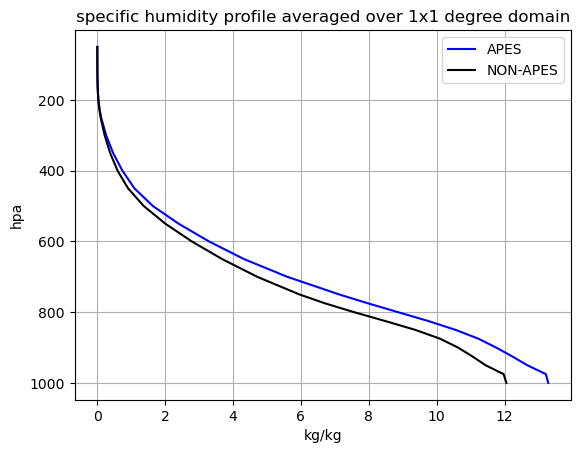

In [40]:
qapes = qsound[qsound['APE']==True]

qnonapes = qsound[qsound['APE']==False]

qapes_mean = qapes.groupby('plev')['mean_q'].mean()

qnonapes_mean = qnonapes.groupby('plev')['mean_q'].mean()

plt.plot(qapes_mean.values, qapes_mean.index, color='blue', label='APES')

plt.plot(qnonapes_mean.values, qnonapes_mean.index, color='black', label='NON-APES')

plt.gca().invert_yaxis()

plt.xlabel('kg/kg')

plt.ylabel('hpa')

plt.legend()

plt.grid()

plt.title('specific humidity profile averaged over 1x1 degree domain')

plt.show()

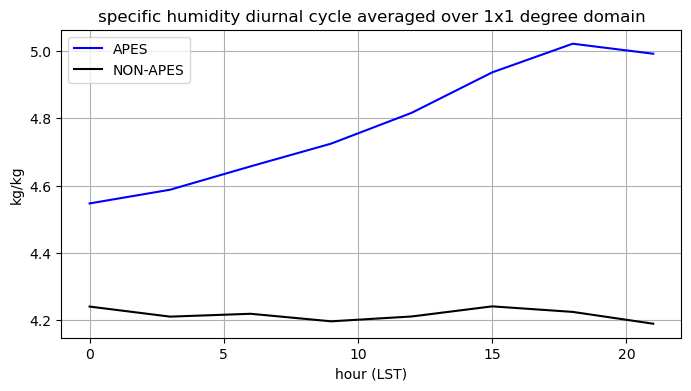

In [41]:
qapes_lt = qapes[(qapes['plev']<800) & (qapes['plev']>600)]

qnonapes_lt = qnonapes[(qnonapes['plev']<800) & (qnonapes['plev']>600)]

qapeslt_mean = qapes.groupby('hour')['mean_q'].mean()

qnonapeslt_mean = qnonapes.groupby('hour')['mean_q'].mean()

plt.figure(figsize=(8, 4))

plt.plot(qapeslt_mean.index, qapeslt_mean.values, color='blue', label='APES')

plt.plot(qnonapeslt_mean.index, qnonapeslt_mean.values, color='black', label='NON-APES')

plt.xlabel('hour (LST)')

plt.ylabel('kg/kg')

plt.legend()

plt.grid()

plt.title('specific humidity diurnal cycle averaged over 1x1 degree domain')

plt.show()

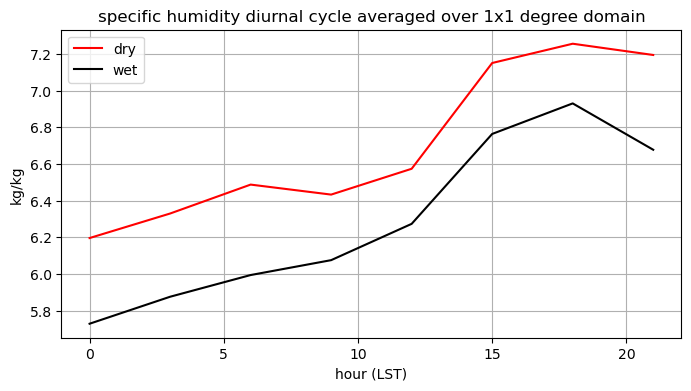

In [42]:
qdryapes = qapes_lt[qapes_lt['dry_coupling']==True]

qwetapes = qapes_lt[qapes_lt['wet_coupling']==True]

qdryapesmean = qdryapes.groupby('hour')['mean_q'].mean()

qwetapesmean = qwetapes.groupby('hour')['mean_q'].mean()

plt.figure(figsize=(8, 4))

plt.plot(qdryapesmean.index, qdryapesmean.values, color='red', label='dry')

plt.plot(qwetapesmean.index, qwetapesmean.values, color='black', label='wet')

plt.xlabel('hour (LST)')

plt.ylabel('kg/kg')

plt.legend()

plt.grid()

plt.title('specific humidity diurnal cycle averaged over 1x1 degree domain')

plt.show()

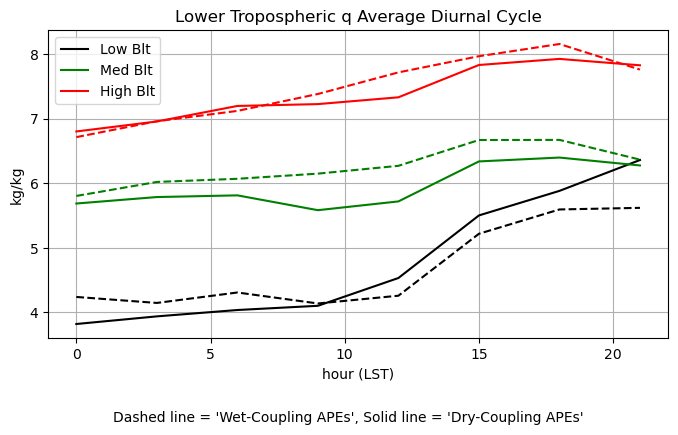

In [60]:
plt.figure(figsize=(8, 4))

for terc in [1,2,3]:
    
    if terc == 1:
        
        color = 'black'
        
        label = 'Low Blt'
    
    elif terc == 2:
        
        color = 'green'
        
        label = 'Med Blt'
        
    elif terc == 3: 
        
        color = 'red'
        
        label = 'High Blt'
        
    qwetapes = qapes_lt[(qapes_lt['wet_coupling']==True) & (qapes_lt['tercile']==terc)]

    qdryapes = qapes_lt[(qapes_lt['dry_coupling']==True) & (qapes_lt['tercile']==terc)]

    qdryapesmean = qdryapes.groupby('hour')['mean_q'].mean()
    
    qwetapesmean = qwetapes.groupby('hour')['mean_q'].mean()

    plt.plot(qdryapesmean.index, qdryapesmean.values, color=color, label=label)
    
    plt.plot(qwetapesmean.index, qwetapesmean.values, color=color, linestyle='--')
    
plt.xlabel('hour (LST)')

plt.ylabel('kg/kg')

plt.legend()

plt.grid()

caption = "Dashed line = 'Wet-Coupling APEs', Solid line = 'Dry-Coupling APEs'"

plt.figtext(0.5, -0.1, caption, ha='center', fontsize=10)

plt.title('Lower Tropospheric q Average Diurnal Cycle')

plt.show()

## MFC figures

In [20]:
divdf = pd.DataFrame(convergence, columns=['time','wq_lt','uq_lt','vq_lt','wq_surf','uq_surf','vq_surf'])

divdf.set_index('time', inplace=True)

divdf['hr'] = divdf.index.hour

divdf.index = divdf.index.date

In [21]:
divpdf = divdf.join(soundings, how='inner')

divpdf["net_lt"] = divpdf["wq_lt"] + divpdf["uq_lt"] + divpdf["vq_lt"]

divpdf["net_surf"] = divpdf["wq_surf"] + divpdf["uq_surf"] + divpdf["vq_surf"]

apes = divpdf[divpdf['APE']==True]

nonapes = divpdf[divpdf['APE']==False]

dryapes = apes[apes['dry_coupling']==True]

wetapes = apes[apes['wet_coupling']==True]

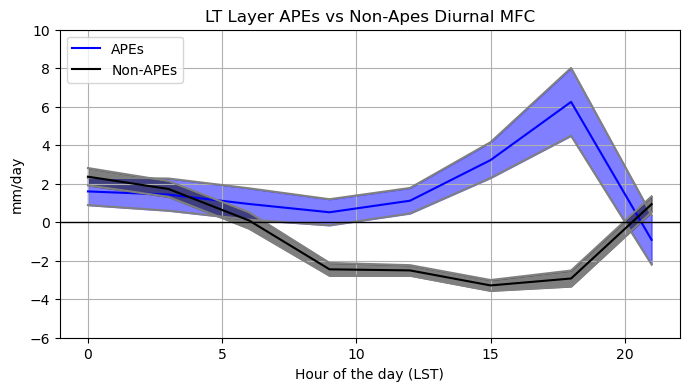

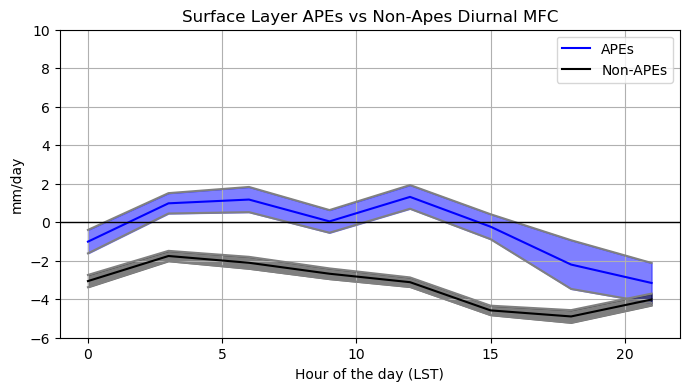

In [22]:
layers = ["_lt", "_surf"]

for layer in layers: 

    groupedapes = apes.groupby('hr')[f"net{layer}"].agg(['mean', 'std', 'count'])
    
    groupednonapes = nonapes.groupby('hr')[f"net{layer}"].agg(['mean', 'std', 'count'])
    
    groupedapes['se'] = groupedapes['std']/np.sqrt(groupedapes['count'])
    
    groupednonapes['se'] = groupednonapes['std']/np.sqrt(groupednonapes['count'])
    
    plt.figure(figsize=(8, 4))

    #plotting apes 
    plt.plot(groupedapes.index, groupedapes["mean"], label='APEs', color='blue')
    
    plt.plot(groupedapes.index, groupedapes["mean"]-groupedapes["se"], color='grey')

    plt.plot(groupedapes.index, groupedapes["mean"]+groupedapes["se"], color='grey')
    
    plt.fill_between(groupedapes.index, groupedapes["mean"]-groupedapes["se"], groupedapes["mean"]+groupedapes["se"], color='blue', alpha=0.5)
    
    #plotting non-apes
    plt.plot(groupednonapes.index, groupednonapes["mean"], label='Non-APEs', color='black')
    
    plt.plot(groupednonapes.index, groupednonapes["mean"]-groupednonapes["se"], color='grey')

    plt.plot(groupednonapes.index, groupednonapes["mean"]+groupednonapes["se"], color='grey')
    
    plt.fill_between(groupednonapes.index, groupednonapes["mean"]-groupednonapes["se"], groupednonapes["mean"]+groupednonapes["se"], color='black', alpha=0.5)
    
    plt.legend()
    
    if layer == "_lt":
        
        title = "LT Layer"
        
    elif layer == "_surf":
        
        title = "Surface Layer"

    plt.title("{} APEs vs Non-Apes Diurnal MFC".format(title))

    plt.ylabel("mm/day")

    plt.xlabel("Hour of the day (LST)")
    
    plt.axhline(y=0, color='black', linewidth=1)

    plt.ylim(-6, 10)

    plt.grid()

    plt.show()


Observations: MFC in LT layer more important for producing APEs than surface layer

- overall more MFC between LT (800-600hpa) than surface (1000-800) layers for APEs
- net divergence in afternoon for LT layer for non-apes, net divergence all day for surface layer non-apes

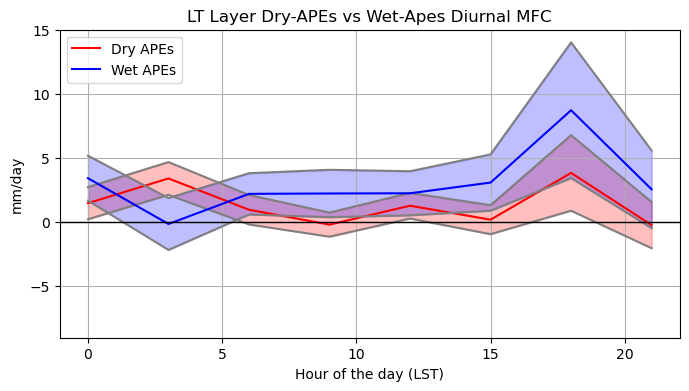

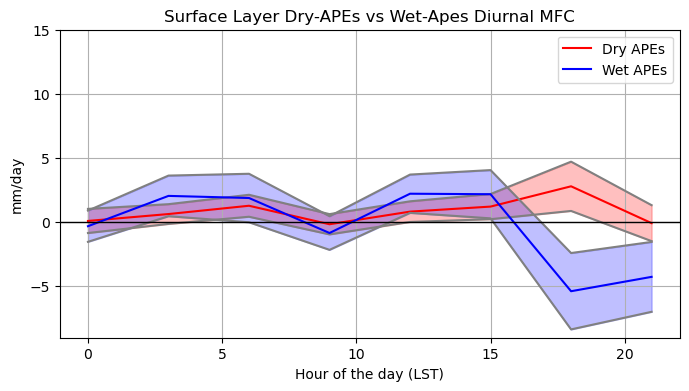

In [23]:
layers = ["_lt", "_surf"]

for layer in layers: 
    
    grouped_dry_apes = dryapes.groupby('hr')[f"net{layer}"].agg(['mean', 'std', 'count'])

    grouped_wet_apes = wetapes.groupby('hr')[f"net{layer}"].agg(['mean', 'std', 'count'])

    grouped_dry_apes['se'] = grouped_dry_apes['std']/np.sqrt(grouped_dry_apes['count'])

    grouped_wet_apes['se'] = grouped_wet_apes['std']/np.sqrt(grouped_wet_apes['count'])

    plt.figure(figsize=(8, 4))

    #plotting dry apes
    plt.plot(grouped_dry_apes.index, grouped_dry_apes["mean"], label='Dry APEs', color='red')

    plt.plot(grouped_dry_apes.index, grouped_dry_apes["mean"]-grouped_dry_apes["se"], color='grey')

    plt.plot(grouped_dry_apes.index, grouped_dry_apes["mean"]+grouped_dry_apes["se"], color='grey')

    plt.fill_between(grouped_dry_apes.index, grouped_dry_apes["mean"]-grouped_dry_apes["se"], grouped_dry_apes["mean"]+grouped_dry_apes["se"], color='red', alpha=0.25)

    #plotting wet apes 
    plt.plot(grouped_wet_apes.index, grouped_wet_apes["mean"], label='Wet APEs', color='blue')

    plt.plot(grouped_wet_apes.index, grouped_wet_apes["mean"]-grouped_wet_apes["se"], color='grey')

    plt.plot(grouped_wet_apes.index, grouped_wet_apes["mean"]+grouped_wet_apes["se"], color='grey')

    plt.fill_between(grouped_wet_apes.index, grouped_wet_apes["mean"]-grouped_wet_apes["se"], grouped_wet_apes["mean"]+grouped_wet_apes["se"], color='blue', alpha=0.25)

    if layer == "_lt":
        
        title = "LT Layer"
        
    elif layer == "_surf":
        
        title = "Surface Layer"

    plt.title("{} Dry-APEs vs Wet-Apes Diurnal MFC".format(title))

    plt.ylabel("mm/day")

    plt.xlabel("Hour of the day (LST)")
    
    plt.axhline(y=0, color='black', linewidth=1)
    
    plt.ylim(-9, 15)

    plt.legend()

    plt.grid()

    plt.show()

Observations: in afternoon, the LT MFC (rather than surface MFC) becomes more important for wet apes than dry apes since surface layer is net divergent for wet apes in afternoon 

- large uncertainty
- slightly more MFC for wet apes in LT than dry apes 
- in surface layer, slight convergence for wet apes until afternoon, then divergence for rest of day
- in surface layer, divergence for dry apes until afternoon, then slight convergence

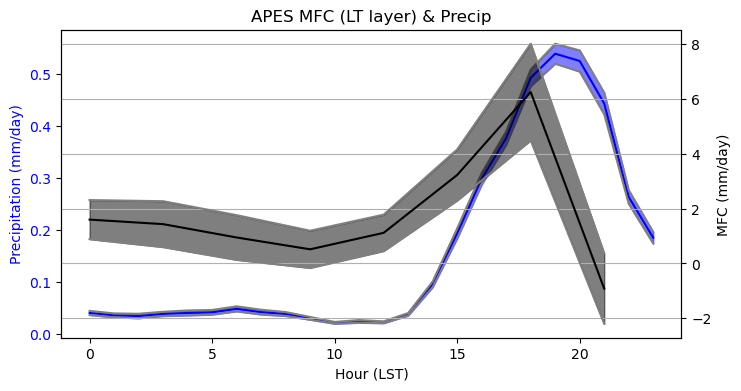

In [24]:
diurn_precip = list(apes['all_hours'])

mean_diurn_precip = np.mean(diurn_precip, axis=0)

se_diurn_precip = np.std(diurn_precip, axis=0)/np.sqrt(len(diurn_precip))

fig, ax1 = plt.subplots(figsize=(8, 4))

ax1.plot(range(0, 24), mean_diurn_precip, color='blue', label='precip')

ax1.plot(range(0, 24), mean_diurn_precip+se_diurn_precip, color='grey')

ax1.plot(range(0, 24), mean_diurn_precip-se_diurn_precip, color='grey')

plt.fill_between(range(0, 24), mean_diurn_precip-se_diurn_precip, mean_diurn_precip+se_diurn_precip, color='blue',alpha=0.5)

ax1.set_xlabel('Hour (LST)')

ax1.set_ylabel('Precipitation (mm/day)', color='blue')

ax1.tick_params(axis='y', labelcolor='blue')

ax2 = ax1.twinx()

grouped_apes_lt = apes.groupby('hr')["net_lt"].agg(['mean', 'std', 'count'])

grouped_apes_lt['se'] = grouped_apes_lt['std']/np.sqrt(grouped_apes_lt['count'])
 
ax2.plot(grouped_apes_lt.index, grouped_apes_lt['mean'], color='black', label='MFC')

ax2.plot(grouped_apes_lt.index, grouped_apes_lt['mean']+grouped_apes_lt['se'], color='grey')

ax2.plot(grouped_apes_lt.index, grouped_apes_lt['mean']-grouped_apes_lt['se'], color='grey')

plt.fill_between(grouped_apes_lt.index, grouped_apes_lt['mean']+grouped_apes_lt['se'], grouped_apes_lt['mean']-grouped_apes_lt['se'], color='black', alpha=0.5)

ax2.set_ylabel('MFC (mm/day)', color='black')

ax2.tick_params(axis='y', labelcolor='black')

plt.grid()

plt.title("APES MFC (LT layer) & Precip")

plt.show()

Observations: 

- on average, precipitation peaks an hour or two after MFC peak

- on average, precipitation begins to increase while moisture is becoming maximum divergent -- how?

- in the morning, there seems to be not enough MFC to produce precipitation

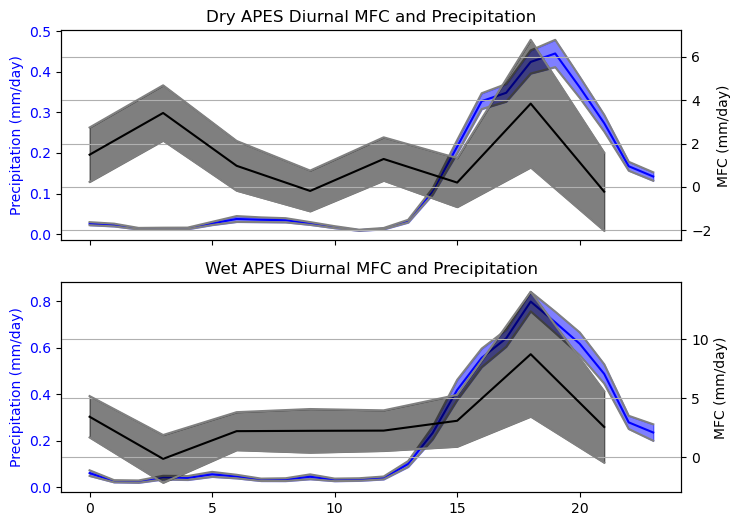

In [25]:
dry_diurn_precip = list(dryapes['all_hours'])

wet_diurn_precip = list(wetapes['all_hours'])

dry_mean_diurn_precip = np.mean(dry_diurn_precip, axis=0)

se_dry_diurn_precip = np.std(dry_diurn_precip, axis=0)/np.sqrt(len(dry_diurn_precip))

wet_mean_diurn_precip = np.mean(wet_diurn_precip, axis=0)

se_wet_diurn_precip = np.std(wet_diurn_precip, axis=0)/np.sqrt(len(wet_diurn_precip))

grouped_wet_apes_lt = pd.DataFrame(wetapes.groupby('hr')["net_lt"].agg(['mean', 'std', 'count']))

grouped_dry_apes_lt = pd.DataFrame(dryapes.groupby('hr')["net_lt"].agg(['mean', 'std', 'count']))

grouped_dry_apes_lt['se'] = grouped_dry_apes_lt['std']/np.sqrt(grouped_dry_apes_lt['count'])

grouped_wet_apes_lt['se'] = grouped_wet_apes_lt['std']/np.sqrt(grouped_wet_apes_lt['count'])

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 6), sharex=True)

#plotting dry apes
ax1.plot(range(0, 24), dry_mean_diurn_precip, color='blue', label='Dry APEs precip')
                                   
ax1.plot(range(0, 24), dry_mean_diurn_precip+se_dry_diurn_precip, color='grey')

ax1.plot(range(0, 24), dry_mean_diurn_precip-se_dry_diurn_precip, color='grey')

ax1.fill_between(range(0, 24),dry_mean_diurn_precip-se_dry_diurn_precip,dry_mean_diurn_precip+se_dry_diurn_precip, color='blue', alpha=0.5)

ax1.set_ylabel('Precipitation (mm/day)', color='blue')

ax1.tick_params(axis='y', labelcolor='blue')

ax1_2 = ax1.twinx()

ax1_2.plot(grouped_dry_apes_lt.index, grouped_dry_apes_lt['mean'], color='black', label='Dry apes mfc')

ax1_2.plot(grouped_dry_apes_lt.index, grouped_dry_apes_lt['mean']+grouped_dry_apes_lt['se'], color='grey')

ax1_2.plot(grouped_dry_apes_lt.index, grouped_dry_apes_lt['mean']-grouped_dry_apes_lt['se'], color='grey')

ax1_2.fill_between(grouped_dry_apes_lt.index, grouped_dry_apes_lt['mean']+grouped_dry_apes_lt['se'],grouped_dry_apes_lt['mean']-grouped_dry_apes_lt['se'], color='black', alpha=0.5)

ax1_2.set_ylabel('MFC (mm/day)', color='black')

ax1_2.tick_params(axis='y', labelcolor='black')

plt.grid()

plt.title("Dry APES Diurnal MFC and Precipitation")

# Plotting for wet apes
ax2.plot(range(0, 24), wet_mean_diurn_precip, color='blue', label='wet APEs precip')
                                   
ax2.plot(range(0, 24), wet_mean_diurn_precip+se_wet_diurn_precip, color='grey')

ax2.plot(range(0, 24), wet_mean_diurn_precip-se_wet_diurn_precip, color='grey')

ax2.fill_between(range(0, 24),wet_mean_diurn_precip-se_wet_diurn_precip,wet_mean_diurn_precip+se_wet_diurn_precip, color='blue', alpha=0.5)

ax2.set_ylabel('Precipitation (mm/day)', color='blue')

ax2.tick_params(axis='y', labelcolor='blue')

ax2_2 = ax2.twinx()

ax2_2.plot(grouped_wet_apes_lt.index, grouped_wet_apes_lt['mean'], color='black', label='wet apes mfc')

ax2_2.plot(grouped_wet_apes_lt.index, grouped_wet_apes_lt['mean']+grouped_wet_apes_lt['se'], color='grey')

ax2_2.plot(grouped_wet_apes_lt.index, grouped_wet_apes_lt['mean']-grouped_wet_apes_lt['se'], color='grey')

ax2_2.fill_between(grouped_wet_apes_lt.index, grouped_wet_apes_lt['mean']+grouped_wet_apes_lt['se'],grouped_wet_apes_lt['mean']-grouped_wet_apes_lt['se'], color='black', alpha=0.5)

ax2_2.set_ylabel('MFC (mm/day)', color='black')

ax2_2.tick_params(axis='y', labelcolor='black')

plt.grid()

plt.title("Wet APES Diurnal MFC and Precipitation")

plt.show()

Obvservations:

- wet apes MFC and precip peak at same time, while dry-apes precip lags MFC peak

- both dry & wet APES MFC for LT layer in phase with precipitation

- both dry & wet apes MFC for LT layer has a peak early in day, but not enough to produce precipitation 

In [1960]:
# custom_boundaries = [divpdf['blt'].min(), 
#                      divpdf['blt'].quantile(1/10), 
#                      divpdf['blt'].quantile(2/10),
#                      divpdf['blt'].quantile(3/10),
#                      divpdf['blt'].quantile(4/10),
#                      divpdf['blt'].quantile(5/10),
#                      divpdf['blt'].quantile(6/10),
#                      divpdf['blt'].quantile(7/10),
#                      divpdf['blt'].quantile(8/10),
#                      divpdf['blt'].quantile(9/10),
#                      divpdf['blt'].max()]

# divpdf['blt_percentile'] = pd.cut(divpdf['blt'], bins=custom_boundaries, labels=[.05, .15, .25, .35, .45, .55, .65, .75, .85, .95], include_lowest=True)

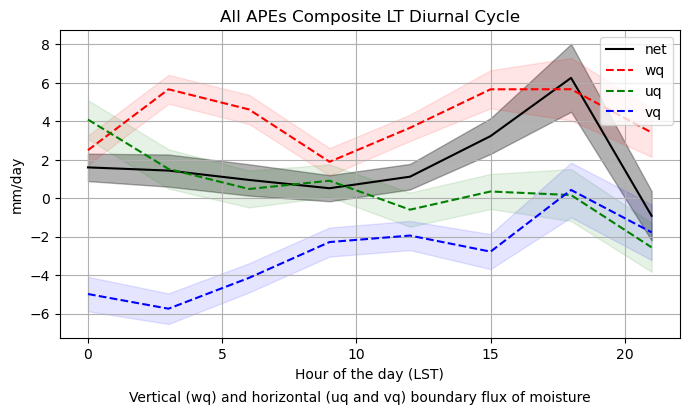

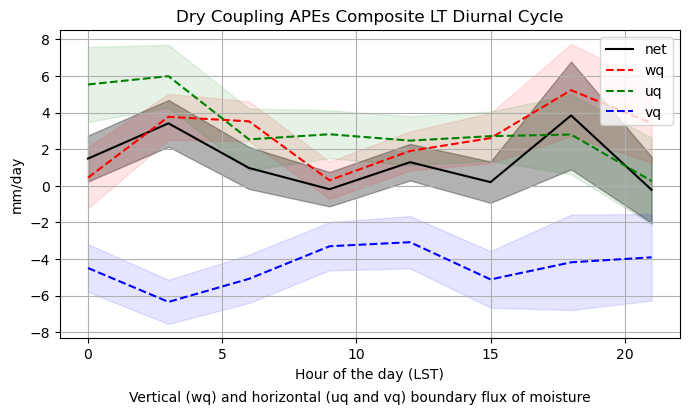

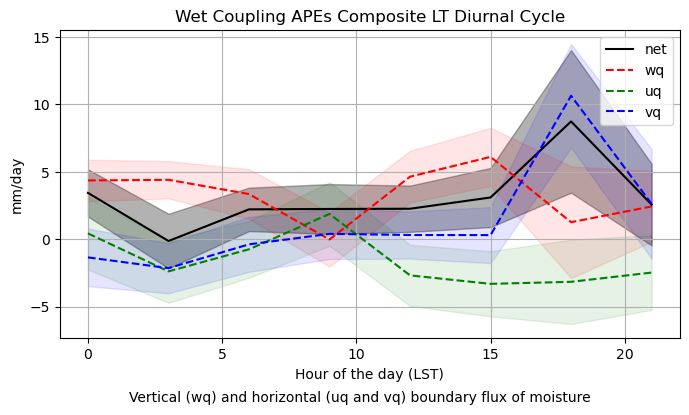

In [75]:
dfs = [apes, dryapes, wetapes]

variables = ['wq_lt', 'uq_lt', 'vq_lt']

count = 0

for df in dfs:
    
    plt.figure(figsize=(8, 4))
    
    grouped_net = pd.DataFrame(df.groupby('hr')['net_lt'].agg(['mean', 'std', 'count']))

    grouped_net['se'] = grouped_net['std'] / np.sqrt(grouped_net['count'])

    plt.plot(grouped_net.index, grouped_net['mean'], label="net", color='black')

    plt.fill_between(grouped_net.index, grouped_net['mean'] + grouped_net['se'], grouped_net['mean'] - grouped_net['se'], color='black', alpha=0.3)

    for var in variables:

        if var == 'wq_lt':
            
            label='wq'

            color = 'red'

        elif var == 'vq_lt':
            
            label='vq'

            color = 'blue'

        elif var == 'uq_lt':
            
            label='uq'

            color = 'green'
            
        if count == 0:
            
            title = 'All APEs'
            
        elif count == 1:
            
            title = 'Dry Coupling APEs'
            
        elif count == 2:
            
            title = 'Wet Coupling APEs'


        grouped_var = pd.DataFrame(df.groupby('hr')[var].agg(['mean', 'std', 'count']))

        grouped_var['se'] = grouped_var['std'] / np.sqrt(grouped_var['count'])

        plt.plot(grouped_var.index, grouped_var['mean'], label=label, color=color, linestyle='--')

        plt.fill_between(grouped_var.index, grouped_var['mean'] + grouped_var['se'], grouped_var['mean'] - grouped_var['se'], color=color, alpha=0.1)

    plt.legend(loc='upper right')
    
    plt.title("{} Composite LT Diurnal Cycle".format(title))
    
    plt.ylabel("mm/day")
    
    plt.xlabel("Hour of the day (LST)")
    
    plt.figtext(0.5, -0.05, "Vertical (wq) and horizontal (uq and vq) boundary flux of moisture", ha='center', fontsize=10)
    
    plt.grid()
    
    plt.show()
    
    count +=1 

observations: sources of LT humidity based on MFC

these figures suggest that dry apes do NOT require meridional moisture transport for precipitation, rather it is zonal & vertical transport that are more important. in contrast, wet apes require meridional transport. and vertical transport important for both dry & wet  

- for all apes, wq & uq are the largest contributers, while vq is net divergent

- for dry apes, uq most important, wq next, and vq still net divergent

- for wet apes, vq and wq most important, while uq much less important

- in conclusion, these figures suggest that wet apes actually require more meridional transport than dry apes, while zonal transport descends in importance

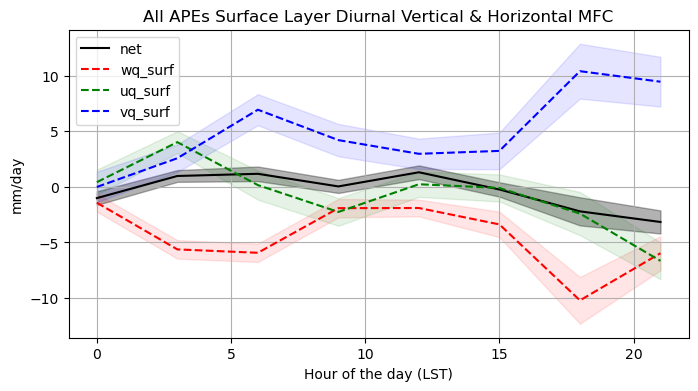

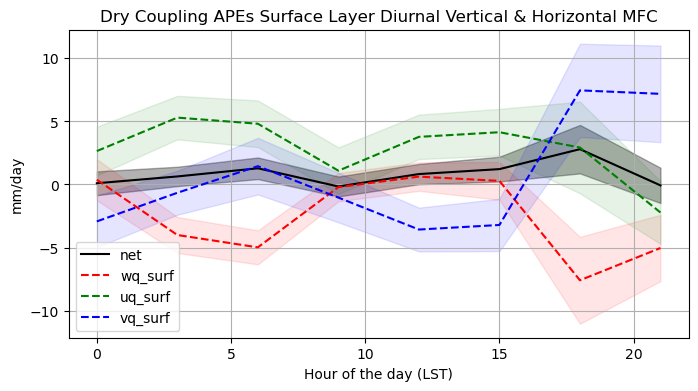

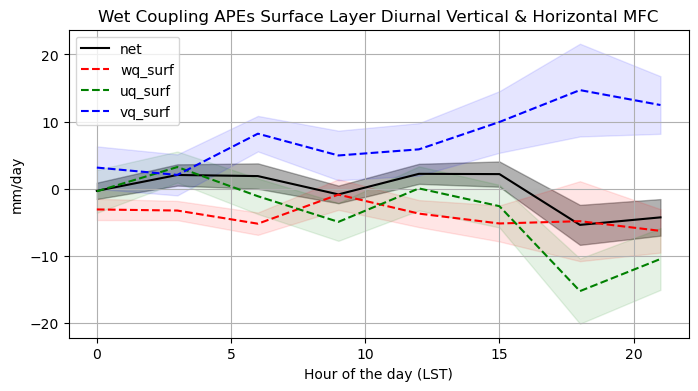

In [27]:
dfs = [apes, dryapes, wetapes]

variables = ['wq_surf', 'uq_surf', 'vq_surf']

count = 0

for df in dfs:
    
    plt.figure(figsize=(8, 4))
    
    grouped_net = pd.DataFrame(df.groupby('hr')['net_surf'].agg(['mean', 'std', 'count']))

    grouped_net['se'] = grouped_net['std'] / np.sqrt(grouped_net['count'])

    plt.plot(grouped_net.index, grouped_net['mean'], label="net", color='black')

    plt.fill_between(grouped_net.index, grouped_net['mean'] + grouped_net['se'], grouped_net['mean'] - grouped_net['se'], color='black', alpha=0.3)

    for var in variables:

        if var == 'wq_surf':

            color = 'red'

        elif var == 'vq_surf':

            color = 'blue'

        elif var == 'uq_surf':

            color = 'green'
            
        if count == 0:
            
            title = 'All APEs'
            
        elif count == 1:
            
            title = 'Dry Coupling APEs'
            
        elif count == 2:
            
            title = 'Wet Coupling APEs'


        grouped_var = pd.DataFrame(df.groupby('hr')[var].agg(['mean', 'std', 'count']))

        grouped_var['se'] = grouped_var['std'] / np.sqrt(grouped_var['count'])

        plt.plot(grouped_var.index, grouped_var['mean'], label=var, color=color, linestyle='--')

        plt.fill_between(grouped_var.index, grouped_var['mean'] + grouped_var['se'], grouped_var['mean'] - grouped_var['se'], color=color, alpha=0.1)

    plt.legend()
    plt.title("{} Surface Layer Diurnal Vertical & Horizontal MFC".format(title))
    plt.ylabel("mm/day")
    plt.xlabel("Hour of the day (LST)")
    plt.grid()
    plt.show()
    
    count +=1 

observations: dry coupling APEs meridional transport turning point occurs just before start of ape rainfall time period

- wet coupling APEs have high meridional transport in surface layer as well as lt layer

- for all apes, wq divergence seems to cancel out vq convergence

- vq seems to trend upwards around 15 LST (around beginning of APEs) for all, wet and dry cases

questions:

- is turning point significant of when convergence begins to happen?

- could the meridional transport in the surface layer still have an influence on precip even if the terms result in cancellation? 


In [1318]:
#LT comparison

# daily = divdf.groupby(divdf.index)

# mean_daily = pd.DataFrame(daily.mean())

# net_daily = mean_daily[['wq','uq','vq']]

# net_daily['net'] = net_daily['wq'] + net_daily['uq'] + net_daily['vq']

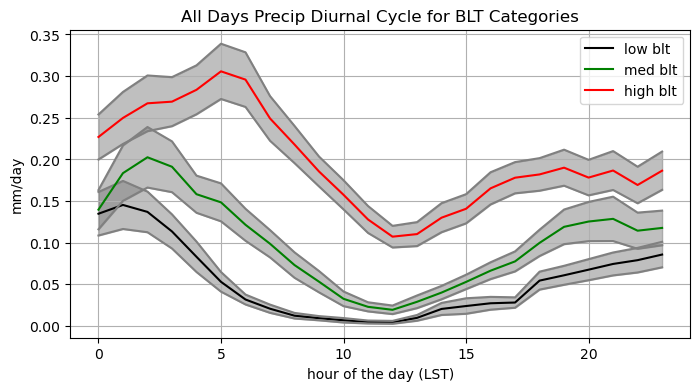

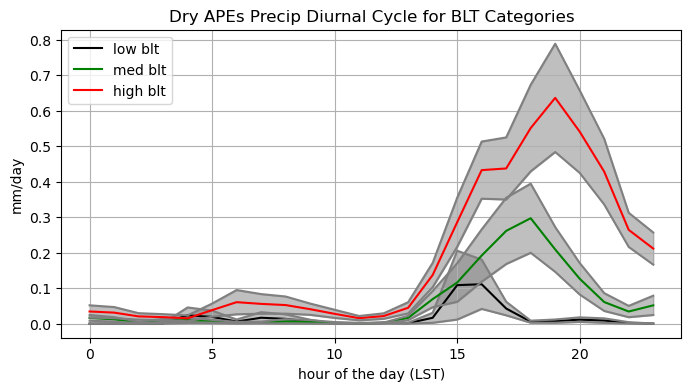

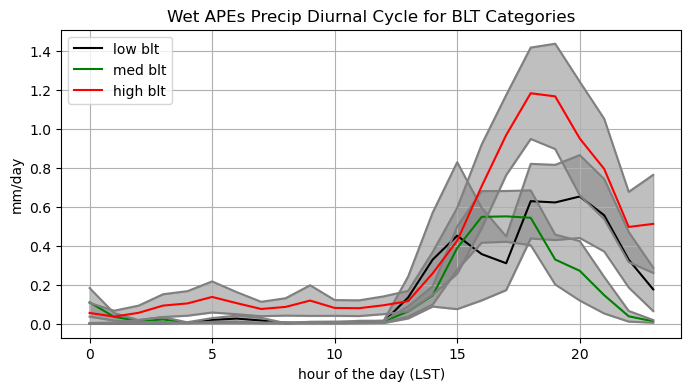

In [36]:
#plotting diurnal precipitation cycle for the three BLT terciles 

bigcount = 0

for bigdf in [divpdf, dryapes, wetapes]: 
    
    if bigcount == 0:
        
        title = 'All Days'
    
    elif bigcount == 1:
        
        title = 'Dry APEs'
    
    elif bigcount == 2:
        
        title = 'Wet APEs'

    lowLT = bigdf[bigdf['tercile']==1]

    medLT = bigdf[bigdf['tercile']==2]

    highLT = bigdf[bigdf['tercile']==3]

    count = 1

    plt.figure(figsize=(8, 4))

    for df in [lowLT, medLT, highLT]: 

        df = df[~df.index.duplicated(keep='first')]

        if count == 1:

            label = "low blt"

            color = 'black'

        elif count == 2:

            label = "med blt"

            color = 'green'

        elif count == 3:

            label = "high blt"

            color = 'red'

        diurn_precip = list(df['all_hours'])

        mean_diurn_precip = np.nanmean(diurn_precip, axis=0)

        se_precip = np.nanstd(diurn_precip, axis=0)/np.sqrt(len(diurn_precip))

    #     grouped = pd.DataFrame(df.groupby('hr')['net_lt'].agg(['mean','std','count']))

    #     grouped['se'] = grouped['std']/np.sqrt(grouped['count'])

        plt.plot(range(0,24), mean_diurn_precip, color=color, label=label)

        plt.plot(range(0,24), mean_diurn_precip+se_precip, color='grey')

        plt.plot(range(0,24), mean_diurn_precip-se_precip, color='grey')

        plt.fill_between(range(0,24), mean_diurn_precip+se_precip, mean_diurn_precip-se_precip, color='grey', alpha=0.5)

        count+=1

    plt.title("{} Precip Diurnal Cycle for BLT Categories".format(title))

    plt.xlabel("hour of the day (LST)")

    plt.ylabel("mm/day")

    plt.legend()

    plt.grid()

    plt.show()
    
    bigcount+=1
    
    



In [ ]:
#plotting diurnal precipitation cycle for the three BLT terciles 

lowLT = divpdf[divpdf['tercile']==1]

medLT = divpdf[divpdf['tercile']==2]

highLT = divpdf[divpdf['tercile']==3]

count = 1

plt.figure(figsize=(8, 4))

for df in [lowLT, medLT, highLT]: 
    
    df = df[~df.index.duplicated(keep='first')]

    if count == 1:

        label = "low blt"

        color = 'black'

    elif count == 2:

        label = "med blt"

        color = 'green'

    elif count == 3:

        label = "high blt"

        color = 'red'
        
    diurn_precip = list(df['all_hours'])

    mean_diurn_precip = np.nanmean(diurn_precip, axis=0)
    
    se_precip = np.nanstd(diurn_precip, axis=0)/np.sqrt(len(diurn_precip))

#     grouped = pd.DataFrame(df.groupby('hr')['net_lt'].agg(['mean','std','count']))

#     grouped['se'] = grouped['std']/np.sqrt(grouped['count'])

    plt.plot(range(0,24), mean_diurn_precip, color=color, label=label)

    plt.plot(range(0,24), mean_diurn_precip+se_precip, color='grey')

    plt.plot(range(0,24), mean_diurn_precip-se_precip, color='grey')

    plt.fill_between(range(0,24), mean_diurn_precip+se_precip, mean_diurn_precip-se_precip, color='grey', alpha=0.5)

    count+=1

plt.title("Precip Diurnal Cycle for BLT Categories")

plt.xlabel("hour of the day (LST)")

plt.ylabel("mm/day")

plt.legend()

plt.grid()

plt.show()



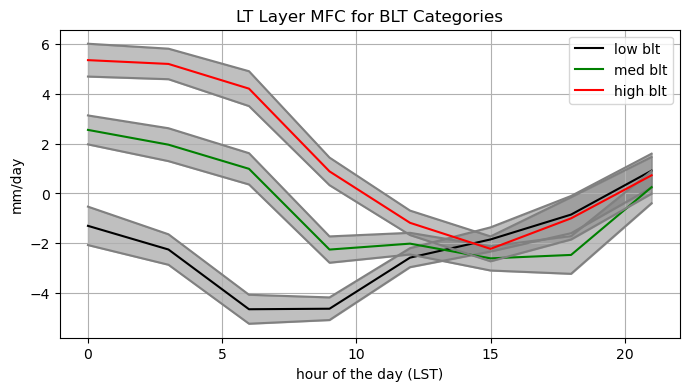

In [29]:
#LT comparison

lowLT = divpdf[divpdf['tercile']==1]

medLT = divpdf[divpdf['tercile']==2]

highLT = divpdf[divpdf['tercile']==3]

count = 1

plt.figure(figsize=(8, 4))

for df in [lowLT, medLT, highLT]:   

    if count == 1:

        label = "low blt"

        color = 'black'

    elif count == 2:

        label = "med blt"

        color = 'green'

    elif count == 3:

        label = "high blt"

        color = 'red'

    grouped = pd.DataFrame(df.groupby('hr')['net_lt'].agg(['mean','std','count']))

    grouped['se'] = grouped['std']/np.sqrt(grouped['count'])

    plt.plot(grouped.index, grouped['mean'], color=color, label=label)

    plt.plot(grouped.index, grouped['mean']+grouped['se'], color='grey')

    plt.plot(grouped.index, grouped['mean']-grouped['se'], color='grey')

    plt.fill_between(grouped.index, grouped['mean']+grouped['se'], grouped['mean']-grouped['se'], color='grey', alpha=0.5)

    count+=1

plt.title("LT Layer MFC for BLT Categories")

plt.xlabel("hour of the day (LST)")

plt.ylabel("mm/day")

plt.legend()

plt.grid()

plt.show()

Observations:

- suggests that blt values for early afternoon are established during midnight hours, and decay after that
- for high buoyancy case, decreases faster than other cases 
- largest dispersion in midnight hours
- smallest dispersion around beginning of afternoon hours
- turning point in afternoon for all cases, at 15LST when precip starts

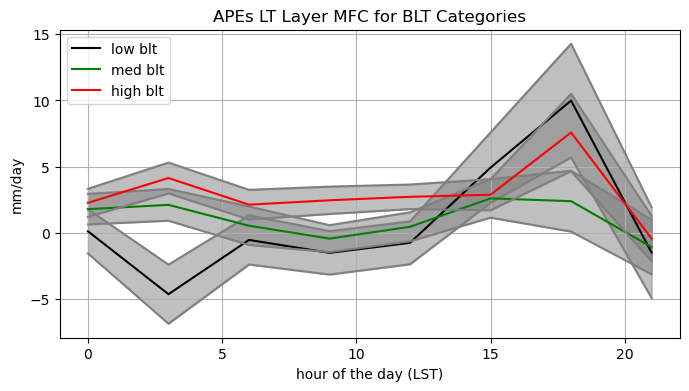

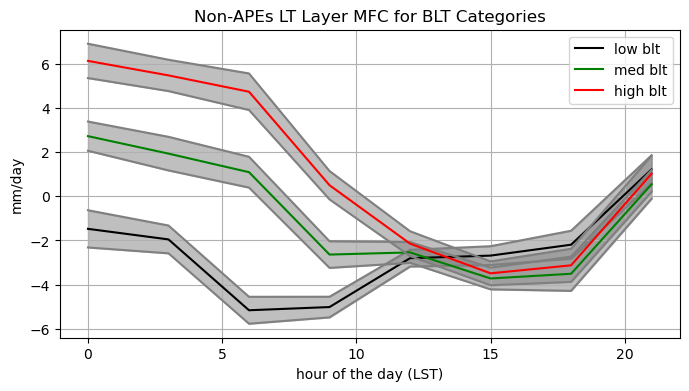

In [30]:
#LT comparison

for truth_value in [True, False]:
    
    plt.figure(figsize=(8, 4))

    lowLT = divpdf[(divpdf['tercile']==1) & (divpdf['APE']==truth_value)]

    medLT = divpdf[(divpdf['tercile']==2) & (divpdf['APE']==truth_value)]

    highLT = divpdf[(divpdf['tercile']==3) & (divpdf['APE']==truth_value)]

    count = 1

    for df in [lowLT, medLT, highLT]:

        if count == 1:

            label = "low blt"

            color = 'black'

        elif count == 2:

            label = "med blt"

            color = 'green'

        elif count == 3:

            label = "high blt"

            color = 'red'

        grouped = pd.DataFrame(df.groupby('hr')['net_lt'].agg(['mean','std','count']))

        grouped['se'] = grouped['std']/np.sqrt(grouped['count'])

        plt.plot(grouped.index, grouped['mean'], color=color, label=label)

        plt.plot(grouped.index, grouped['mean']+grouped['se'], color='grey')

        plt.plot(grouped.index, grouped['mean']-grouped['se'], color='grey')

        plt.fill_between(grouped.index, grouped['mean']+grouped['se'], grouped['mean']-grouped['se'], color='grey', alpha=0.5)

        count+=1

    if truth_value == True:
        
        title = 'APEs'
        
    elif truth_value == False:
        
        title = 'Non-APEs'
        
    plt.title("{} LT Layer MFC for BLT Categories".format(title))

    plt.xlabel("hour of the day (LST)")

    plt.ylabel("mm/day")

    plt.legend()

    plt.grid()

    plt.show()

observations:

the apes figure suggests that early morning MFC may have an equal importance for producing APEs, especially for dry-coupling APEs which require high BLT amounts to produce required precipitation

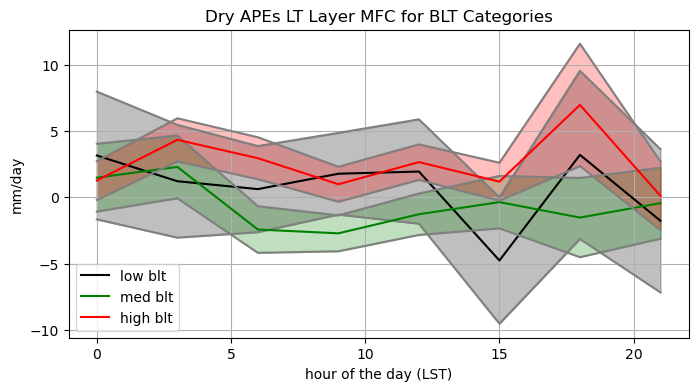

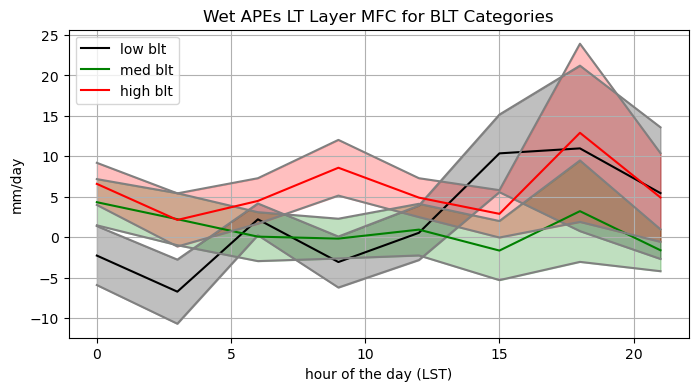

In [31]:
#LT comparison

count2 = 0

for df in [dryapes, wetapes]:
    
    plt.figure(figsize=(8, 4))

    lowLT = df[df['tercile']==1]

    medLT = df[df['tercile']==2]

    highLT = df[df['tercile']==3]
    
    count = 1

    for df_blt in [lowLT, medLT, highLT]:

        if count == 1:

            label = "low blt"

            color = 'black'

        elif count == 2:

            label = "med blt"

            color = 'green'

        elif count == 3:

            label = "high blt"

            color = 'red'

        grouped = pd.DataFrame(df_blt.groupby('hr')['net_lt'].agg(['mean','std','count']))

        grouped['se'] = grouped['std']/np.sqrt(grouped['count'])

        plt.plot(grouped.index, grouped['mean'], color=color, label=label)

        plt.plot(grouped.index, grouped['mean']+grouped['se'], color='grey')

        plt.plot(grouped.index, grouped['mean']-grouped['se'], color='grey')

        plt.fill_between(grouped.index, grouped['mean']+grouped['se'], grouped['mean']-grouped['se'], color=color, alpha=0.25)

        count+=1

    if count2 == 0:
        
        title = 'Dry APEs'
        
    elif count2 == 1:
        
        title = 'Wet APEs'
        
    plt.title("{} LT Layer MFC for BLT Categories".format(title))

    plt.xlabel("hour of the day (LST)")

    plt.ylabel("mm/day")

    plt.legend()

    plt.grid()

    plt.show()
    
    count2+=1